In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
sns.set(style='whitegrid')
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings("ignore")

In [6]:
merged_df=pd.read_csv(r"processed data\all_data_combined.csv")

In [7]:
merged_df.columns

Index(['Current_Date', 'Location', 'LATITUDE', 'LONGITUDE', 'ELEVATION',
       'Sea Proximity (approximate-km)', 'Sea Proximity Categorised',
       'Climate Zone', 'Area(km^2)', 'Population', 'Population_density', 'new',
       'total', 'Lockdown', 'carbonmonoxide_average',
       'nitrogendioxide_average', 'ozone_average', 'PRCP', 'TAVG', 'TMAX',
       'TMIN', 'HCHO_reading'],
      dtype='object')

In [8]:
merged_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12782 entries, 0 to 12781
Data columns (total 22 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Current_Date                    12782 non-null  object 
 1   Location                        12782 non-null  object 
 2   LATITUDE                        12782 non-null  float64
 3   LONGITUDE                       12782 non-null  float64
 4   ELEVATION                       12782 non-null  float64
 5   Sea Proximity (approximate-km)  12782 non-null  int64  
 6   Sea Proximity Categorised       12782 non-null  object 
 7   Climate Zone                    12782 non-null  object 
 8   Area(km^2)                      12782 non-null  float64
 9   Population                      12782 non-null  int64  
 10  Population_density              12782 non-null  float64
 11  new                             12782 non-null  float64
 12  total                           

In [9]:
try:
    # Convert 'Current_Date' to DateTime format
    merged_df['Current_Date'] = pd.to_datetime(merged_df['Current_Date'])
    print("Conversion to DateTime format successful.")
except ValueError as e:
    print(f"Error converting to DateTime format: {e}")

Conversion to DateTime format successful.


## Comparison of yearly mean HCHO readings of cities
The plot displays annual mean formaldehyde (HCHO) readings for multiple cities over time. Each line represents a city, showing its HCHO levels across years. It allows comparison between cities, identification of trends, anomalies, and long-term patterns in air quality.

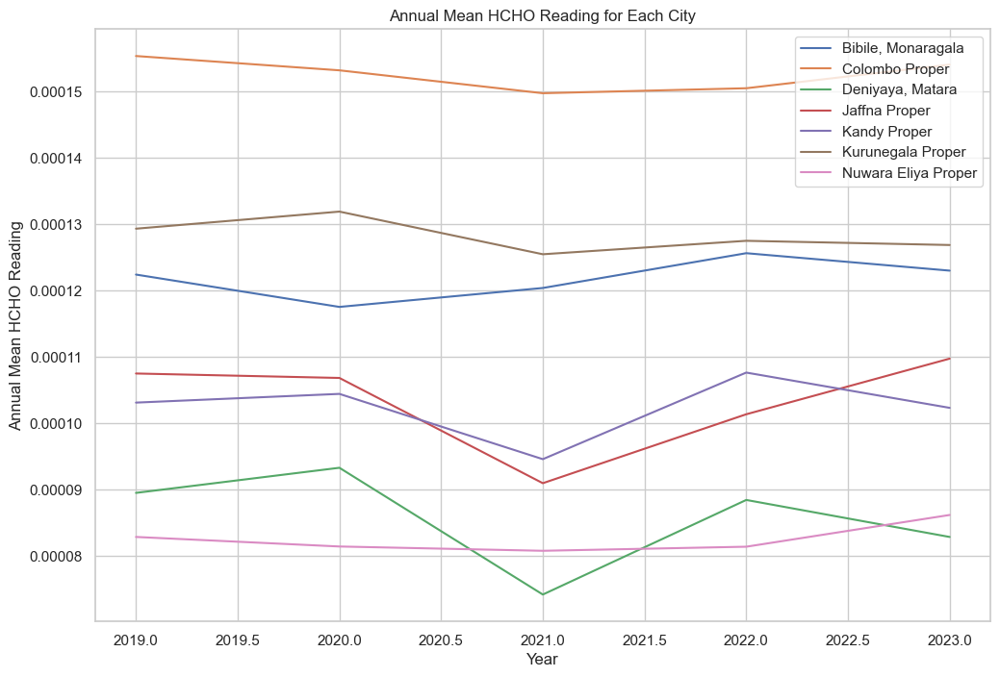

In [10]:
# Calculate annual mean HCHO reading for each city without creating a new column for year
annual_mean_hcho = merged_df.groupby([merged_df['Current_Date'].dt.year, 'Location'])['HCHO_reading'].mean().unstack(level=1)

# Plotting the line plot
plt.figure(figsize=(12, 8))
for city in annual_mean_hcho.columns:
    plt.plot(annual_mean_hcho.index, annual_mean_hcho[city], label=city)

# Add labels and title
plt.xlabel('Year')
plt.ylabel('Annual Mean HCHO Reading')
plt.title('Annual Mean HCHO Reading for Each City')
plt.legend()

# Show plot
plt.grid(True)
plt.show()


# Relationship between the mean formaldehyde (HCHO) readings and various city attributes `(ELEVATION, Sea Proximity and Population desity)`

Mean HCHO_Reading vs Mean ELEVATION for each city


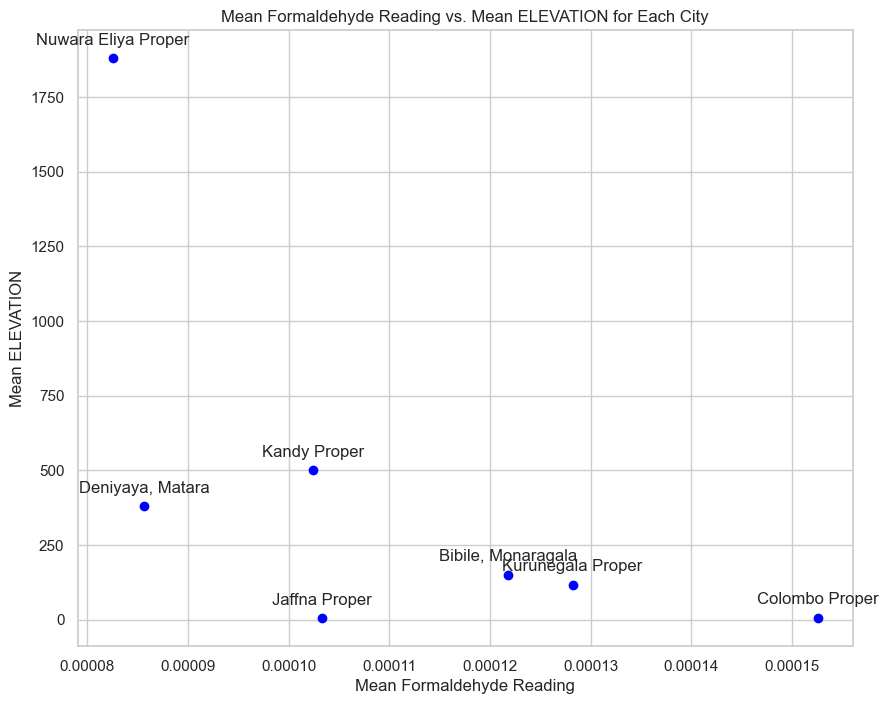

Correlation between mean HCHO readings and ELEVATION: -0.6378411172798543

Mean HCHO_Reading vs Mean Sea Proximity (approximate-km) for each city


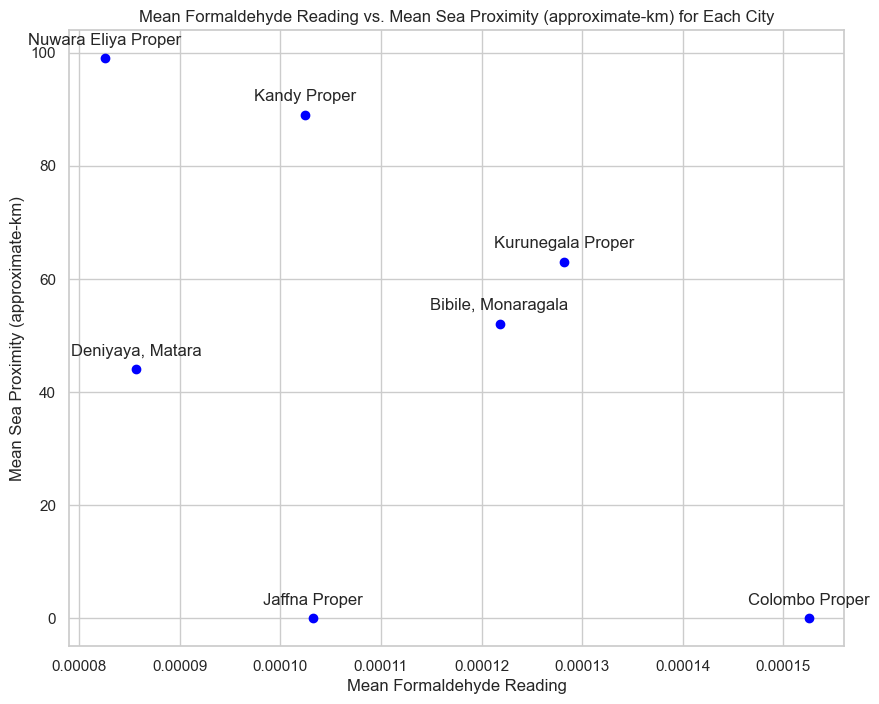

Correlation between mean HCHO readings and Sea Proximity (approximate-km): -0.5186167802375364

Mean HCHO_Reading vs Mean Population_density for each city


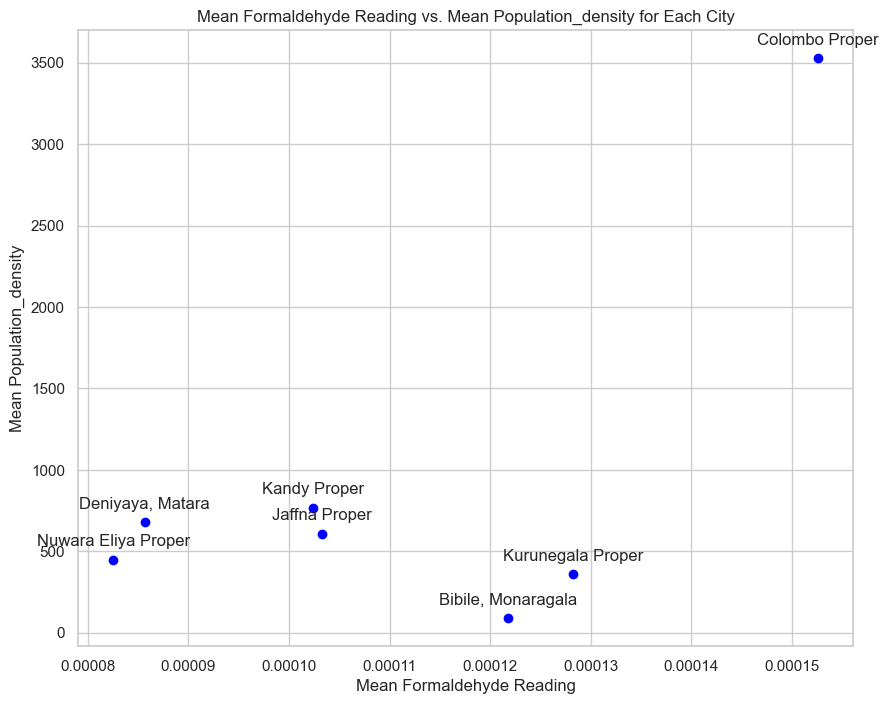

Correlation between mean HCHO readings and Population_density: 0.6468497541603153



In [12]:
# Define columns of interest
columns_of_interest = ['ELEVATION', 'Sea Proximity (approximate-km)','Population_density']

for column in columns_of_interest:
    print(f"Mean HCHO_Reading vs Mean {column} for each city")

    # Calculate mean HCHO reading and the current column for each city
    mean_hcho = merged_df.groupby('Location')['HCHO_reading'].mean()
    mean_column = merged_df.groupby('Location')[column].mean()

    # Create scatter plot
    plt.figure(figsize=(10, 8))
    plt.scatter(mean_hcho, mean_column, color='blue')

    # Add annotations for each city
    for i, city in enumerate(mean_hcho.index):
        plt.annotate(city, (mean_hcho[i], mean_column[i]), textcoords="offset points", xytext=(0,10), ha='center')

    # Add labels and title
    plt.xlabel('Mean Formaldehyde Reading')
    plt.ylabel(f'Mean {column}')
    plt.title(f'Mean Formaldehyde Reading vs. Mean {column} for Each City')

    # Show plot
    plt.grid(True)
    plt.show()

    # Calculate correlation between mean HCHO readings and the current column
    correlation = np.corrcoef(mean_hcho, mean_column)[0, 1]
    print(f"Correlation between mean HCHO readings and {column}: {correlation}\n")



1. **Elevation**
   
   - **Correlation:** The correlation coefficient of approximately -0.64 indicates a moderate to strong negative correlation between mean HCHO readings and elevation. As elevation increases, mean HCHO readings tend to decrease.
   - **Interpretation:** Cities located at higher elevations, such as Nuwara Eliya Proper (1880 meters), exhibit lower mean HCHO readings compared to cities at lower elevations like Colombo Proper (7 meters) and Jaffna Proper (5 meters).
   
2. **Sea Proximity**
   
   - **Correlation:** The correlation coefficient of approximately -0.52 suggests a moderate negative correlation between mean HCHO readings and sea proximity. As the distance from the sea increases, mean HCHO readings tend to rise.
   - **Interpretation:** Cities with closer sea proximity, like Colombo Proper (0 km) and Jaffna Proper (0 km), tend to have higher mean HCHO readings compared to cities farther from the sea, such as Nuwara Eliya Proper (99 km).
   
3. **Population Density**
   
   - **Correlation:** The correlation coefficient of approximately 0.65 indicates a moderate to strong positive correlation between mean HCHO readings and population density. Higher population density is associated with higher mean HCHO readings.
   - **Interpretation:** Cities with higher population densities, such as Colombo Proper (3526.83 people/km²) and Kandy Proper (767.31 people/km²), tend to have higher mean HCHO readings. Conversely, cities with lower population densities like Kurunegala Proper (359.52 people/km²) exhibit lower mean HCHO readings.

**Summary**
In summary, the city attributes—elevation, sea proximity, and population density—reveal notable correlations with mean formaldehyde (HCHO) readings, offering insights into urban air quality dynamics:

- **Elevation:** Higher elevation cities tend to exhibit lower HCHO levels, indicating a negative correlation.
- **Sea Proximity:** Cities closer to the sea generally have higher HCHO levels, reflecting a negative correlation.
- **Population Density:** Higher population density correlates positively with increased HCHO levels, highlighting urban activity's impact on pollution.

Overall, these correlations underscore the complex interplay between urban characteristics and air quality. Understanding how city attributes influence pollutant levels is crucial for effective environmental management and public health initiatives aimed at mitigating air pollution and improving overall urban liveability.


# Relationship between formaldehyde (HCHO) readings and various environmental factors (weather and effects of anthropogenic activities)

Connection between HCHO_reading and TAVG for Each City


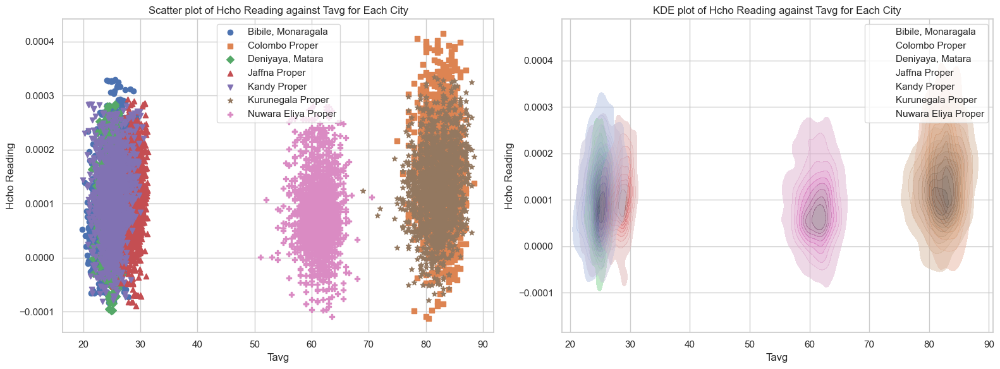


Correlation between HCHO_reading and TAVG for Each City:
Bibile, Monaragala: 0.3372295431029538
Colombo Proper: -0.060205091249854285
Deniyaya, Matara: 0.0505045213725406
Jaffna Proper: 0.2380125283503767
Kandy Proper: 0.13182157953763363
Kurunegala Proper: 0.16228161966806248
Nuwara Eliya Proper: 0.009741125684240935

Correlation between HCHO_reading and TAVG for Each City:
ELEVATION: -0.3732139902986905
Sea Proximity (approximate-km): -0.013060008639682222
Population_density: -0.6702214654584585
Connection between HCHO_reading and PRCP for Each City


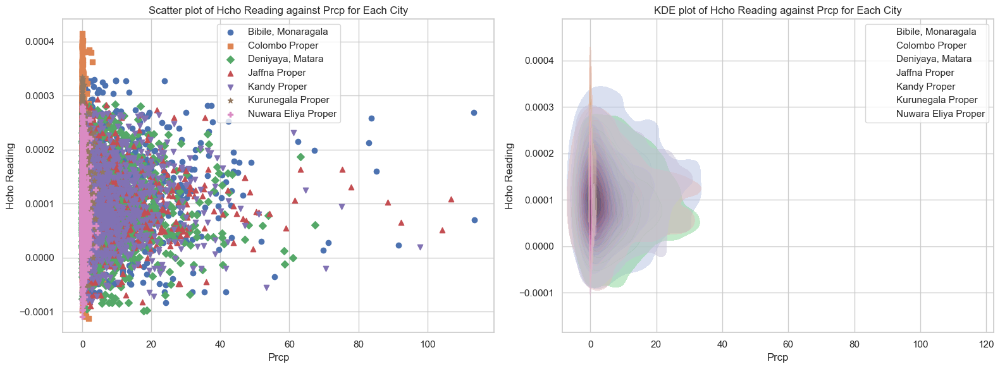


Correlation between HCHO_reading and PRCP for Each City:
Bibile, Monaragala: -0.01925527765296984
Colombo Proper: -0.08055654544979529
Deniyaya, Matara: -0.021408293705607623
Jaffna Proper: -0.03355965683658126
Kandy Proper: -0.030484655792663285
Kurunegala Proper: -0.0380229965162381
Nuwara Eliya Proper: -0.042819691127610096

Correlation between HCHO_reading and PRCP for Each City:
ELEVATION: 0.04394063450387981
Sea Proximity (approximate-km): 0.39484854263471564
Population_density: -0.9064183096686298
Connection between HCHO_reading and carbonmonoxide_average for Each City


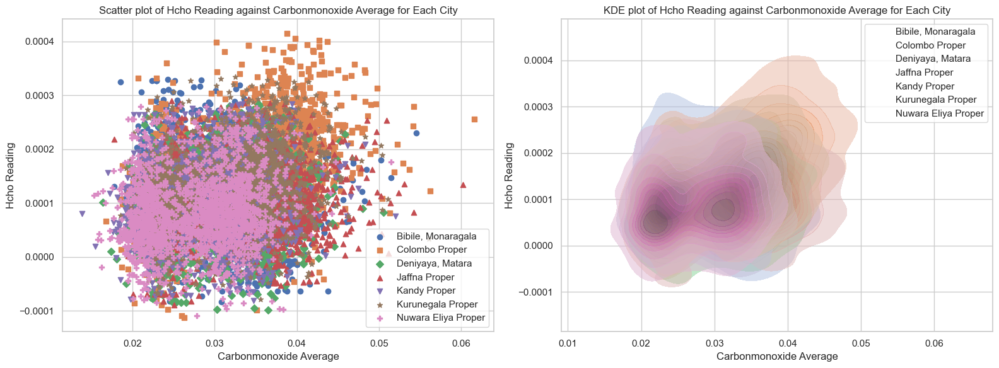


Correlation between HCHO_reading and carbonmonoxide_average for Each City:
Bibile, Monaragala: -0.2547802078409578
Colombo Proper: 0.5494987539892361
Deniyaya, Matara: 0.23325059494271905
Jaffna Proper: 0.029594646984790016
Kandy Proper: 0.16200612071207518
Kurunegala Proper: 0.31585133415798883
Nuwara Eliya Proper: 0.13630160873144104

Correlation between HCHO_reading and carbonmonoxide_average for Each City:
ELEVATION: -0.08144587495832242
Sea Proximity (approximate-km): -0.22793695079855633
Population_density: 0.7490581496221295
Connection between HCHO_reading and nitrogendioxide_average for Each City


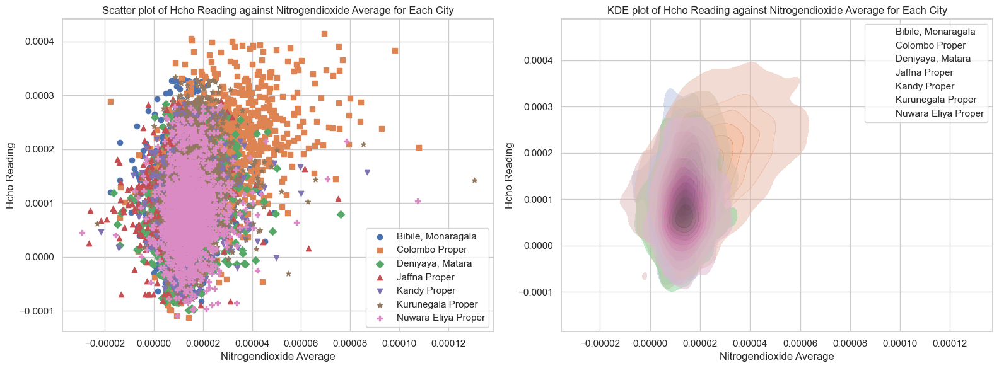


Correlation between HCHO_reading and nitrogendioxide_average for Each City:
Bibile, Monaragala: 0.12001358034267193
Colombo Proper: 0.5283587151139871
Deniyaya, Matara: 0.1594154681825039
Jaffna Proper: 0.11442518308462683
Kandy Proper: 0.11726505604248977
Kurunegala Proper: 0.17338922592099018
Nuwara Eliya Proper: 0.08373296768646923

Correlation between HCHO_reading and nitrogendioxide_average for Each City:
ELEVATION: -0.3966928056009707
Sea Proximity (approximate-km): -0.5919833105532565
Population_density: 0.9630376667288852
Connection between HCHO_reading and ozone_average for Each City


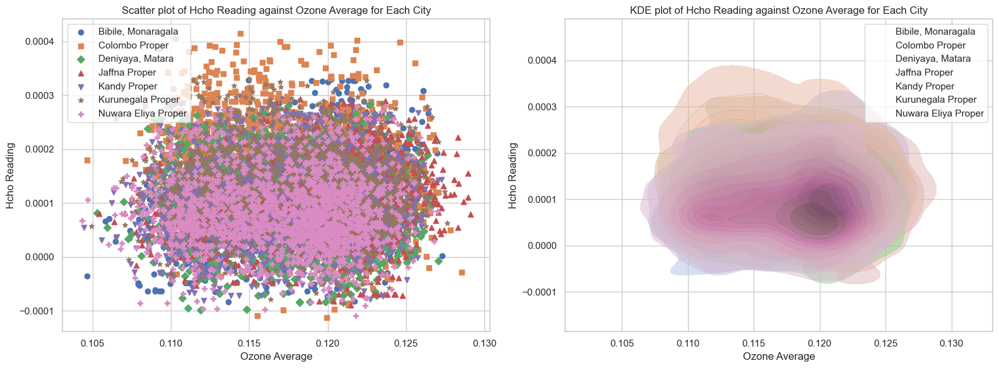


Correlation between HCHO_reading and ozone_average for Each City:
Bibile, Monaragala: 0.38845649191309295
Colombo Proper: -0.3792764104279857
Deniyaya, Matara: -0.12227962643012684
Jaffna Proper: 0.18238976252011668
Kandy Proper: 0.022921071182112496
Kurunegala Proper: -0.09974460576900963
Nuwara Eliya Proper: -0.018272261032732346

Correlation between HCHO_reading and ozone_average for Each City:
ELEVATION: -0.013243142783596834
Sea Proximity (approximate-km): 0.17678640479638058
Population_density: -0.7499003233686119


In [16]:
# Define column pairs
column_pairs = [
    ('TAVG', 'HCHO_reading'),
    ('PRCP', 'HCHO_reading'),
    ('carbonmonoxide_average', 'HCHO_reading'),
    ('nitrogendioxide_average', 'HCHO_reading'),
    ('ozone_average', 'HCHO_reading')
]

# Get unique cities in the dataset
cities = merged_df['Location'].unique()

# Define city attributes
city_attributes = ['ELEVATION', 'Sea Proximity (approximate-km)', 'Population_density']

# Calculate mean values of city attributes
city_attribute_means = {}
for column in city_attributes:
    mean_column = merged_df.groupby('Location')[column].mean()
    city_attribute_means[column] = mean_column

# Visualization, Correlation with Environmental Factor, Correlations with City Attributes
for x_column, y_column in column_pairs:
    
    print(f"Connection between {y_column} and {x_column} for Each City")
    # Visualization
    fig, axs = plt.subplots(1, 2, figsize=(16, 6))

    # Generate a list of markers for scatter plots
    markers = ['o', 's', 'D', '^', 'v', '*', 'P']

    for i, city in enumerate(cities):
        city_data = merged_df[merged_df['Location'] == city]
        axs[0].scatter(city_data[x_column], city_data[y_column], label=city, marker=markers[i])

    axs[0].set_xlabel(x_column.replace('_', ' ').title())
    axs[0].set_ylabel(y_column.replace('_', ' ').title())
    axs[0].set_title(f'Scatter plot of {y_column.replace("_", " ").title()} against {x_column.replace("_", " ").title()} for Each City')
    axs[0].legend()
    axs[0].grid(True)

    for i, city in enumerate(cities):
        city_data = merged_df[merged_df['Location'] == city]
        sns.kdeplot(x=city_data[x_column], y=city_data[y_column], shade=True, alpha=0.5, label=city, ax=axs[1])

    axs[1].set_xlabel(x_column.replace('_', ' ').title())
    axs[1].set_ylabel(y_column.replace('_', ' ').title())
    axs[1].set_title(f'KDE plot of {y_column.replace("_", " ").title()} against {x_column.replace("_", " ").title()} for Each City')
    axs[1].legend(loc='upper right')
    axs[1].grid(True)

    plt.tight_layout()
    plt.show()

    # Correlation with Environmental Factor
    print(f"\nCorrelation between {y_column} and {x_column} for Each City:")
    correlation_with_env_factor = {}
    for city in cities:
        city_data = merged_df[merged_df['Location'] == city]
        correlation = city_data[[x_column, y_column]].corr().iloc[0, 1]  # Calculate correlation
        correlation_with_env_factor[city] = correlation
        print(f"{city}: {correlation}")

    # Correlations with City Attributes
    print(f"\nCorrelation between {y_column} and {x_column} for Each City:")
    for attribute in city_attributes:
        correlations = []
        for city in cities:
            correlation = correlation_with_env_factor[city]  # Get correlation with environmental factor
            city_attribute_value = city_attribute_means[attribute].loc[city]  # Get city attribute value
            correlations.append((correlation, city_attribute_value))
        # Calculate correlation between environmental factor correlations and city attribute
        correlation_matrix = pd.DataFrame(correlations, columns=['Correlation with Environmental Factor', attribute])
        correlation_with_city_attribute = correlation_matrix.corr().iloc[0, 1]
        print(f"{attribute}: {correlation_with_city_attribute}")
        
    print('='*117)


### 1 Temperature Average

**Correlation between HCHO_reading and TAVG for Each City:**
- The correlation values between formaldehyde (HCHO) readings and average temperature (TAVG) vary across different cities.
- The highest positive correlation is observed in Bibile, Monaragala (0.337), indicating a moderate positive relationship between formaldehyde readings and temperature.
- Colombo Proper shows a weak negative correlation (-0.060), suggesting a slight inverse relationship between formaldehyde readings and temperature.
- The rest of the cities show correlations ranging from very weak positive to weak positive.

**Correlations between "City Attributes" and "Correlation between HCHO_Reading and TAVG":**
- **Elevation:** There is a moderate negative correlation (-0.373) between the correlation of HCHO_reading with TAVG and the elevation of cities. This indicates that as the elevation increases, the correlation between formaldehyde readings and temperature tends to decrease.
- **Sea Proximity (approximate-km):** There is a very weak negative correlation (-0.013) between the correlation of HCHO_reading with TAVG and the proximity of cities to the sea. This suggests a negligible relationship between sea proximity and the correlation between formaldehyde readings and temperature.
- **Population Density:** There is a strong negative correlation (-0.670) between the correlation of HCHO_reading with TAVG and the population density of cities. This indicates that as population density increases, the correlation between formaldehyde readings and temperature tends to decrease significantly.

### 2 Precipitation

**Correlation between HCHO_reading and PRCP for Each City:**
- The correlation values between formaldehyde (HCHO) readings and precipitation (PRCP) across different cities are all negative, albeit very weak.
- This suggests a slight inverse relationship between formaldehyde readings and precipitation, indicating that higher levels of formaldehyde might be associated with lower precipitation levels, although the correlations are close to zero.

**Correlations between "City Attributes" and "Correlation between HCHO_Reading and PRCP":**
- **Elevation:** There is a very weak positive correlation (0.044) between the correlation of HCHO_reading with PRCP and the elevation of cities. This suggests a negligible relationship between elevation and the correlation between formaldehyde readings and precipitation.
- **Sea Proximity (approximate-km):** There is a moderate positive correlation (0.395) between the correlation of HCHO_reading with PRCP and the proximity of cities to the sea. This indicates that as cities are closer to the sea, the correlation between formaldehyde readings and precipitation tends to increase.
- **Population Density:** There is a strong negative correlation (-0.906) between the correlation of HCHO_reading with PRCP and the population density of cities. This indicates that as population density increases, the correlation between formaldehyde readings and precipitation tends to decrease significantly.

### 3 Carbonmonoxide Average

**Correlation between HCHO_reading and carbonmonoxide_average for Each City:**
- The correlation values between formaldehyde (HCHO) readings and average carbon monoxide levels (carbonmonoxide_average) across different cities vary.
- Bibile, Monaragala has a moderate negative correlation (-0.255), indicating a somewhat inverse relationship between formaldehyde readings and carbon monoxide levels.
- Colombo Proper exhibits a strong positive correlation (0.549), suggesting a significant positive relationship between formaldehyde readings and carbon monoxide levels.
- The rest of the cities show correlations ranging from very weak positive to moderate positive.

**Correlations between "City Attributes" and "Correlation between HCHO_Reading and carbonmonoxide_average":**
- **Elevation:** There is a very weak negative correlation (-0.081) between the correlation of HCHO_reading with carbonmonoxide_average and the elevation of cities. This indicates a negligible relationship between elevation and the correlation between formaldehyde readings and carbon monoxide levels.
- **Sea Proximity (approximate-km):** There is a moderate negative correlation (-0.228) between the correlation of HCHO_reading with carbonmonoxide_average and the proximity of cities to the sea. This suggests that as cities are closer to the sea, the correlation between formaldehyde readings and carbon monoxide levels tends to decrease.
- **Population Density:** There is a strong positive correlation (0.749) between the correlation of HCHO_reading with carbonmonoxide_average and the population density of cities. This indicates that as population density increases, the correlation between formaldehyde readings and carbon monoxide levels tends to increase significantly.

### 4 Nitrogendioxide

**Correlation between HCHO_reading and nitrogendioxide_average for Each City:**
- The correlation values between formaldehyde (HCHO) readings and average nitrogen dioxide levels (nitrogendioxide_average) across different cities vary.
- Colombo Proper exhibits the highest positive correlation (0.528), indicating a moderate positive relationship between formaldehyde readings and nitrogen dioxide levels.
- The correlations for the other cities range from very weak positive to moderate positive, with values between approximately 0.083 and 0.173.

**Correlations between "City Attributes" and "Correlation between HCHO_Reading and nitrogendioxide_average":**
- **Elevation:** There is a moderate negative correlation (-0.397) between the correlation of HCHO_reading with nitrogendioxide_average and the elevation of cities. This indicates that as the elevation increases, the correlation between formaldehyde readings and nitrogen dioxide levels tends to decrease.
- **Sea Proximity (approximate-km):** There is a strong negative correlation (-0.592) between the correlation of HCHO_reading with nitrogendioxide_average and the proximity of cities to the sea. This suggests that as cities are closer to the sea, the correlation between formaldehyde readings and nitrogen dioxide levels tends to decrease significantly.
- **Population Density:** There is a very strong positive correlation (0.963) between the correlation of HCHO_reading with nitrogendioxide_average and the population density of cities. This indicates that as population density increases, the correlation between formaldehyde readings and nitrogen dioxide levels tends to increase significantly.

### 5 Ozone

**Correlation between HCHO_reading and ozone_average for Each City:**
- The correlation values between formaldehyde (HCHO) readings and average ozone levels (ozone_average) across different cities vary.
- Bibile, Monaragala exhibits the highest positive correlation (0.388), indicating a moderate positive relationship between formaldehyde readings and ozone levels.
- Colombo Proper shows a strong negative correlation (-0.379), suggesting a significant inverse relationship between formaldehyde readings and ozone levels.
- The correlations for the other cities range from very weak negative to weak positive, with values between approximately -0.122 and 0.183.

**Correlations between "City Attributes" and "Correlation between HCHO_Reading and ozone_average":**
- **Elevation:** There is a very weak negative correlation (-0.013) between the correlation of HCHO_reading with ozone_average and the elevation of cities. This suggests a negligible relationship between elevation and the correlation between formaldehyde readings and ozone levels.
- **Sea Proximity (approximate-km):** There is a weak positive correlation (0.177) between the correlation of HCHO_reading with ozone_average and the proximity of cities to the sea. This indicates that as cities are closer to the sea, the correlation between formaldehyde readings and ozone levels tends to increase slightly.
- **Population Density:** There is a strong negative correlation (-0.750) between the correlation of HCHO_reading with ozone_average and the population density of cities. This indicates that as population density increases, the correlation between formaldehyde readings and ozone levels tends to decrease significantly.

These correlations provide insights into how the relationship between formaldehyde readings and various air pollutants varies across different cities and how it relates to city attributes such as elevation, sea proximity, and population density.


# Impact from Covid - Analysis

### Correlation between annual mean HCHO readings and annual mean 'new COVID cases' for each city

In [31]:
# Calculate annual mean HCHO reading for each
annual_mean_hcho = merged_df.groupby([merged_df['Current_Date'].dt.year, 'Location'])['HCHO_reading'].mean().unstack(level=1)

# Calculate annual mean 'new COVID cases' for each city
annual_mean_covid = merged_df.groupby([merged_df['Current_Date'].dt.year, 'Location'])['new'].mean().unstack(level=1)

# Calculate correlation between annual mean HCHO readings and annual mean 'new COVID cases' for each city
correlation = annual_mean_hcho.corrwith(annual_mean_covid)

# Print correlation
print("Correlation between Annual Mean HCHO Readings and Annual Mean New COVID Cases:")
print(correlation)


Correlation between Annual Mean HCHO Readings and Annual Mean New COVID Cases:
Location
Bibile, Monaragala    -0.222091
Colombo Proper        -0.764273
Deniyaya, Matara      -0.825466
Jaffna Proper         -0.959711
Kandy Proper          -0.834530
Kurunegala Proper     -0.604850
Nuwara Eliya Proper   -0.542305
dtype: float64


The output presents the correlation coefficients between the annual mean formaldehyde (HCHO) readings and the annual mean new COVID-19 cases for each city. Here's the interpretation:

- **Negative Correlation:** All correlation coefficients are negative, indicating an inverse relationship between annual mean HCHO readings and annual mean new COVID-19 cases in each city.

- **Strength of Correlation:** The correlation coefficients range from approximately -0.96 to -0.22. The closer the coefficient is to -1, the stronger the negative correlation. For instance, Jaffna Proper has the strongest negative correlation (-0.96), indicating a very strong inverse relationship between HCHO levels and new COVID-19 cases. On the other hand, Bibile, Monaragala has the weakest negative correlation (-0.22), suggesting a comparatively weaker inverse relationship.

- **City-Specific Insights:** The correlation coefficients provide insights into how changes in air quality, as measured by HCHO levels, relate to the incidence of new COVID-19 cases in each city. Cities with stronger negative correlations may indicate a more pronounced impact of air quality on COVID-19 transmission, while weaker correlations suggest other factors may be influencing disease spread to a greater extent.


### From the below plots, we can determine the following:

1. **Time Series Plot (Top):**
   - This plot shows the 3-month moving average of formaldehyde (HCHO) readings (blue line) and the daily new COVID-19 cases (red line) over time for each location.
   - It allows us to observe trends and potential correlations between HCHO levels and COVID-19 cases. For example, we can identify periods of simultaneous increases or decreases in both HCHO levels and COVID-19 cases, which may suggest a relationship between air quality and disease transmission.

2. **Heatmap (Bottom):**
   - The heatmap displays the monthly average HCHO readings (3-month moving average) for each year, allowing us to observe seasonal patterns and long-term trends in HCHO levels.
   - Each row represents a year, and each column represents a month. The color intensity represents the magnitude of HCHO levels, with darker shades indicating higher concentrations.
   - By examining changes in color intensity over time, we can identify any consistent patterns or anomalies in HCHO levels across different months and years.

Overall, these plots provide a comprehensive visualization of HCHO levels and COVID-19 cases over time for each location, facilitating the analysis of trends and potential correlations between air quality and disease spread.


Bibile, Monaragala


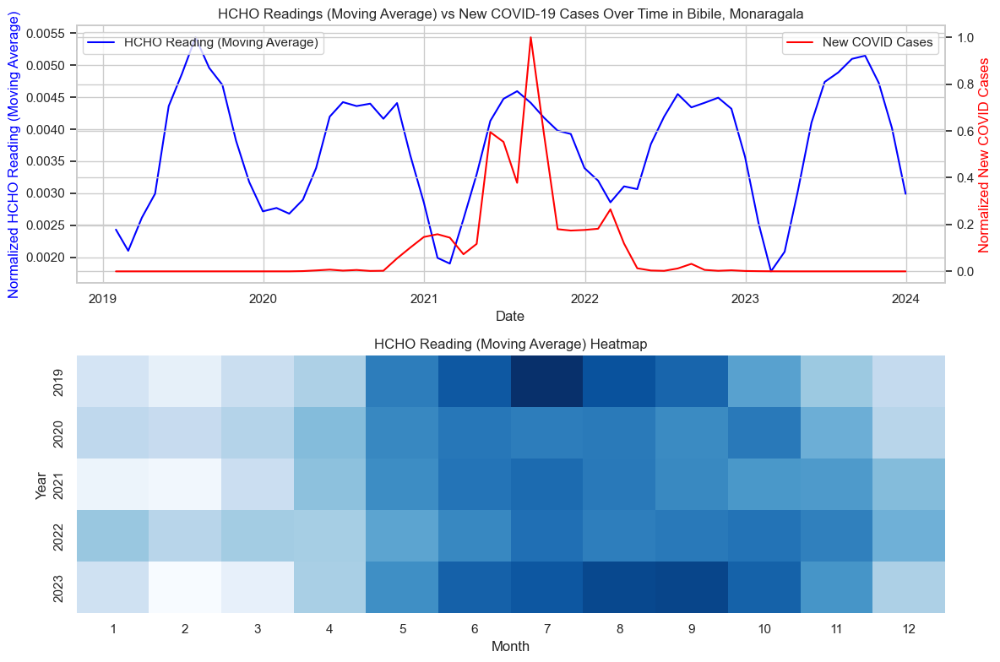

Colombo Proper


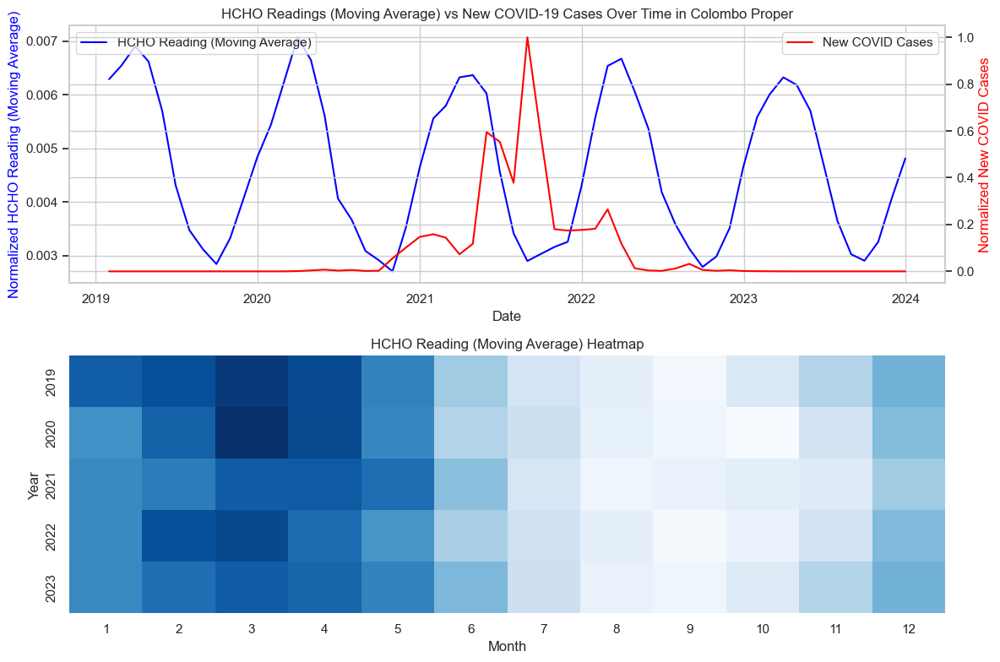

Deniyaya, Matara


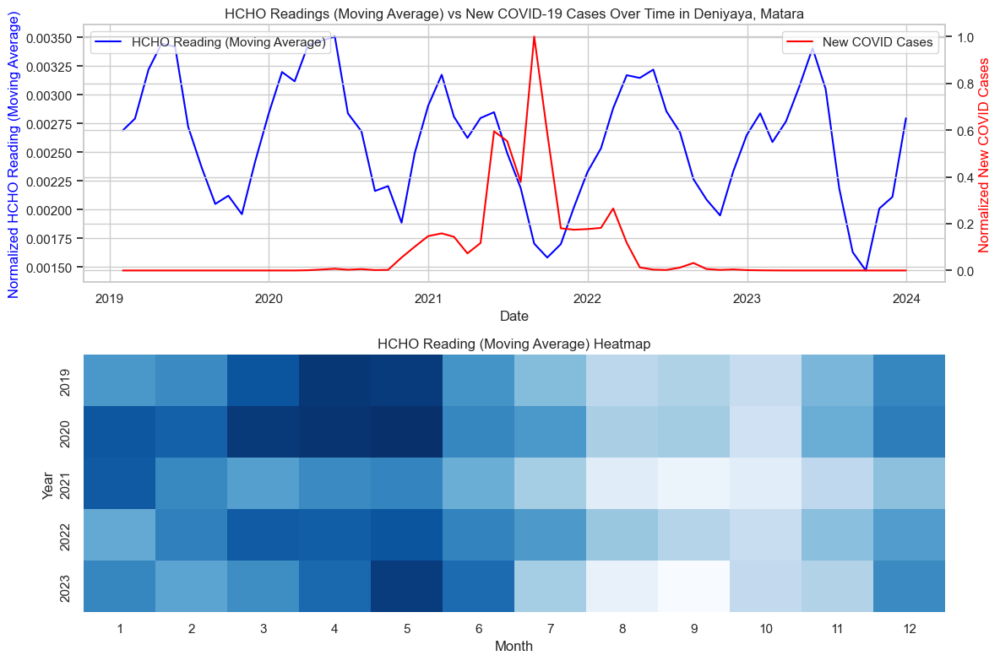

Jaffna Proper


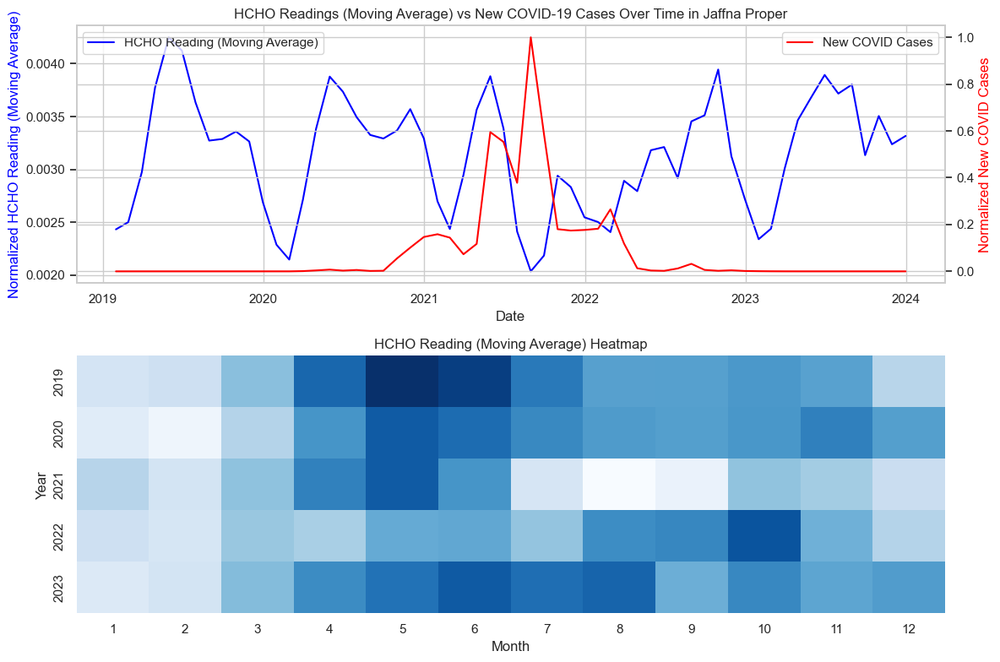

Kandy Proper


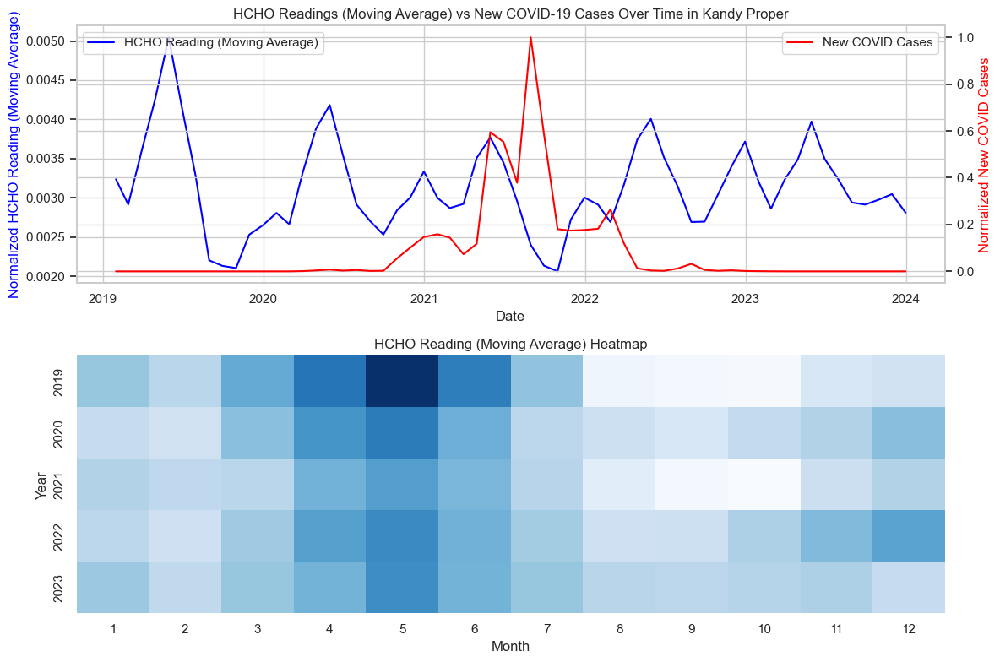

Kurunegala Proper


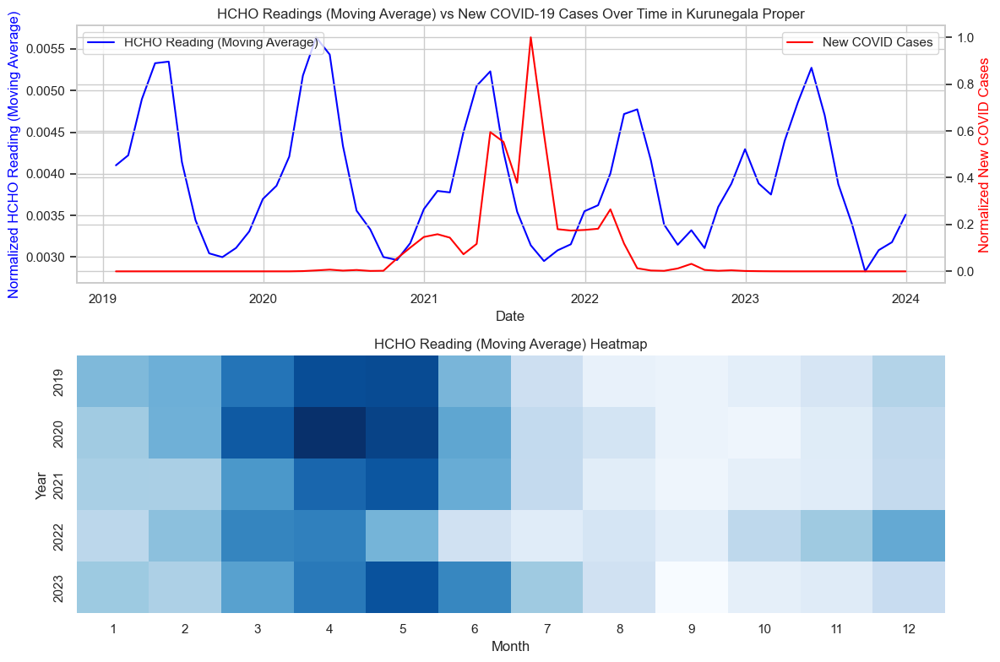

Nuwara Eliya Proper


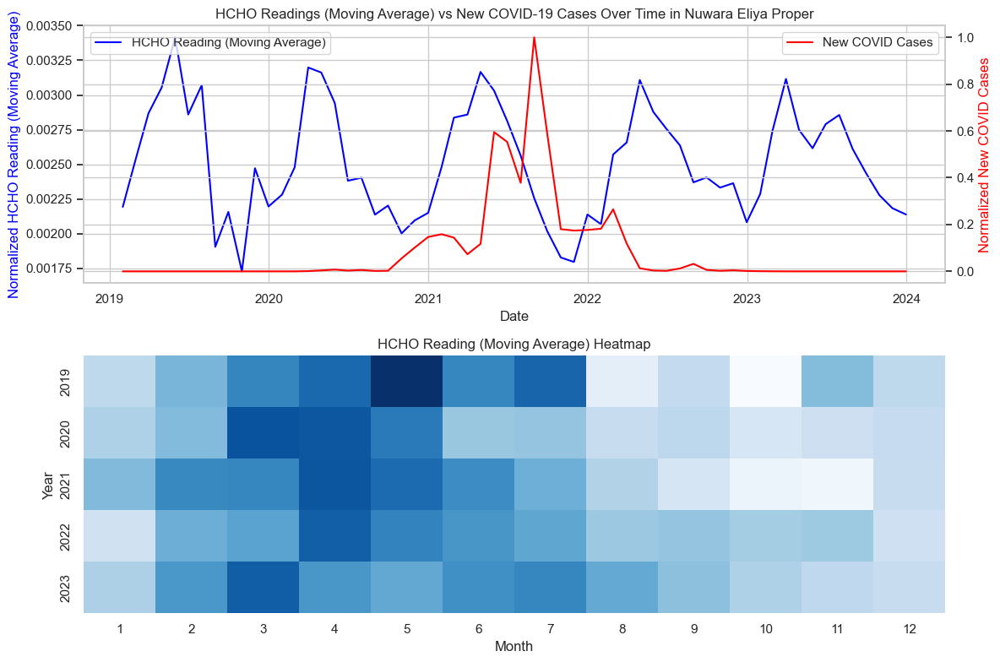

In [48]:
# Function to visualize HCHO readings and daily new COVID-19 cases for each location
def visualize_location(location):
    print(location)
    location_data = merged_df[merged_df['Location'] == location].copy()

    # Filter out non-numeric columns
    numeric_cols = ['HCHO_reading', 'new']
    location_data = location_data[['Current_Date'] + numeric_cols]

    # Resample data on a monthly basis
    location_data.set_index('Current_Date', inplace=True)
    location_data_monthly = location_data.resample('M').sum()

    # Calculate the 3-month moving average of HCHO readings
    location_data_monthly['HCHO_reading_ma'] = location_data_monthly['HCHO_reading'].rolling(window=3, min_periods=1).mean()

    # Normalize the columns for better visualization
    scaler = MinMaxScaler()
    location_data_monthly[numeric_cols] = scaler.fit_transform(location_data_monthly[numeric_cols])

    # Create a pivot table to reshape data for heatmap
    location_data_pivot = location_data_monthly.pivot_table(index=location_data_monthly.index.year,
                                                            columns=location_data_monthly.index.month,
                                                            values='HCHO_reading_ma')

    plt.figure(figsize=(12, 8))  # Increased figure size to accommodate heatmap

    # Time Series Plot
    plt.subplot(2, 1, 1)
    ax1 = sns.lineplot(data=location_data_monthly, x=location_data_monthly.index, y='HCHO_reading_ma', color='blue', label='HCHO Reading (Moving Average)')
    ax2 = ax1.twinx()
    sns.lineplot(data=location_data_monthly, x=location_data_monthly.index, y='new', color='red', label='New COVID Cases', ax=ax2)
    plt.title(f'HCHO Readings (Moving Average) vs New COVID-19 Cases Over Time in {location}')
    ax1.set_xlabel('Date')
    ax1.set_ylabel('Normalized HCHO Reading (Moving Average)', color='blue')
    ax2.set_ylabel('Normalized New COVID Cases', color='red')
    ax1.legend(loc='upper left')
    ax2.legend(loc='upper right')

    # Heatmap
    plt.subplot(2, 1, 2)
    sns.heatmap(location_data_pivot, cmap='Blues',cbar=False)
    plt.title('HCHO Reading (Moving Average) Heatmap')
    plt.xlabel('Month')
    plt.ylabel('Year')

    plt.tight_layout()
    plt.show()

# Visualize each location separately
locations = merged_df['Location'].unique()
for location in locations:
    visualize_location(location)


## By observing the above plots we can see that there’s a decrease in monthly sum of HCHO readings when the monthly new covid cases spike.

# City wise data correlation analysis

1. **Correlation Matrix Heatmap:**
   - This plot shows the correlation coefficients between all pairs of numerical features in the dataset.
   - Each cell represents the correlation coefficient between two features.
   - The color intensity and annotation within each cell represent the strength and direction of the correlation. Positive values indicate a positive correlation, negative values indicate a negative correlation, and values closer to zero indicate weaker or no correlation.
   - This plot helps identify potential multicollinearity issues between features and gives an overview of how each feature relates to others in the dataset.

2. **Correlation with HCHO_reading Heatmap:**
   - This plot specifically focuses on the correlation coefficients between numerical features and the target variable 'HCHO_reading'.
   - Similar to the correlation matrix heatmap, each cell represents the correlation coefficient between a feature and the target variable.
   - It helps identify which features have the strongest and weakest correlations with the target variable, aiding in feature selection for predictive modeling.

3. **Pairplot:**
   - The pairplot displays pairwise relationships between numerical columns in the dataset.
   - It shows scatterplots for each pair of features and histograms for each individual feature along the diagonal.
   - This plot helps visualize the distribution of each numerical feature, as well as the relationship between each pair of features. It can reveal linear or nonlinear patterns, outliers, and potential clusters in the data.

4. **Regression Plots:**
   - These plots depict the relationship between each numerical feature and the target variable 'HCHO_reading' using regression lines.
   - Each plot shows a scatterplot of the data points along with a regression line fitted to the data.
   - They help assess the strength and direction of the linear relationship between each feature and the target variable.
   - By observing the slope and direction of the regression line, we can determine whether the relationship is positive or negative and the magnitude of the effect of the feature on the target variable.

Overall, these plots provide valuable insights into the relationships and correlations within the dataset for each city, helping to inform feature selection, identify patterns, and understand the potential predictive power of the features.



# Colombo 

In [16]:
df=merged_df[merged_df['Location']=='Colombo Proper']
df.drop(columns=['Location','Sea Proximity Categorised', 
                 'Climate Zone','LATITUDE','LONGITUDE','ELEVATION',
                 'Area(km^2)','Sea Proximity (approximate-km)'],inplace=True)

C:\Users\janak\AppData\Local\Temp\ipykernel_6788\1886525555.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['Location','Sea Proximity Categorised',


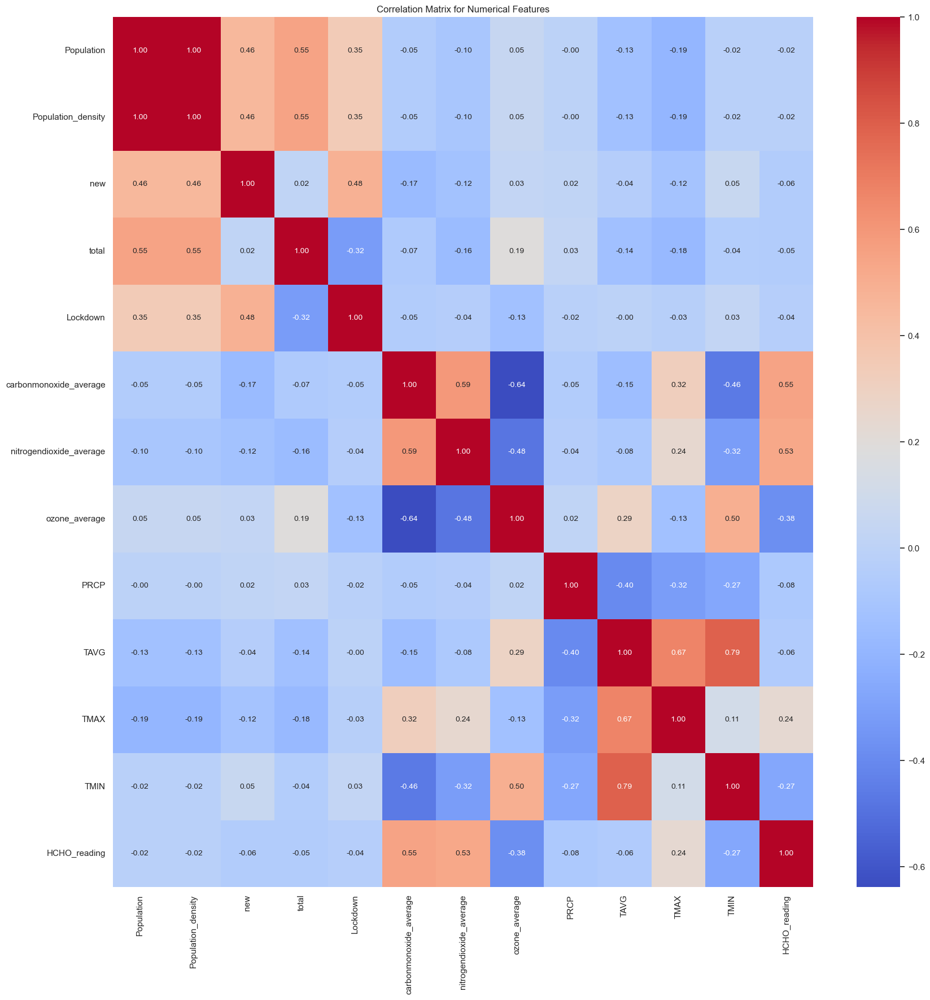

In [17]:
# Calculate the correlation matrix
correlation_matrix = df.corr(numeric_only =True)

# Plot the correlation matrix as a heatmap
plt.figure(figsize=(20, 20))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", annot_kws={"size": 10})
plt.title('Correlation Matrix for Numerical Features')
plt.show()

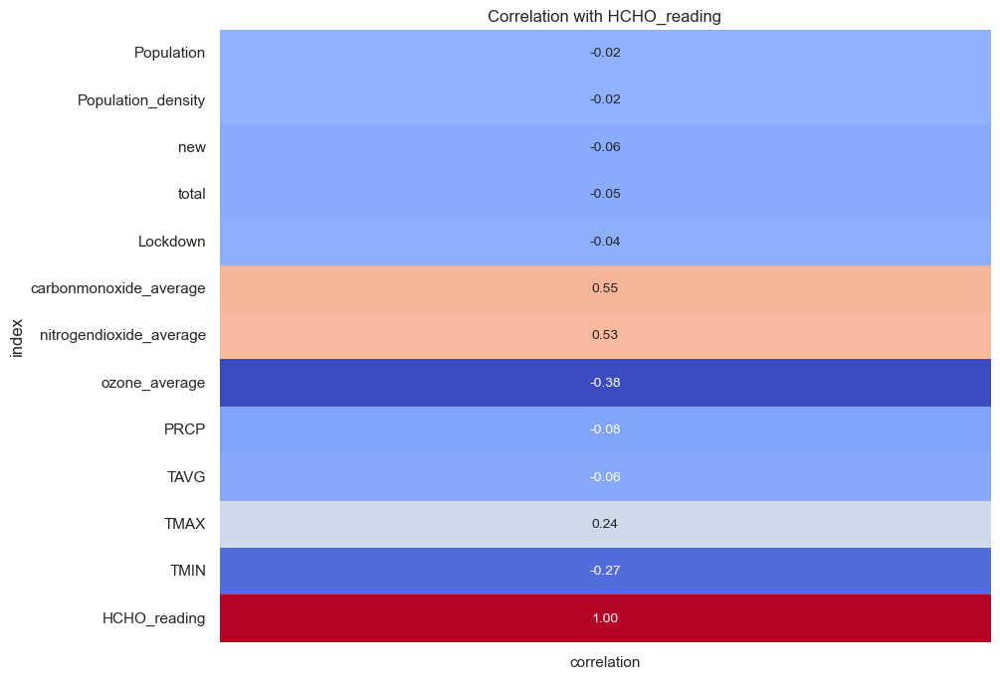

In [18]:
# Select only the correlation of numerical features with 'HCHO_reading'
correlation_with_target = correlation_matrix[['HCHO_reading']].reset_index().rename(columns={'HCHO_reading': 'correlation'})

# Plot the correlation with target as a heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_with_target.set_index('index'), cmap='coolwarm', annot=True, fmt=".2f", annot_kws={"size": 10}, cbar=False)
plt.title('Correlation with HCHO_reading')
plt.show()

In [68]:
numerical_columns = ['TMAX', 'TMIN', 'carbonmonoxide_average', 'nitrogendioxide_average', 'ozone_average',
                     'Population', 'Population_density', 'total', 'new']

# List of colors for regression plots
colors = ['blue', 'green', 'red', 'purple', 'orange', 'cyan', 'magenta', 'yellow', 'black']

# List of markers for regression plots
markers = ['o', 's', 'd', '^', 'v', '>', '<', 'p', 'h']

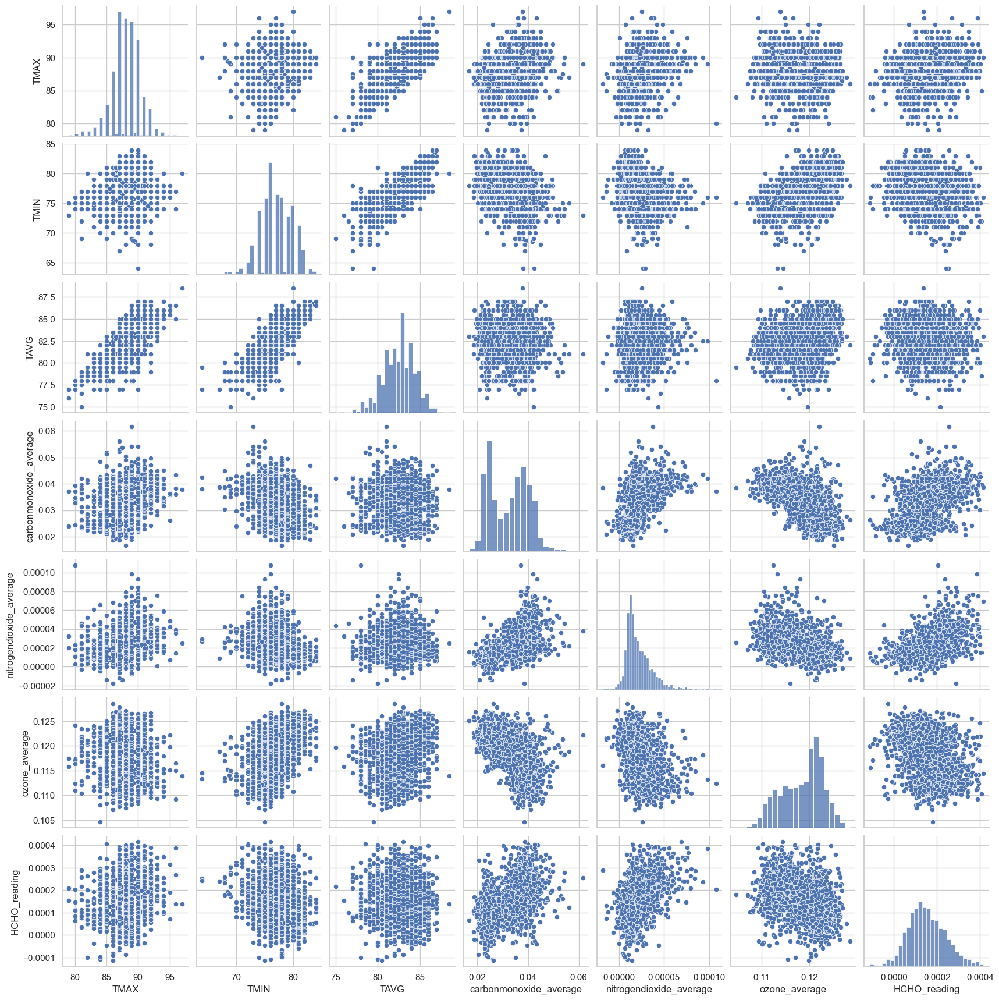

In [59]:
# Select numerical columns for pairplot
numerical_columns = ['TMAX', 'TMIN', 'TAVG' ,'carbonmonoxide_average', 
                     'nitrogendioxide_average', 'ozone_average', 'HCHO_reading']

# Create pairplot
sns.pairplot(df[numerical_columns])
plt.show()

TMAX


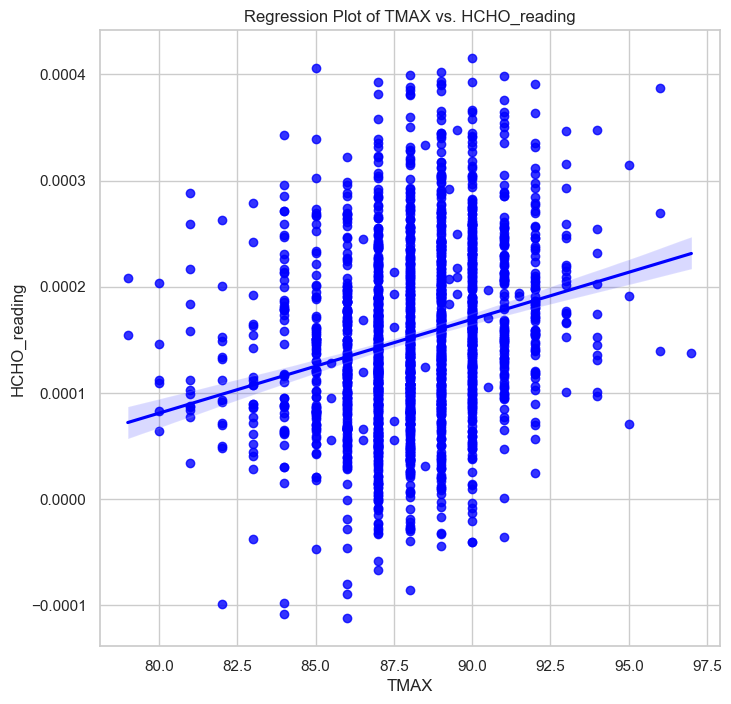

TMIN


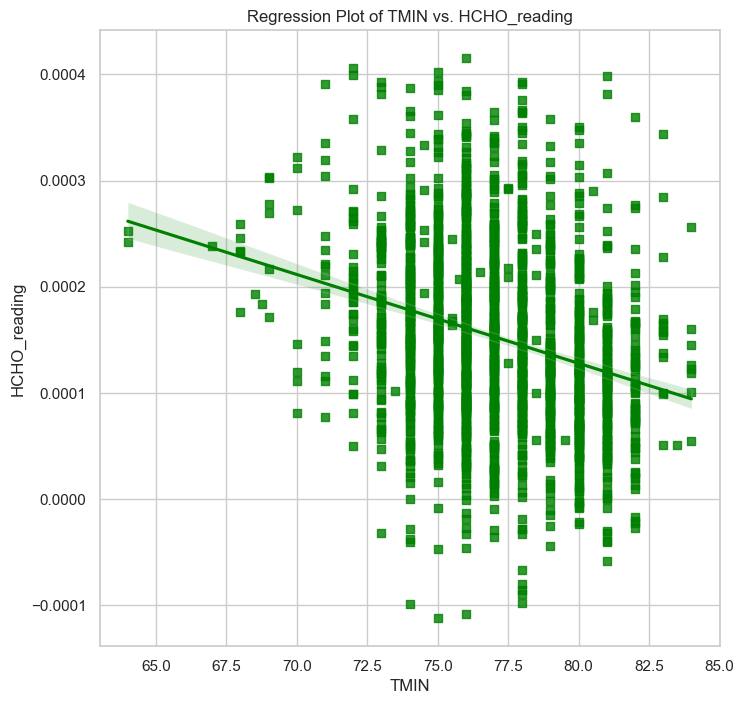

carbonmonoxide_average


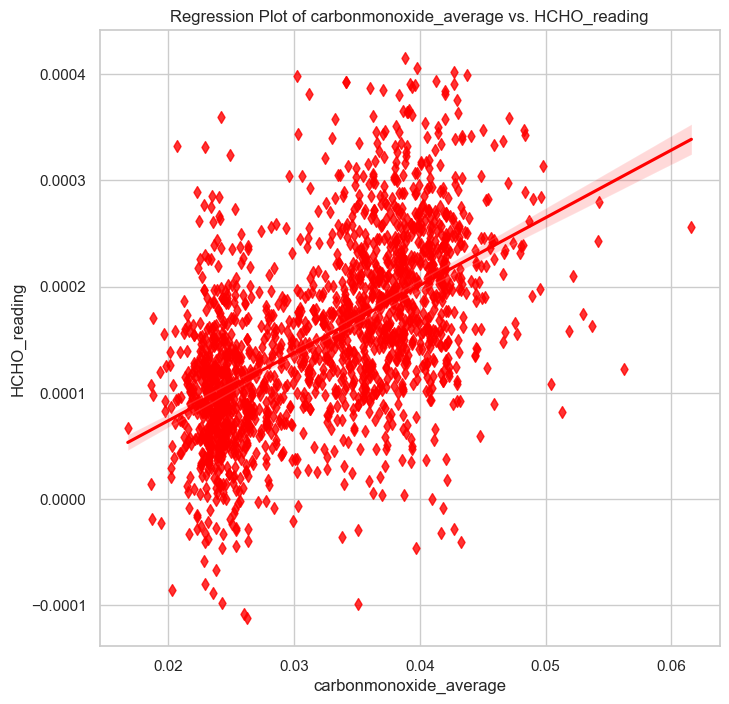

nitrogendioxide_average


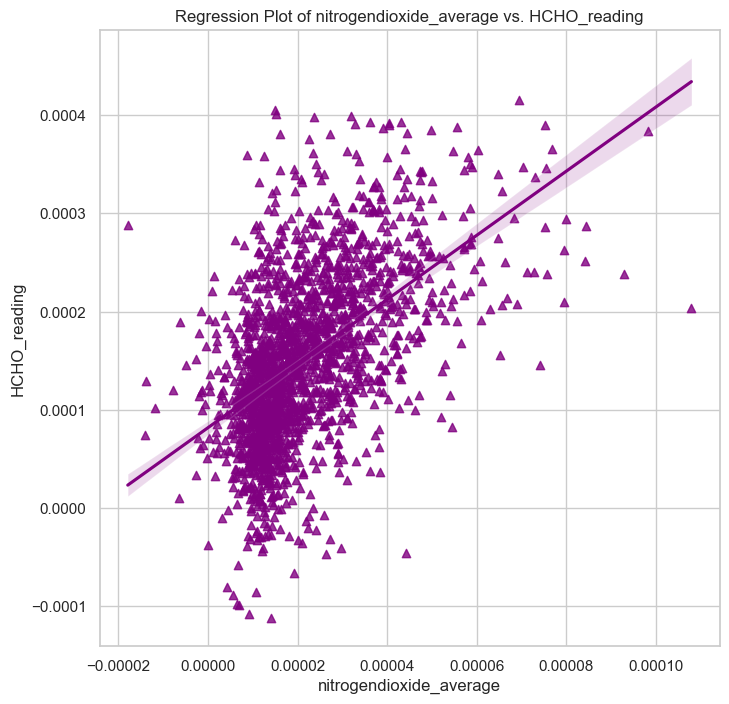

ozone_average


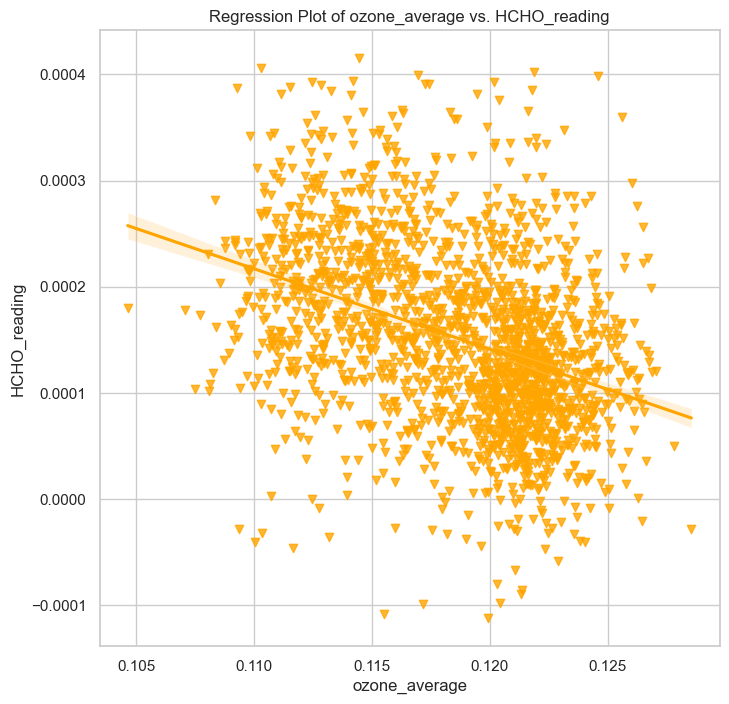

Population


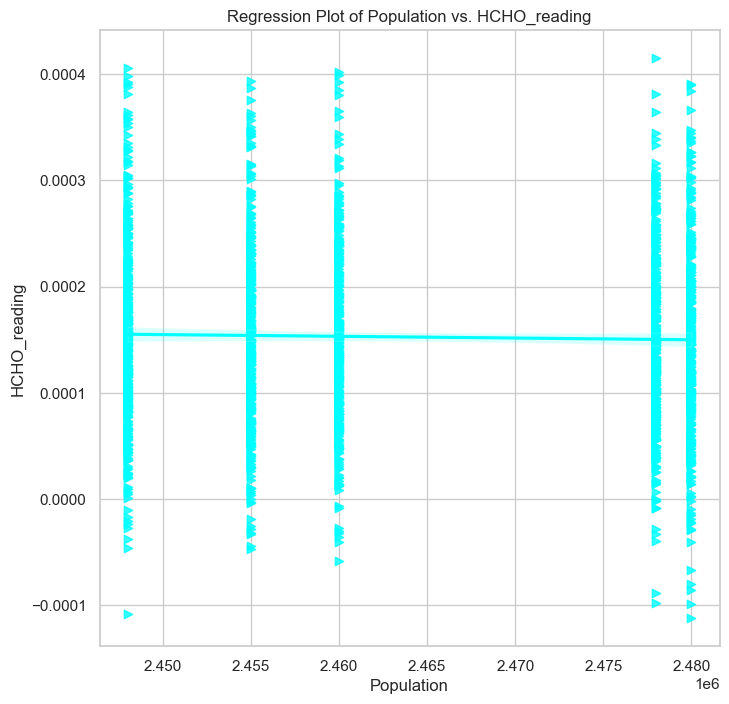

Population_density


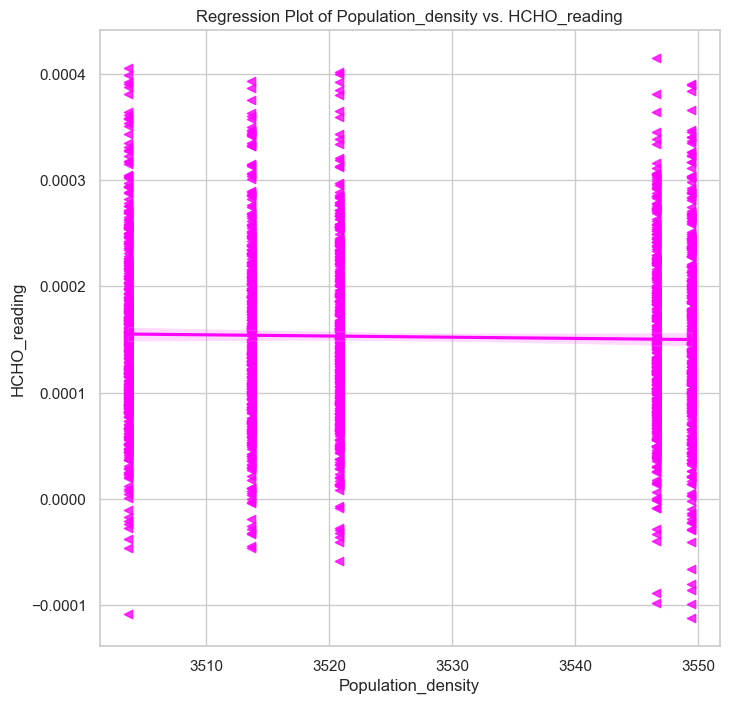

total


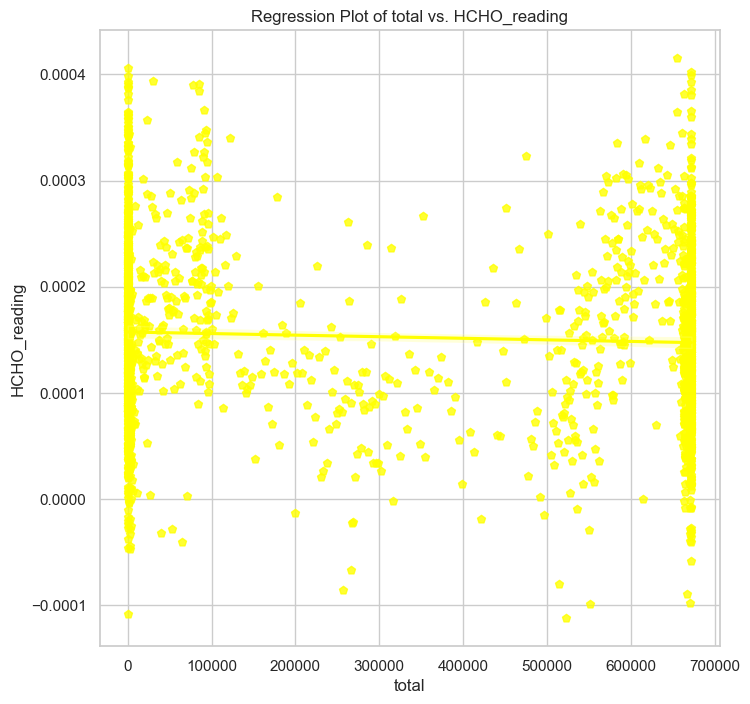

new


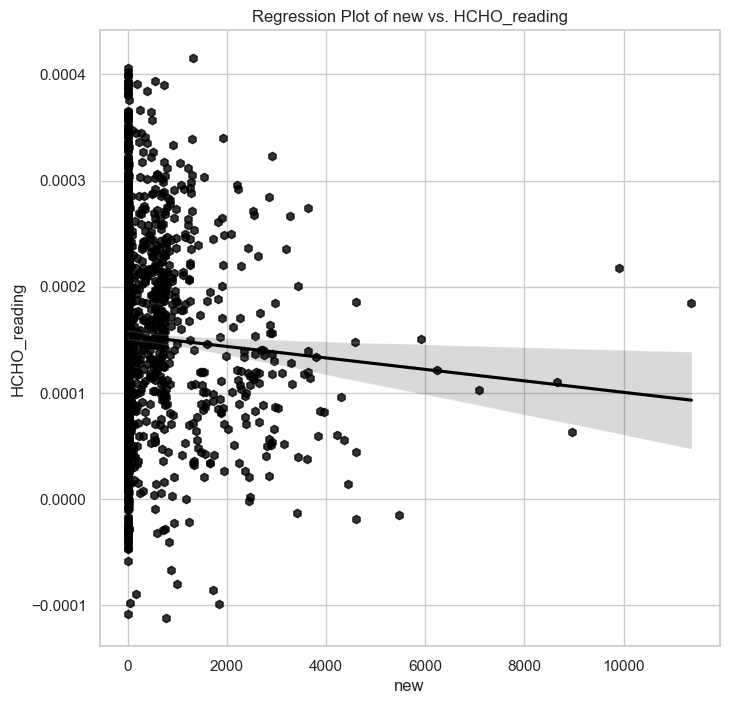

In [60]:
# List of numerical columns
numerical_columns = ['TMAX', 'TMIN', 'carbonmonoxide_average', 'nitrogendioxide_average', 'ozone_average',
                     'Population', 'Population_density', 'total', 'new']

# List of colors for regression plots
colors = ['blue', 'green', 'red', 'purple', 'orange', 'cyan', 'magenta', 'yellow', 'black']

# List of markers for regression plots
markers = ['o', 's', 'd', '^', 'v', '>', '<', 'p', 'h']

# Create regression plots with custom colors and markers
for i, column in enumerate(numerical_columns):
    print(column)
    plt.figure(figsize=(8, 8))
    sns.regplot(x=column, y='HCHO_reading', data=df, color=colors[i], marker=markers[i])
    plt.title(f'Regression Plot of {column} vs. HCHO_reading')
    plt.xlabel(column)
    plt.ylabel('HCHO_reading')
    plt.grid(True)
    plt.show()

C:\Users\janak\AppData\Local\Temp\ipykernel_15892\1904259869.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Moving_average']=df['HCHO_reading'].rolling(window=4, min_periods=1).mean()


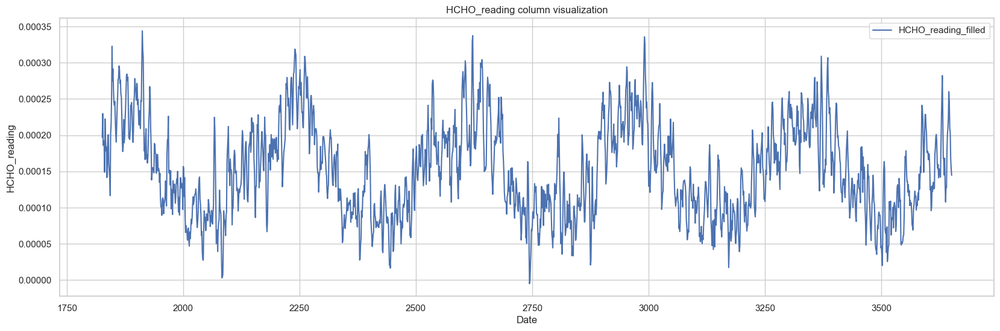

In [28]:
df['Moving_average']=df['HCHO_reading'].rolling(window=4, min_periods=1).mean()

# Display the DataFrame with the filled values
plt.figure(figsize=(20, 6))
plt.plot(df.index, df['Moving_average'], label='HCHO_reading_filled')
plt.title("HCHO_reading column visualization")
plt.xlabel("Date")
plt.ylabel("HCHO_reading")
plt.legend()
plt.show()

# Bibile, Monaragala

In [21]:
df=merged_df[merged_df['Location']=='Bibile, Monaragala']
df.drop(columns=['Location','Sea Proximity Categorised', 
                 'Climate Zone','LATITUDE','LONGITUDE','ELEVATION',
                 'Area(km^2)','Sea Proximity (approximate-km)'],inplace=True)

C:\Users\janak\AppData\Local\Temp\ipykernel_6788\2070459511.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['Location','Sea Proximity Categorised',


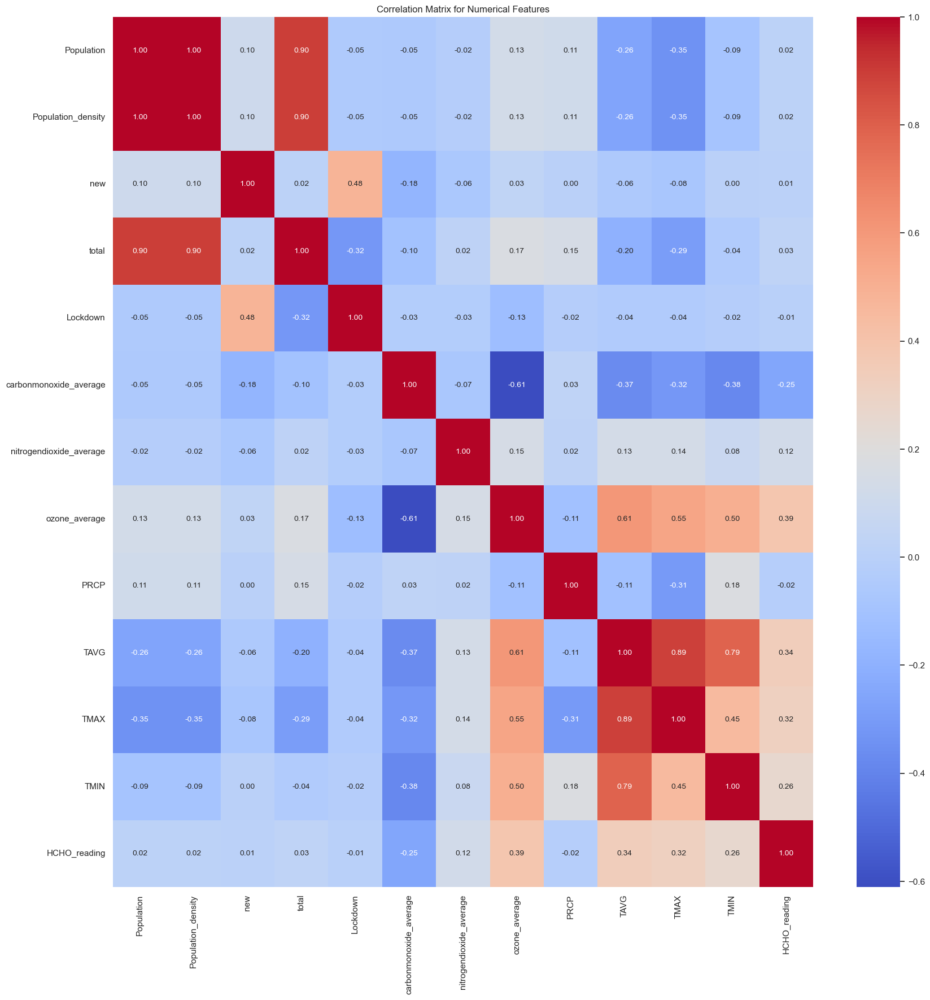

In [22]:
# Calculate the correlation matrix
correlation_matrix = df.corr(numeric_only =True)

# Plot the correlation matrix as a heatmap
plt.figure(figsize=(20, 20))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", annot_kws={"size": 10})
plt.title('Correlation Matrix for Numerical Features')
plt.show()

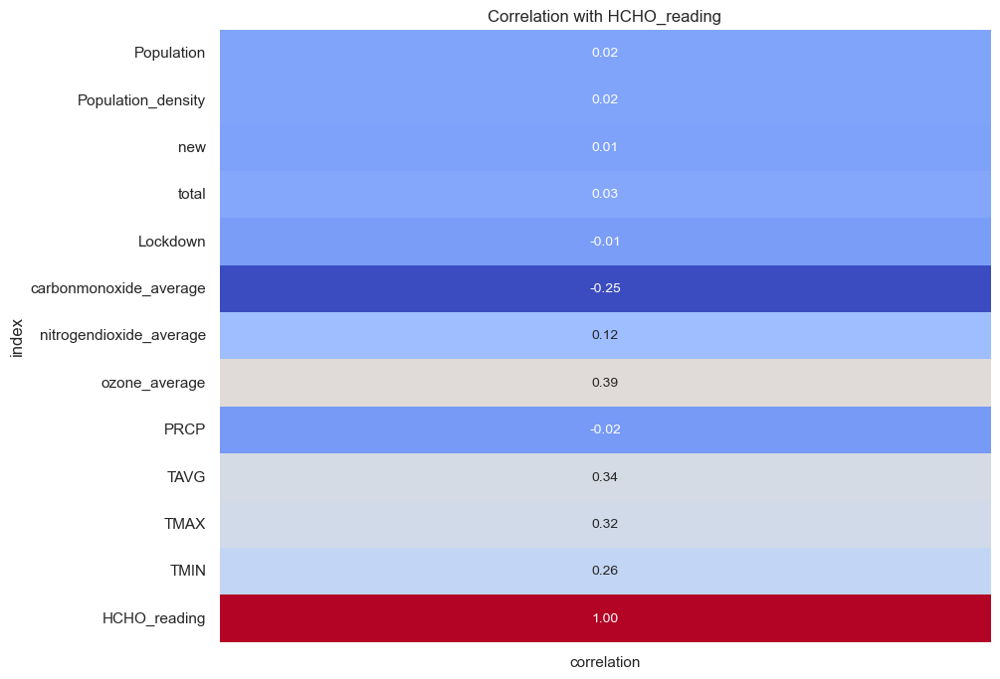

In [23]:
# Select only the correlation of numerical features with 'HCHO_reading'
correlation_with_target = correlation_matrix[['HCHO_reading']].reset_index().rename(columns={'HCHO_reading': 'correlation'})

# Plot the correlation with target as a heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_with_target.set_index('index'), cmap='coolwarm', annot=True, fmt=".2f", annot_kws={"size": 10}, cbar=False)
plt.title('Correlation with HCHO_reading')
plt.show()

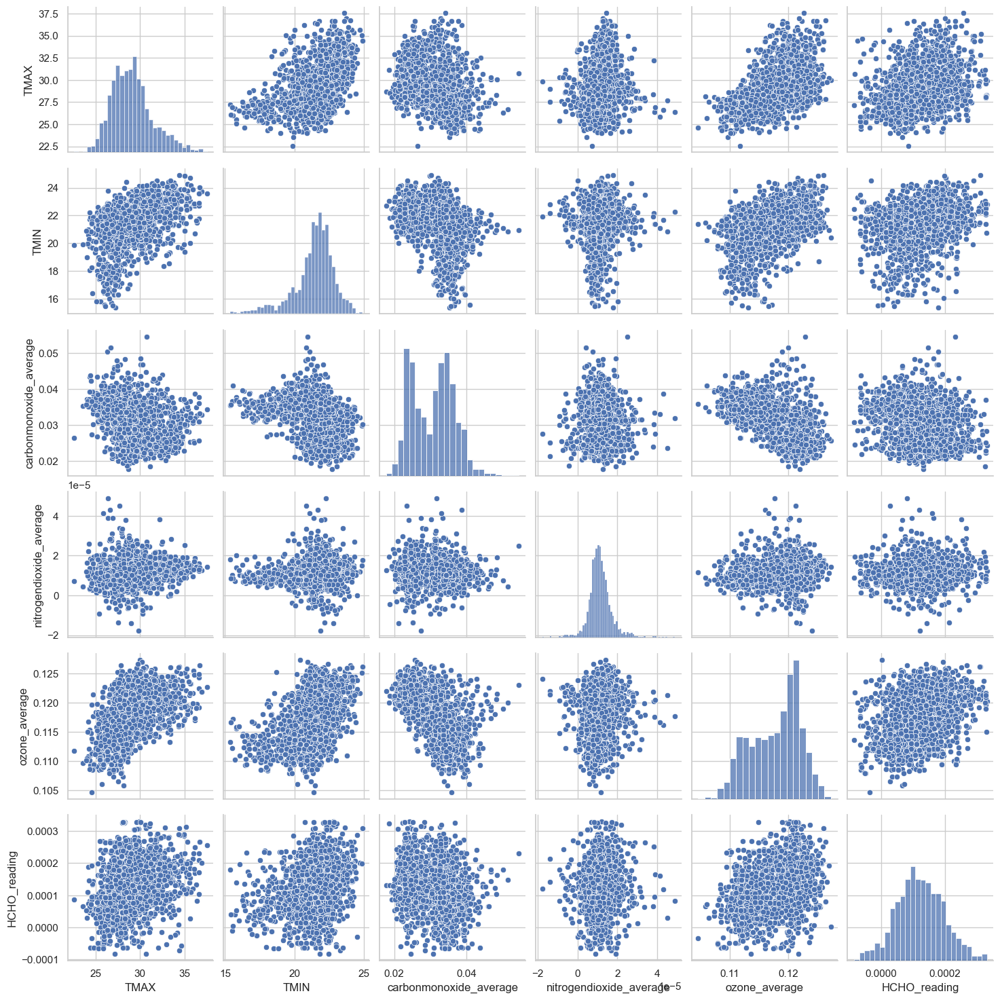

In [64]:
# Select numerical columns for pairplot
numerical_columns = ['TMAX', 'TMIN', 'carbonmonoxide_average', 'nitrogendioxide_average', 'ozone_average', 'HCHO_reading']

# Create pairplot
sns.pairplot(df[numerical_columns])
plt.show()

TMAX


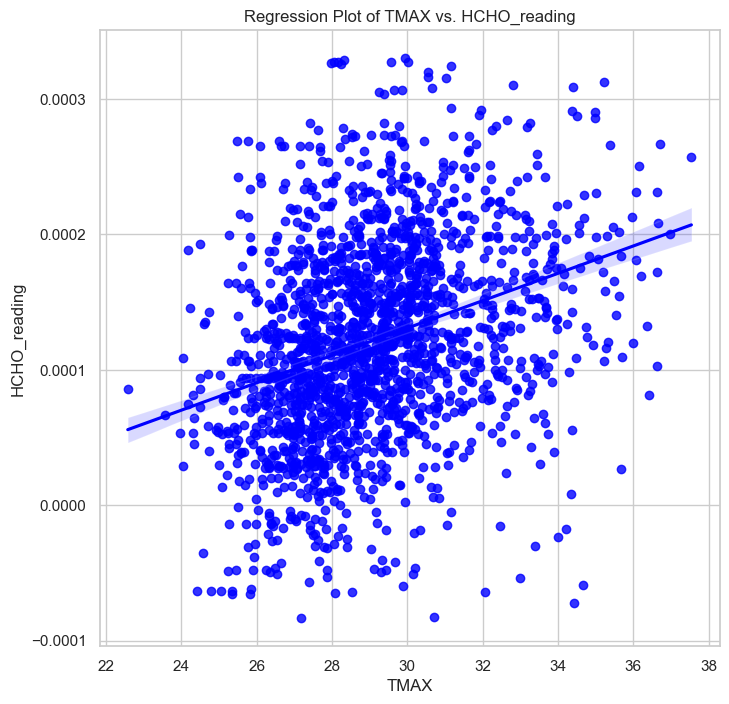

TMIN


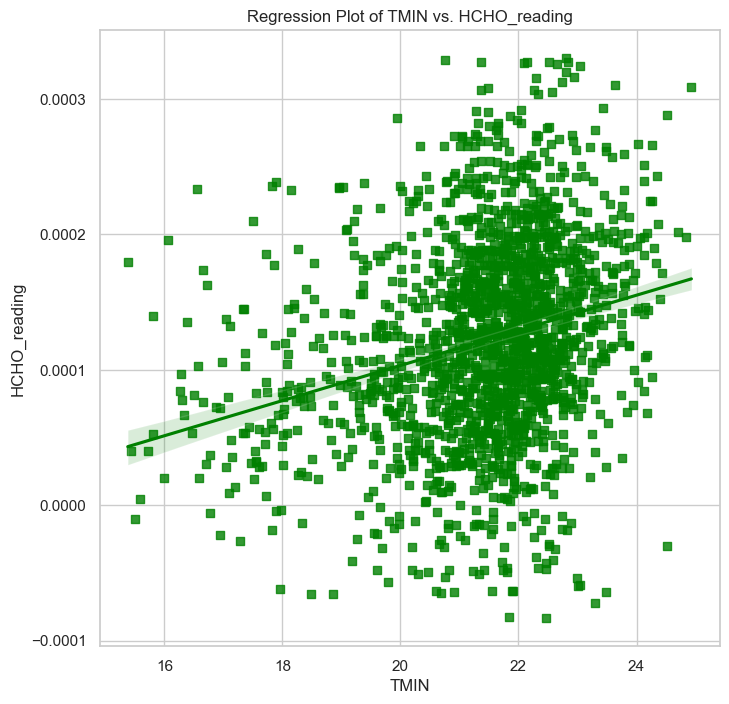

carbonmonoxide_average


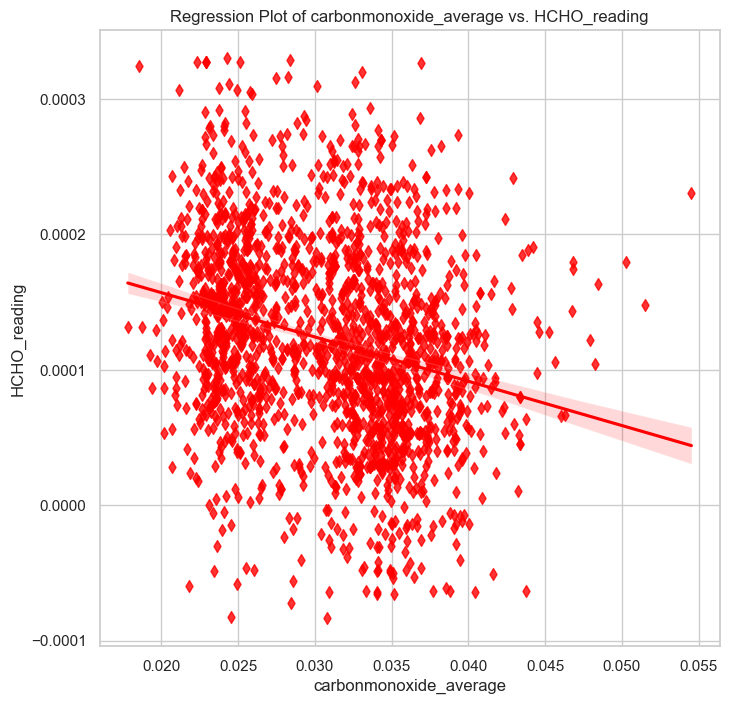

nitrogendioxide_average


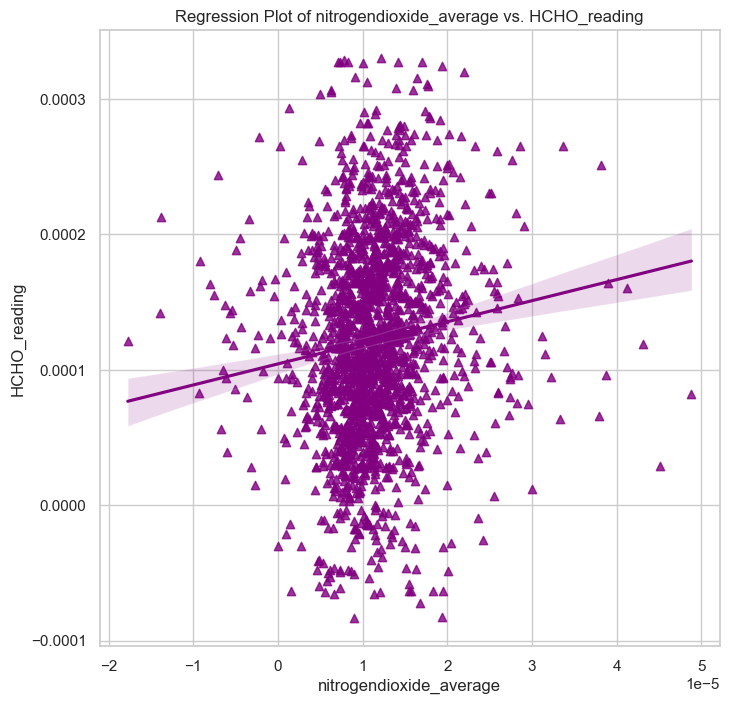

ozone_average


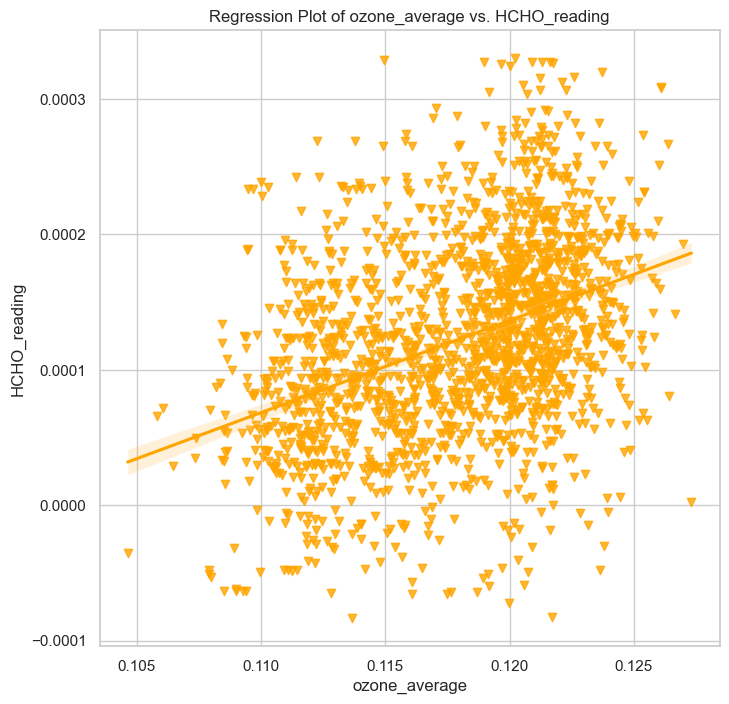

Population


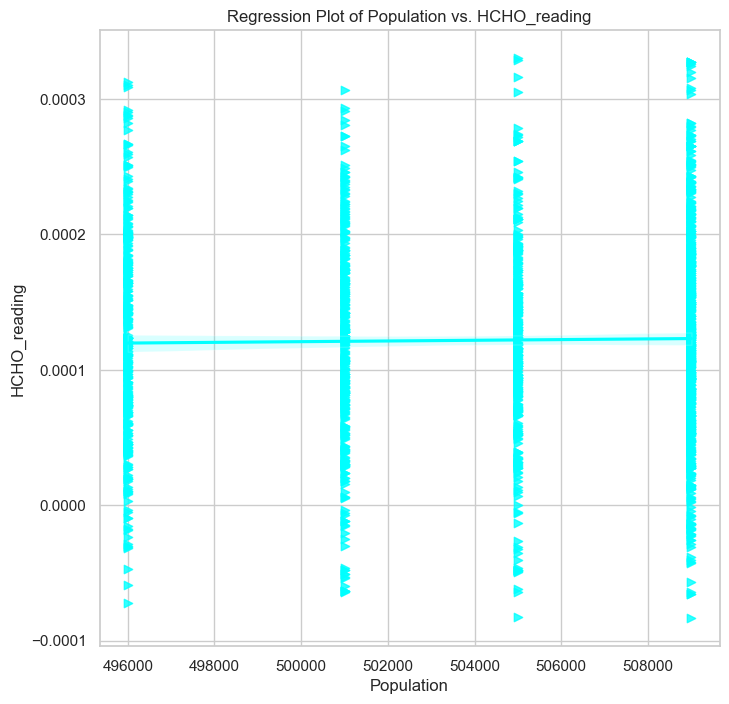

Population_density


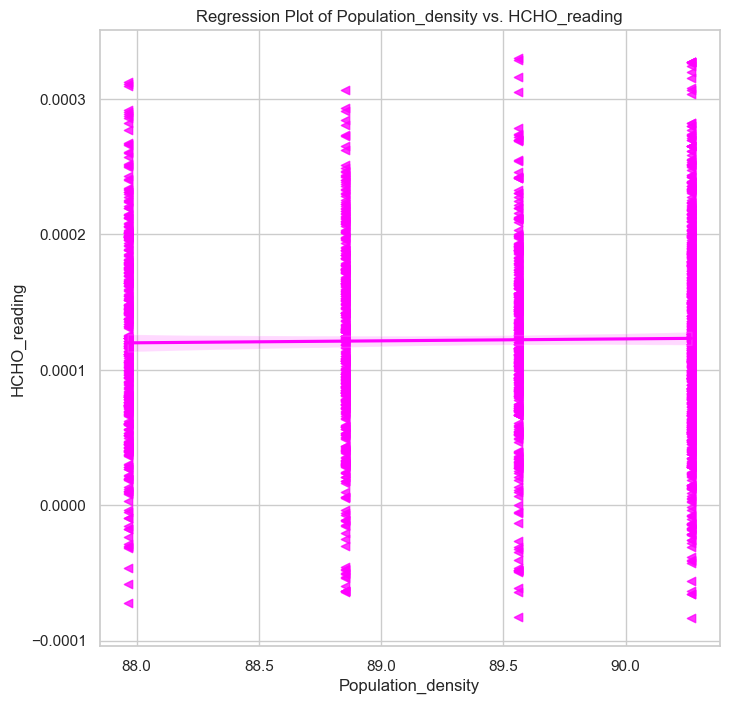

total


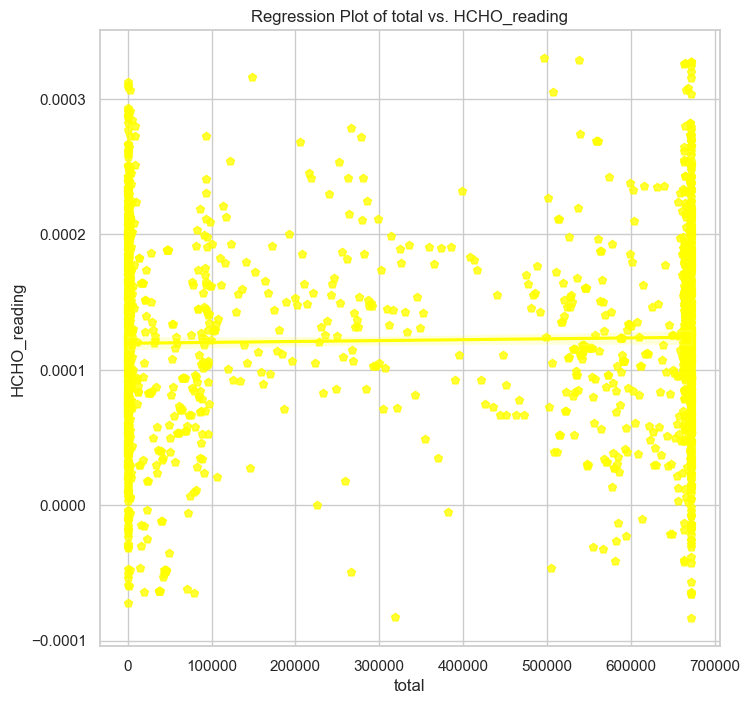

new


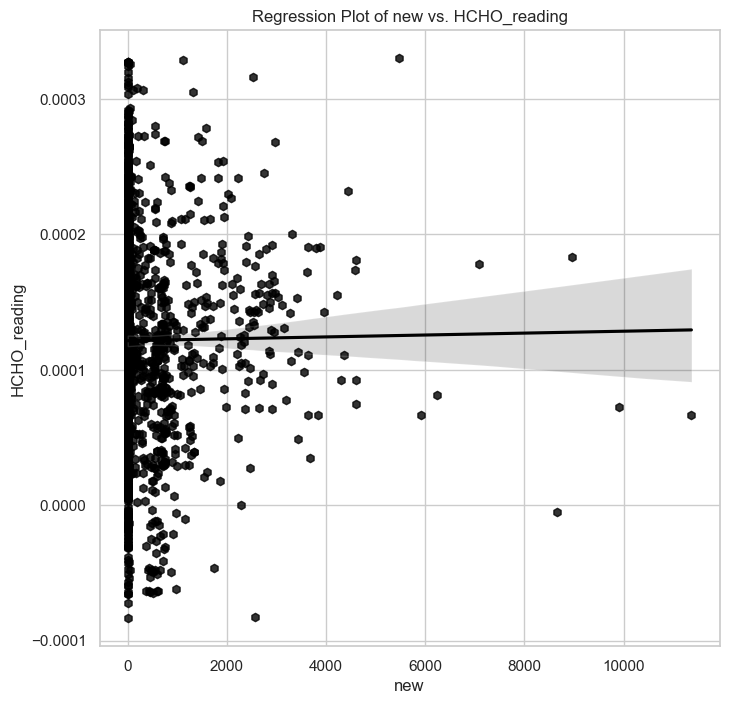

In [69]:


# Create regression plots with custom colors and markers
for i, column in enumerate(numerical_columns):
    print(column)
    plt.figure(figsize=(8, 8))
    sns.regplot(x=column, y='HCHO_reading', data=df, color=colors[i], marker=markers[i])
    plt.title(f'Regression Plot of {column} vs. HCHO_reading')
    plt.xlabel(column)
    plt.ylabel('HCHO_reading')
    plt.grid(True)
    plt.show()

In [66]:
merged_df['Location'].unique()

array(['Bibile, Monaragala', 'Colombo Proper', 'Deniyaya, Matara',
       'Jaffna Proper', 'Kandy Proper', 'Kurunegala Proper',
       'Nuwara Eliya Proper'], dtype=object)

# Deniyaya, Matara

In [49]:
df=merged_df[merged_df['Location']=='Deniyaya, Matara']
df.drop(columns=['Location','Sea Proximity Categorised', 
                 'Climate Zone','LATITUDE','LONGITUDE','ELEVATION',
                 'Area(km^2)','Sea Proximity (approximate-km)'],inplace=True)

C:\Users\janak\AppData\Local\Temp\ipykernel_6788\4062180571.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['Location','Sea Proximity Categorised',


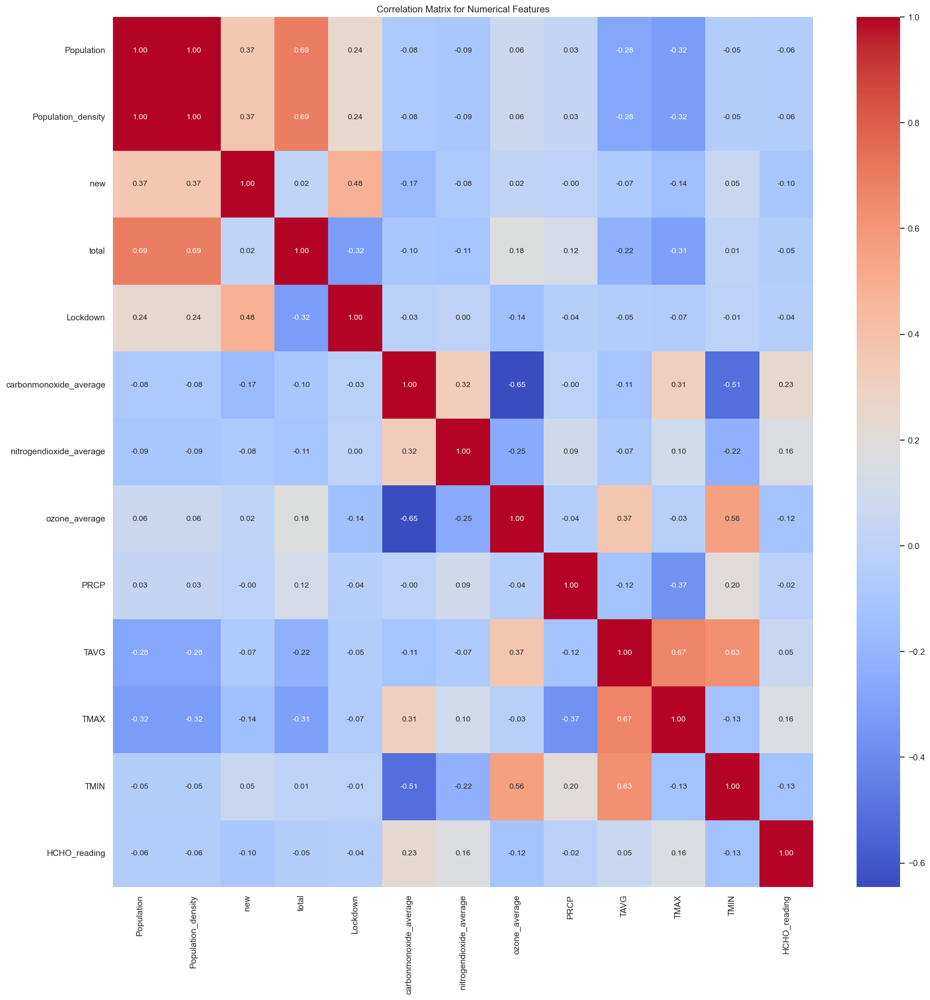

In [50]:
# Calculate the correlation matrix
correlation_matrix = df.corr(numeric_only =True)

# Plot the correlation matrix as a heatmap
plt.figure(figsize=(20, 20))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", annot_kws={"size": 10})
plt.title('Correlation Matrix for Numerical Features')
plt.show()

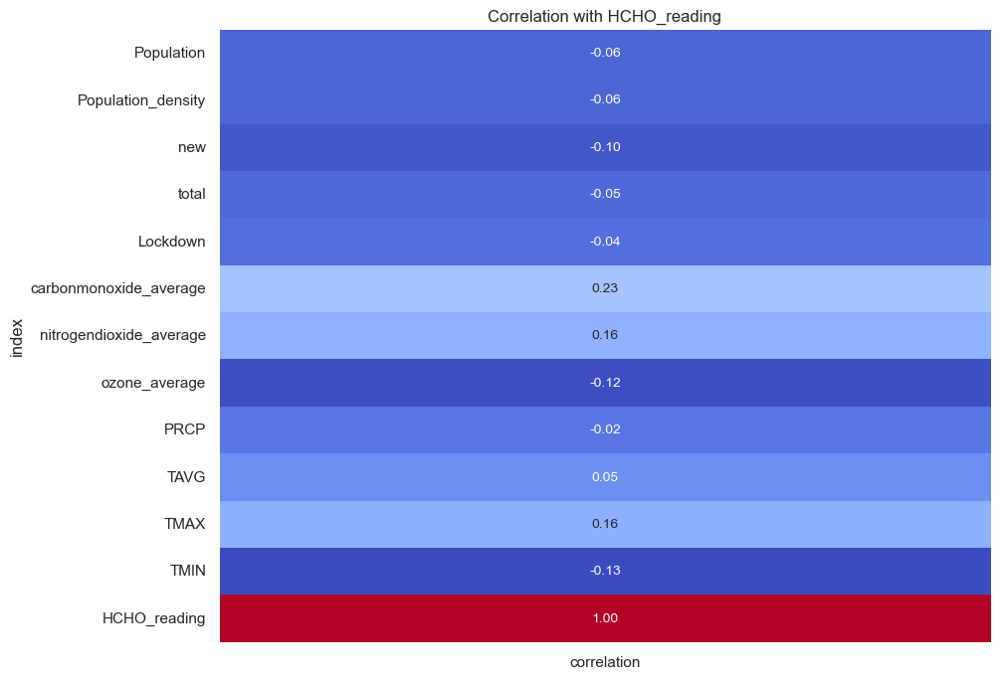

In [51]:
# Select only the correlation of numerical features with 'HCHO_reading'
correlation_with_target = correlation_matrix[['HCHO_reading']].reset_index().rename(columns={'HCHO_reading': 'correlation'})

# Plot the correlation with target as a heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_with_target.set_index('index'), cmap='coolwarm', annot=True, fmt=".2f", annot_kws={"size": 10}, cbar=False)
plt.title('Correlation with HCHO_reading')
plt.show()

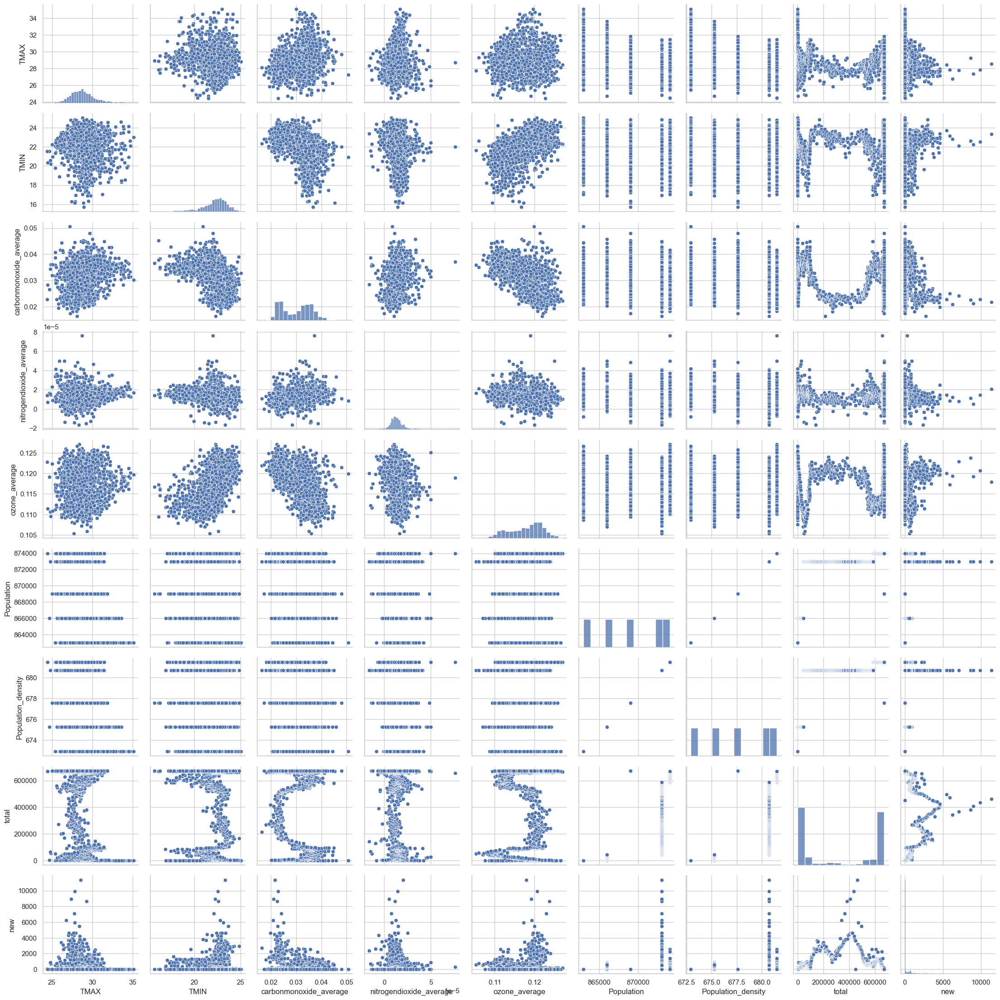

In [73]:
# Create pairplot
sns.pairplot(df[numerical_columns])
plt.show()

TMAX


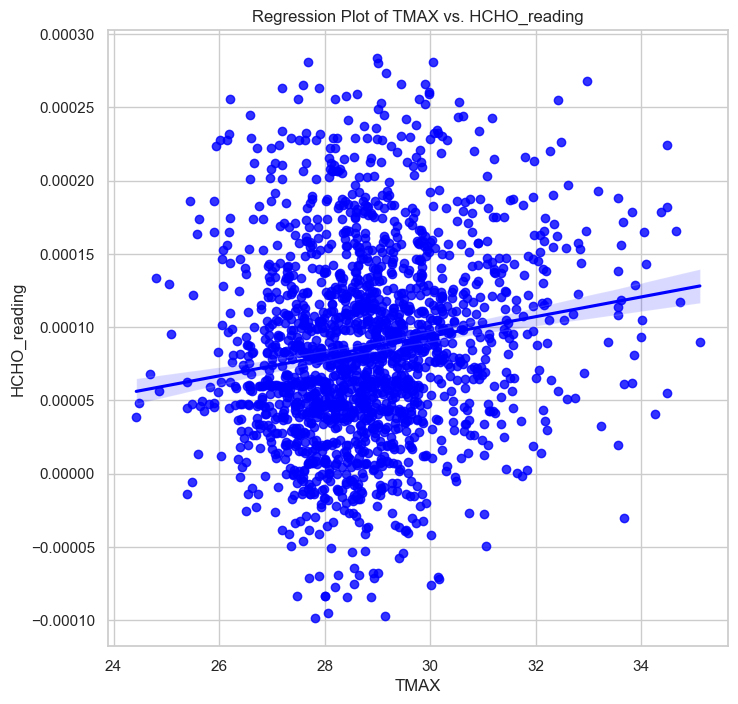

TMIN


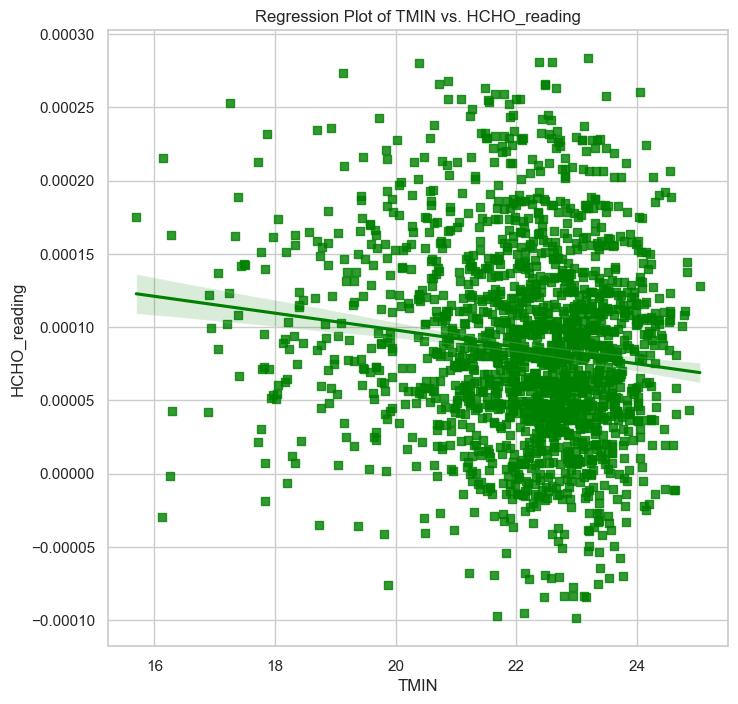

carbonmonoxide_average


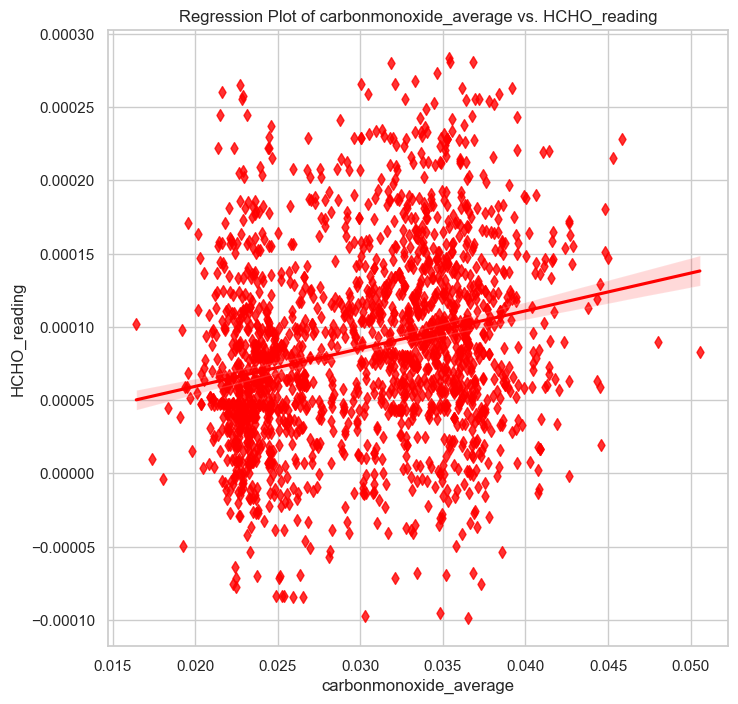

nitrogendioxide_average


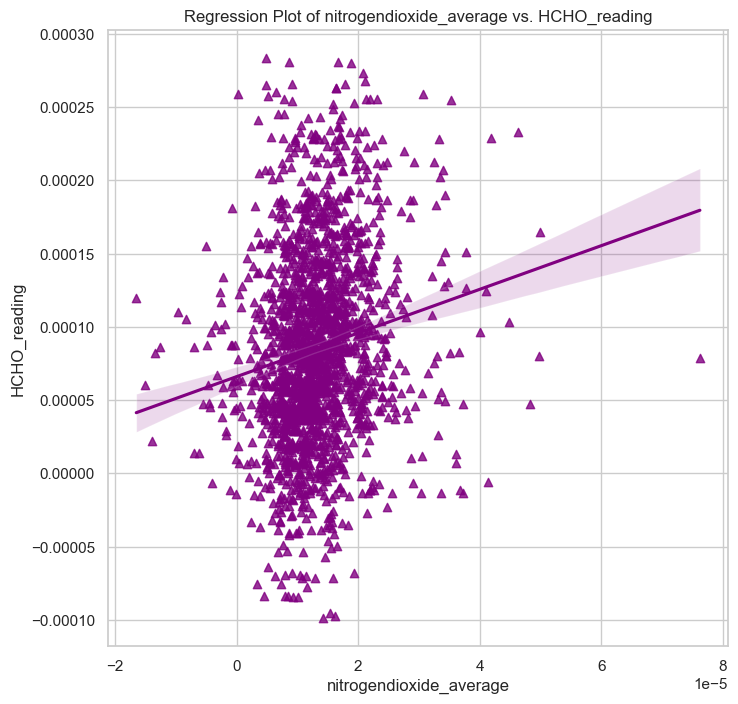

ozone_average


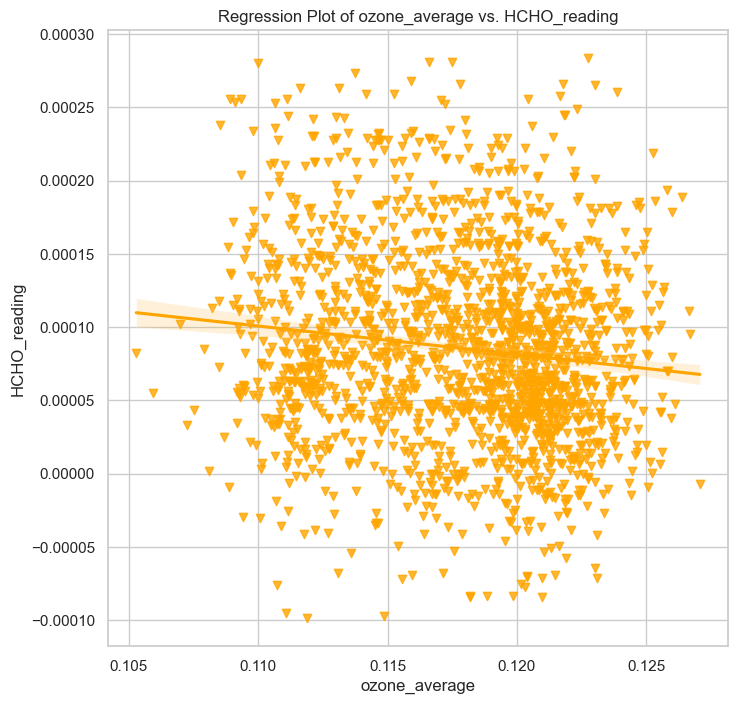

Population


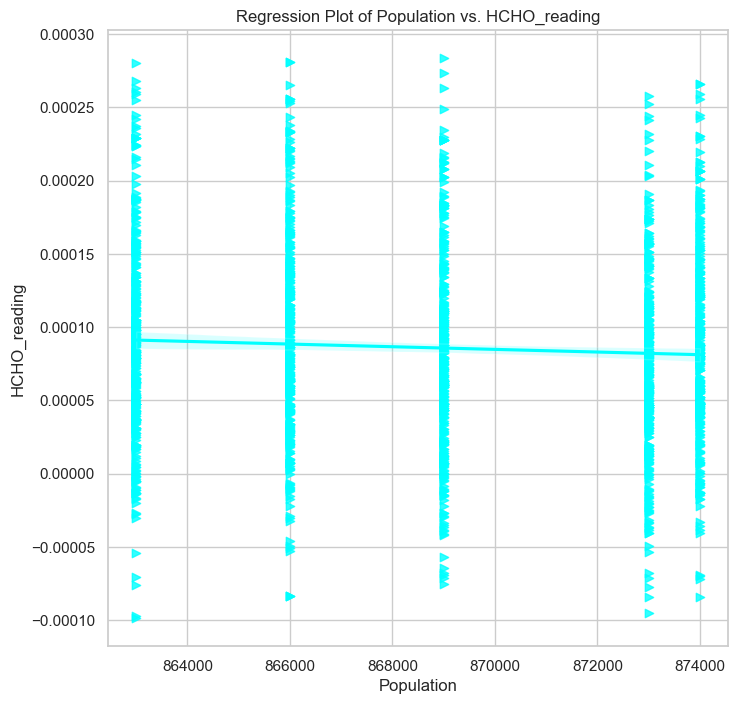

Population_density


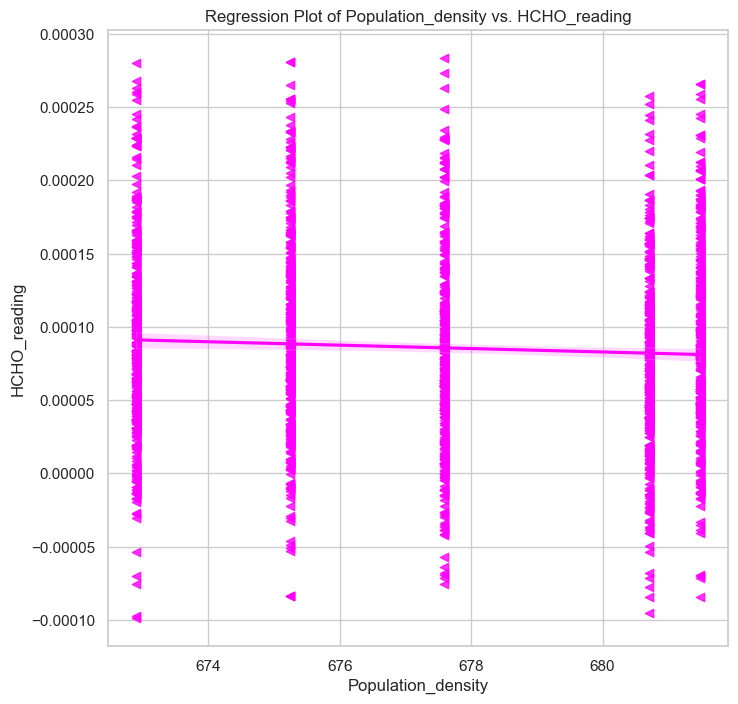

total


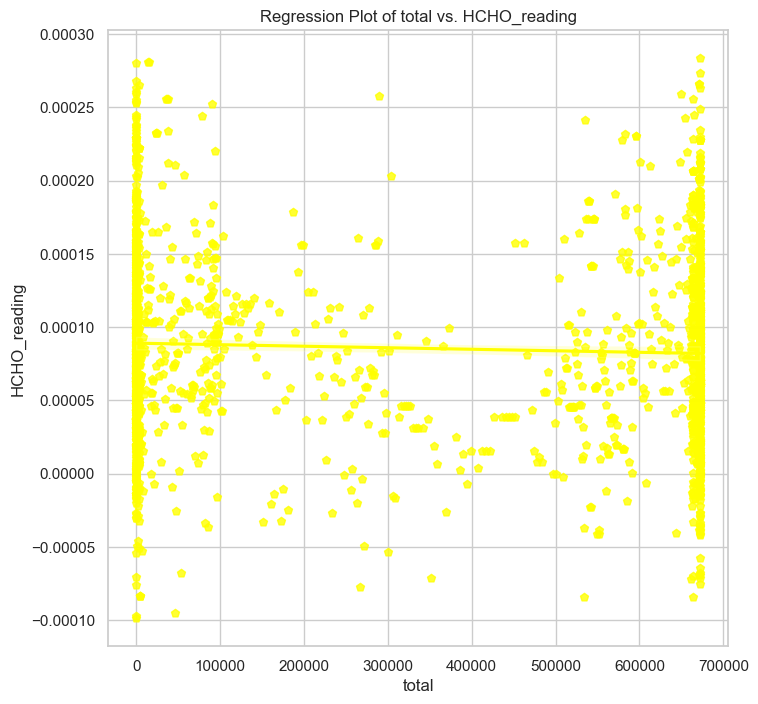

new


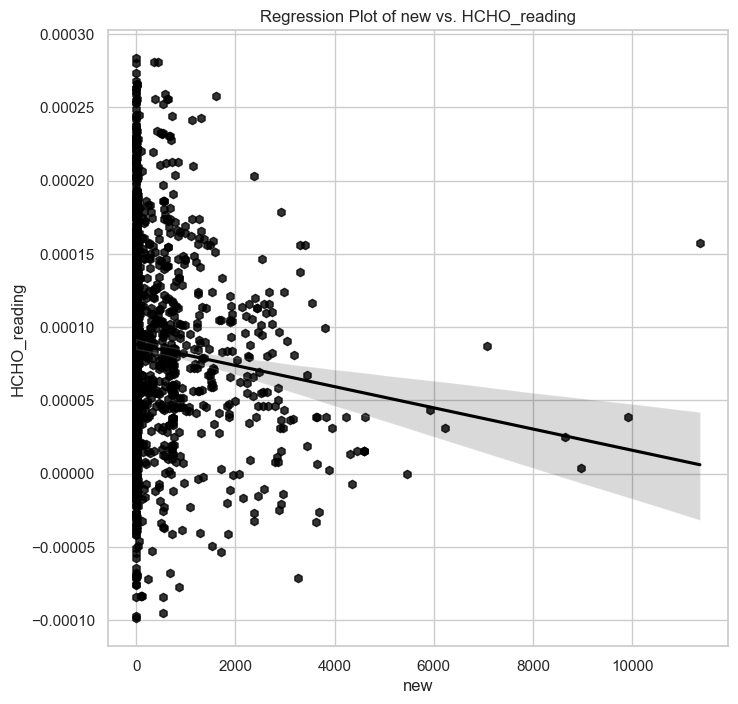

In [74]:
# Create regression plots with custom colors and markers
for i, column in enumerate(numerical_columns):
    print(column)
    plt.figure(figsize=(8, 8))
    sns.regplot(x=column, y='HCHO_reading', data=df, color=colors[i], marker=markers[i])
    plt.title(f'Regression Plot of {column} vs. HCHO_reading')
    plt.xlabel(column)
    plt.ylabel('HCHO_reading')
    plt.grid(True)
    plt.show()

In [101]:
merged_df['Location'].unique()

array(['Bibile, Monaragala', 'Colombo Proper', 'Deniyaya, Matara',
       'Jaffna Proper', 'Kandy Proper', 'Kurunegala Proper',
       'Nuwara Eliya Proper'], dtype=object)

# Jaffna Proper

In [45]:
df=merged_df[merged_df['Location']=='Jaffna Proper']
df.drop(columns=['Location','Sea Proximity Categorised', 
                 'Climate Zone','LATITUDE','LONGITUDE','ELEVATION',
                 'Area(km^2)','Sea Proximity (approximate-km)'],inplace=True)

C:\Users\janak\AppData\Local\Temp\ipykernel_6788\1677411757.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['Location','Sea Proximity Categorised',


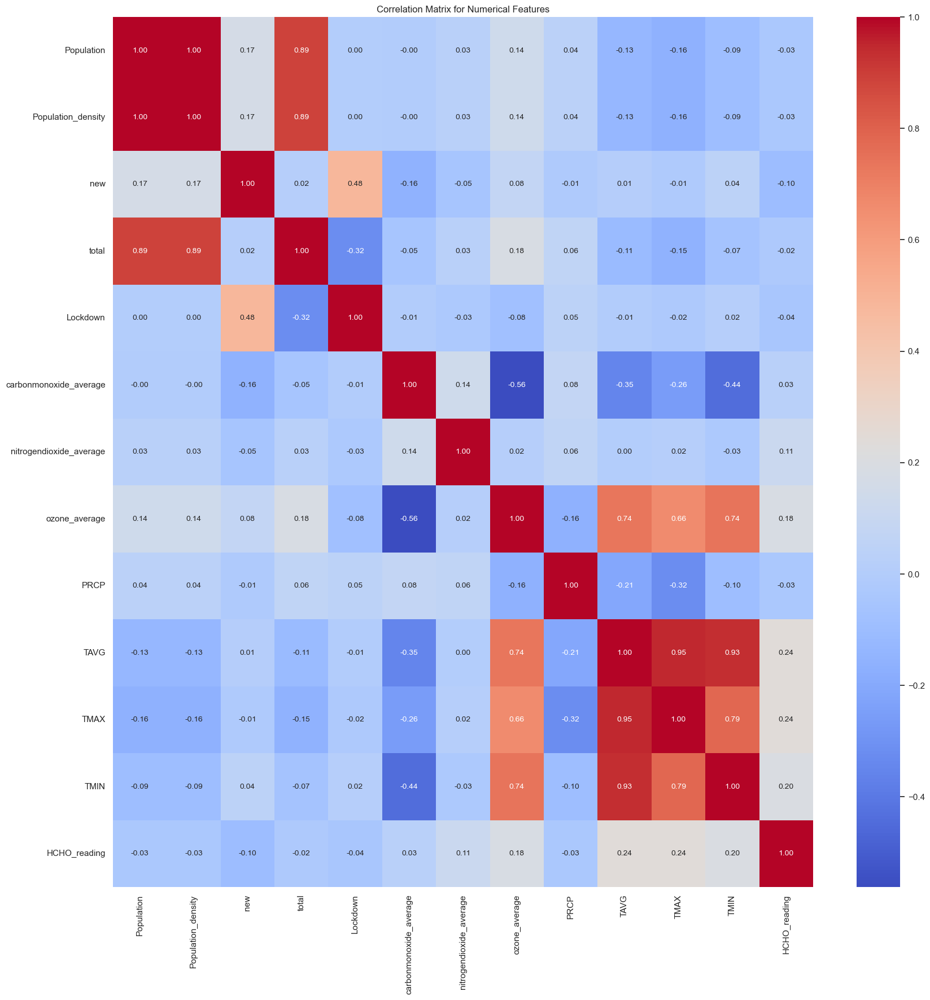

In [46]:
# Calculate the correlation matrix
correlation_matrix = df.corr(numeric_only =True)

# Plot the correlation matrix as a heatmap
plt.figure(figsize=(20, 20))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", annot_kws={"size": 10})
plt.title('Correlation Matrix for Numerical Features')
plt.show()

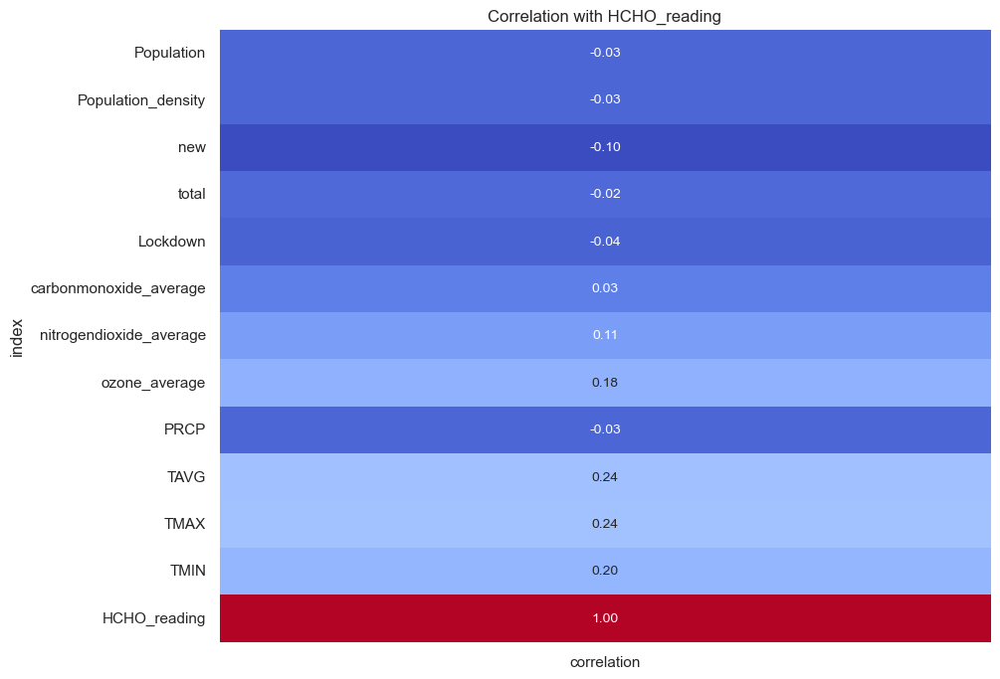

In [47]:
# Select only the correlation of numerical features with 'HCHO_reading'
correlation_with_target = correlation_matrix[['HCHO_reading']].reset_index().rename(columns={'HCHO_reading': 'correlation'})

# Plot the correlation with target as a heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_with_target.set_index('index'), cmap='coolwarm', annot=True, fmt=".2f", annot_kws={"size": 10}, cbar=False)
plt.title('Correlation with HCHO_reading')
plt.show()

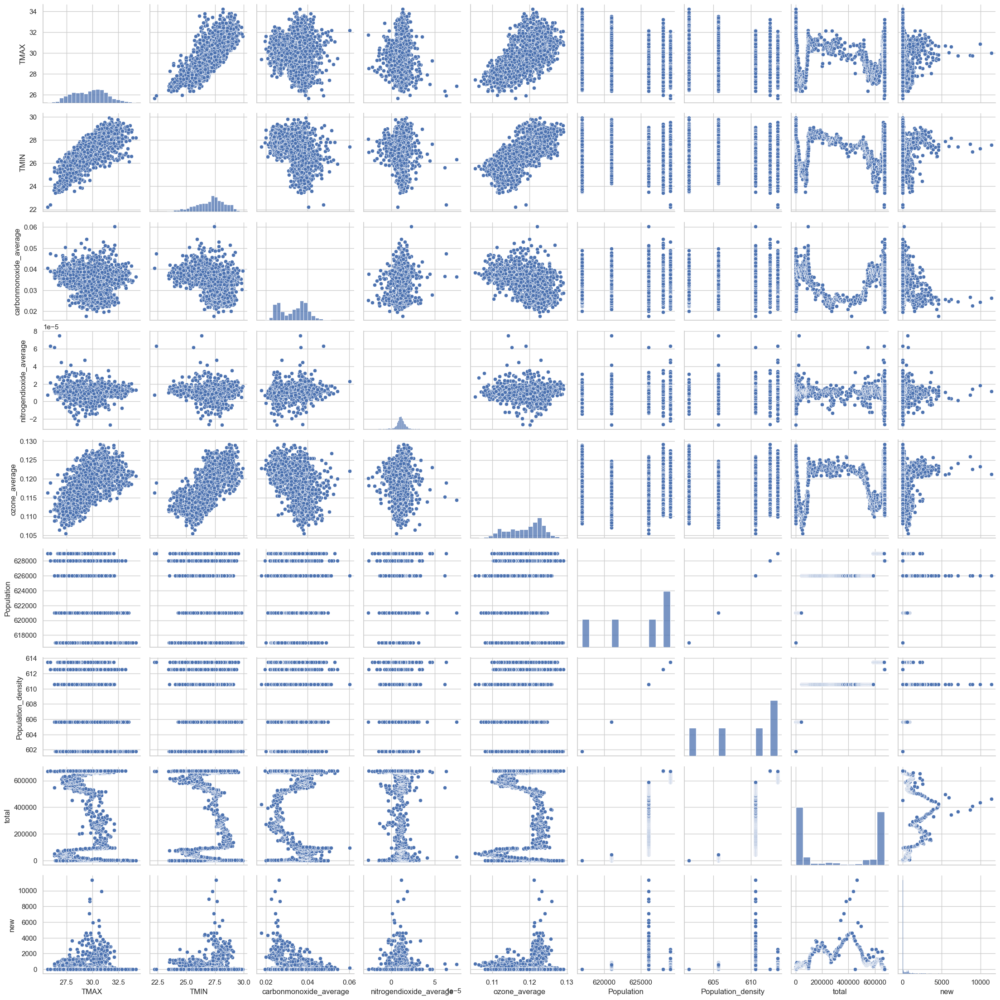

In [78]:
# Create pairplot
sns.pairplot(df[numerical_columns])
plt.show()

TMAX


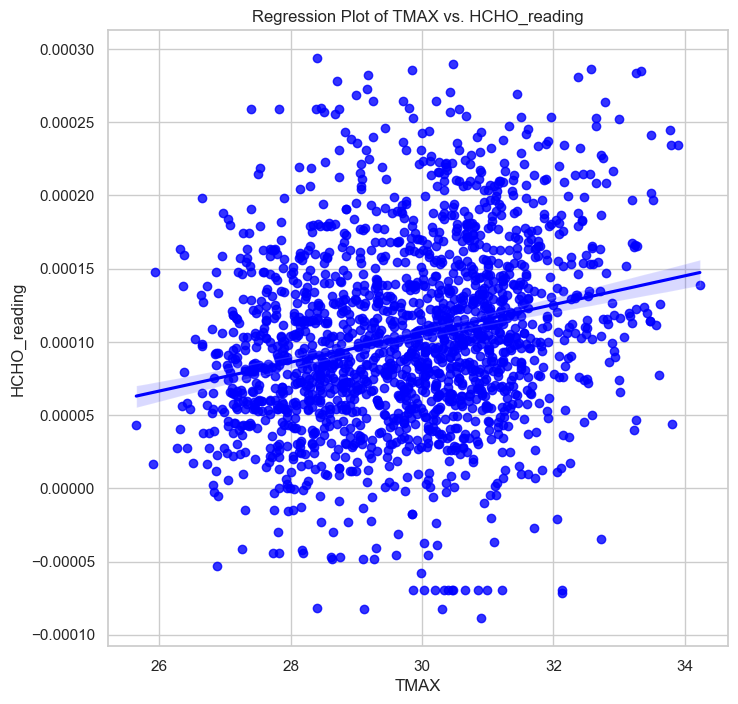

TMIN


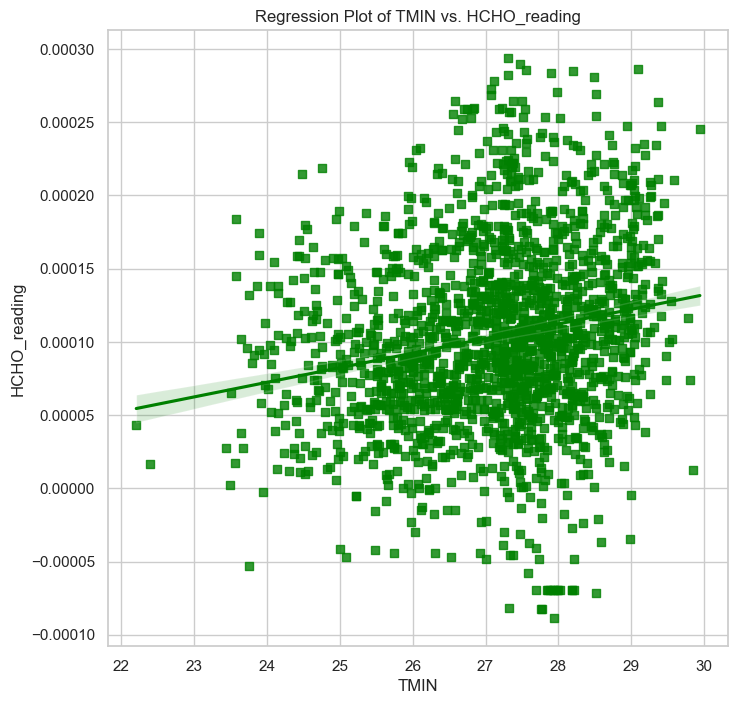

carbonmonoxide_average


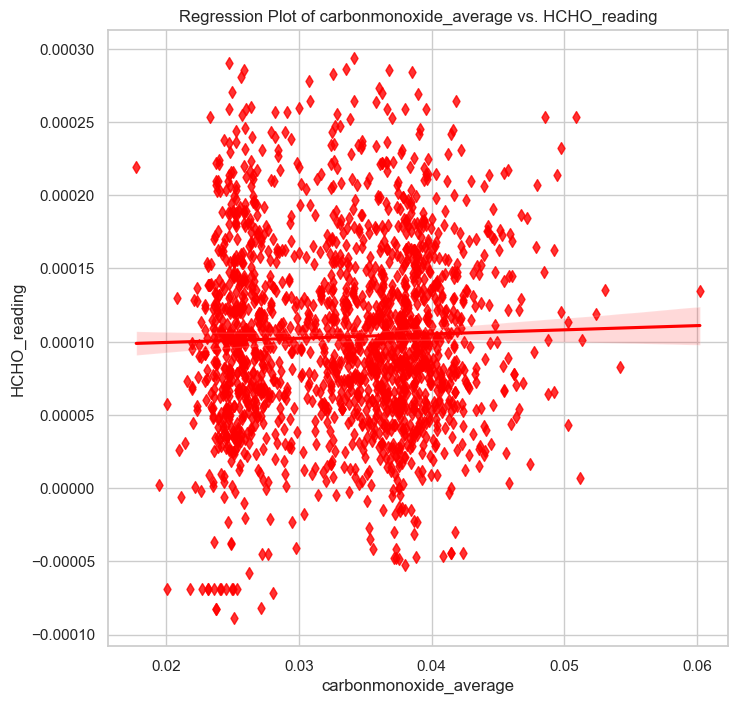

nitrogendioxide_average


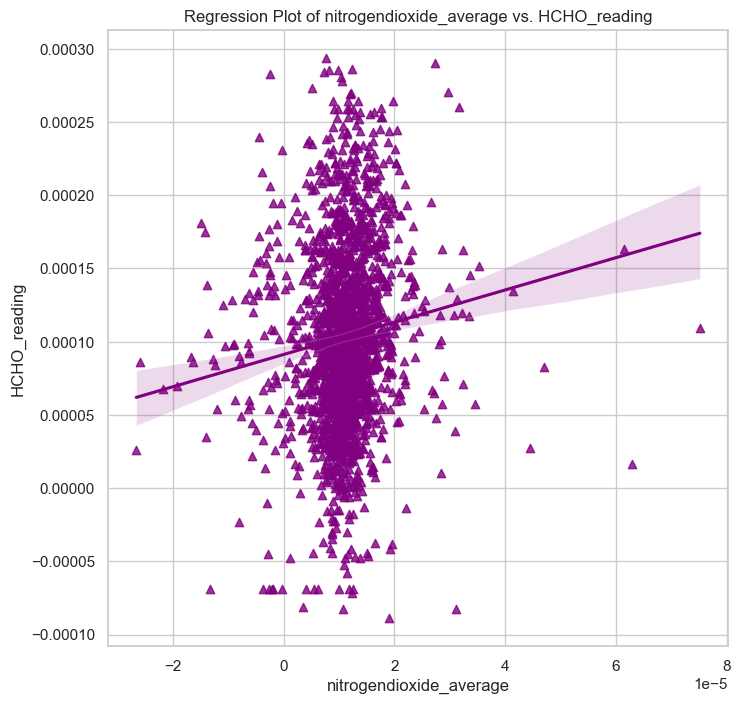

ozone_average


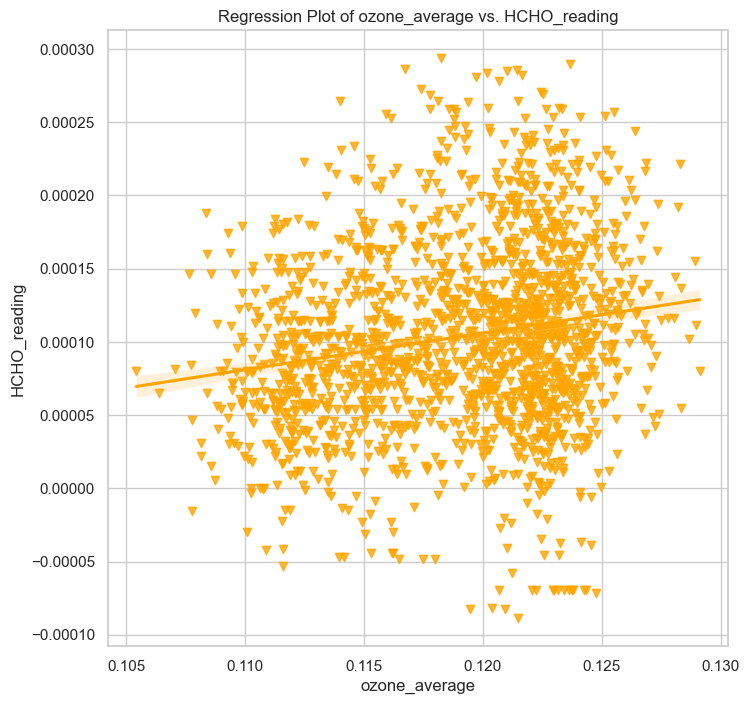

Population


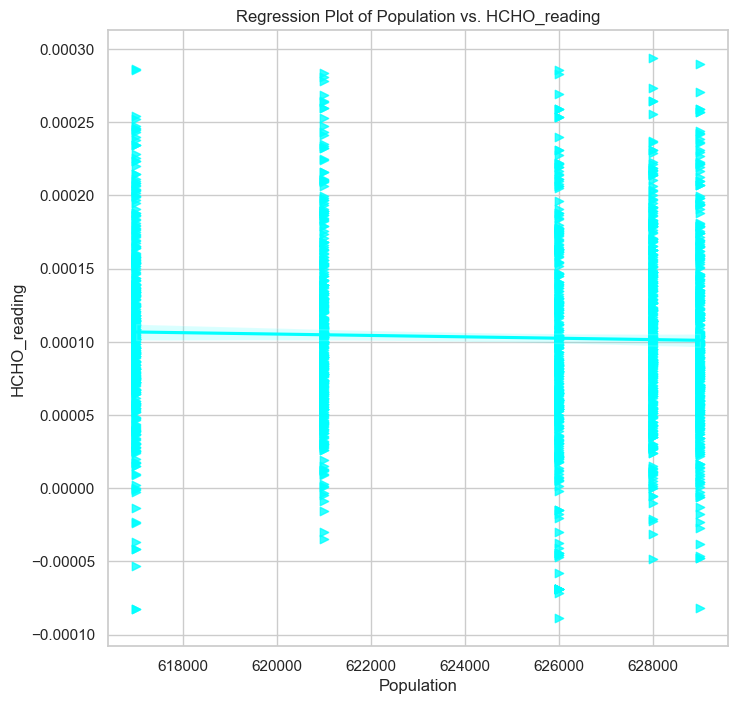

Population_density


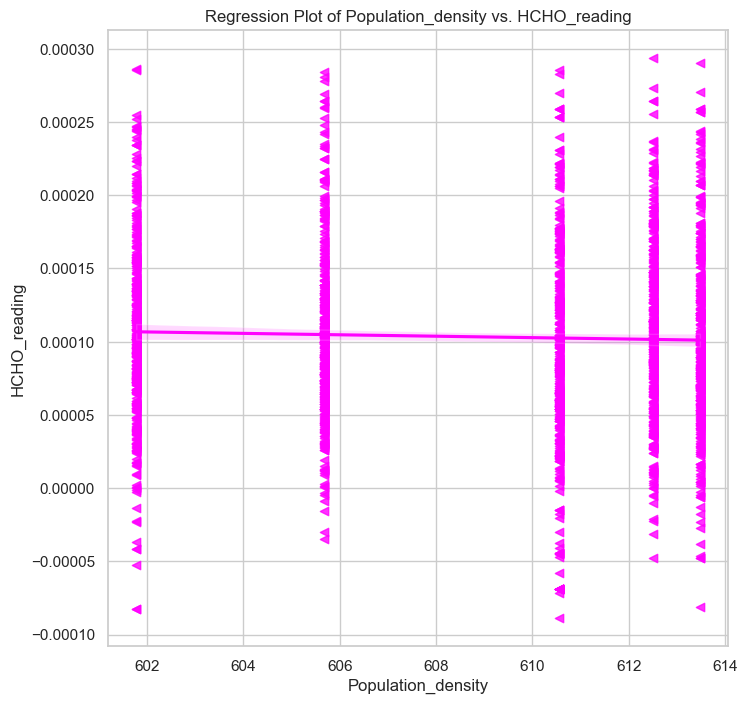

total


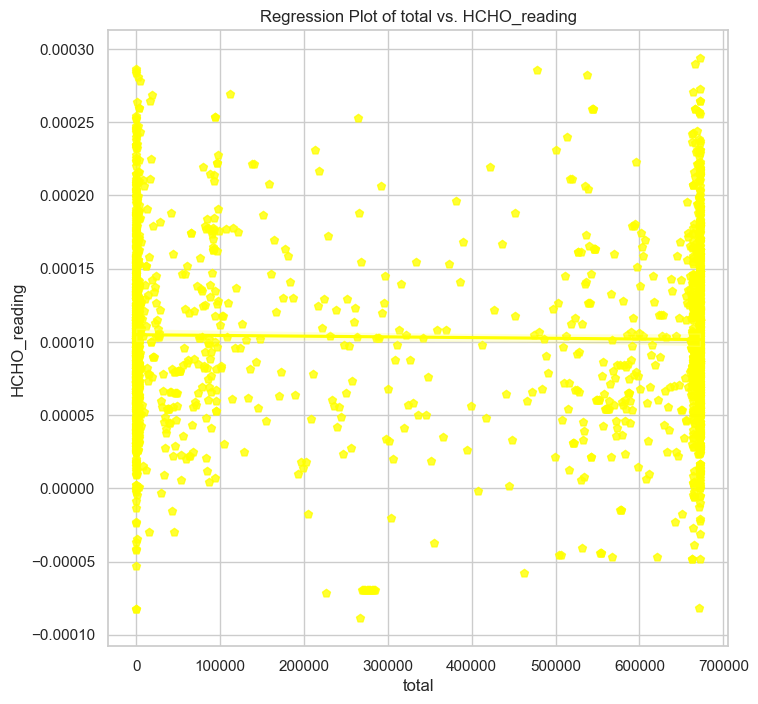

new


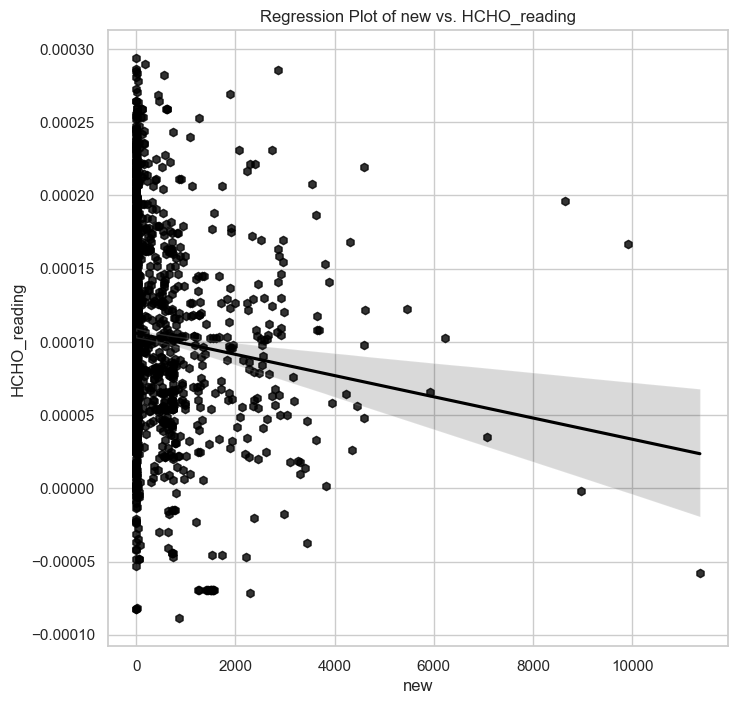

In [79]:
# Create regression plots with custom colors and markers
for i, column in enumerate(numerical_columns):
    print(column)
    plt.figure(figsize=(8, 8))
    sns.regplot(x=column, y='HCHO_reading', data=df, color=colors[i], marker=markers[i])
    plt.title(f'Regression Plot of {column} vs. HCHO_reading')
    plt.xlabel(column)
    plt.ylabel('HCHO_reading')
    plt.grid(True)
    plt.show()

# Kandy Proper

In [41]:
df=merged_df[merged_df['Location']=='Kandy Proper']
df.drop(columns=['Location','Sea Proximity Categorised', 
                 'Climate Zone','LATITUDE','LONGITUDE','ELEVATION',
                 'Area(km^2)','Sea Proximity (approximate-km)'],inplace=True)

C:\Users\janak\AppData\Local\Temp\ipykernel_6788\3658740470.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['Location','Sea Proximity Categorised',


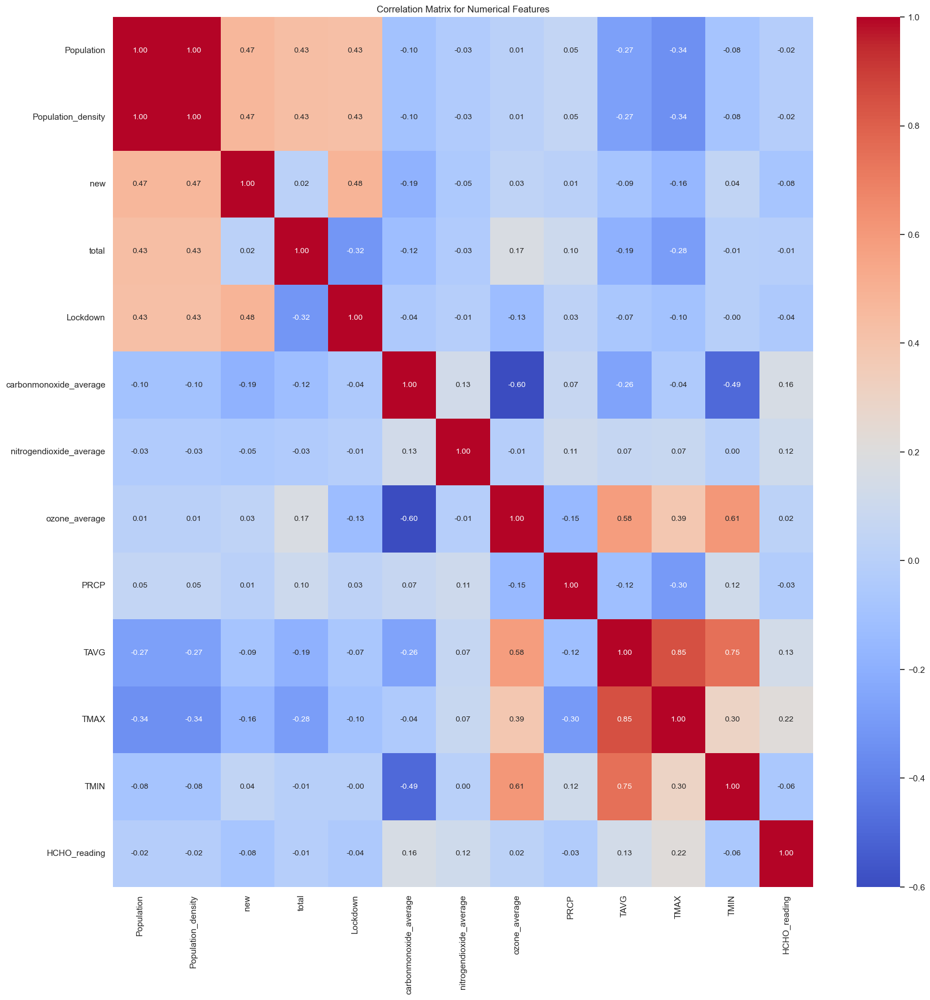

In [42]:
# Calculate the correlation matrix
correlation_matrix = df.corr(numeric_only =True)

# Plot the correlation matrix as a heatmap
plt.figure(figsize=(20, 20))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", annot_kws={"size": 10})
plt.title('Correlation Matrix for Numerical Features')
plt.show()

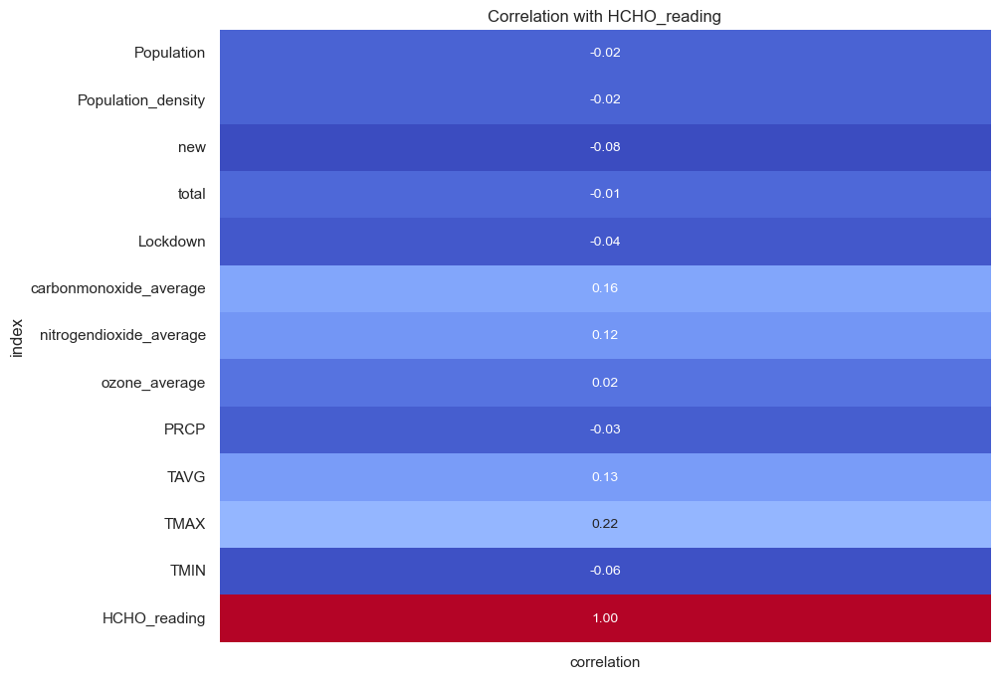

In [43]:
# Select only the correlation of numerical features with 'HCHO_reading'
correlation_with_target = correlation_matrix[['HCHO_reading']].reset_index().rename(columns={'HCHO_reading': 'correlation'})

# Plot the correlation with target as a heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_with_target.set_index('index'), cmap='coolwarm', annot=True, fmt=".2f", annot_kws={"size": 10}, cbar=False)
plt.title('Correlation with HCHO_reading')
plt.show()

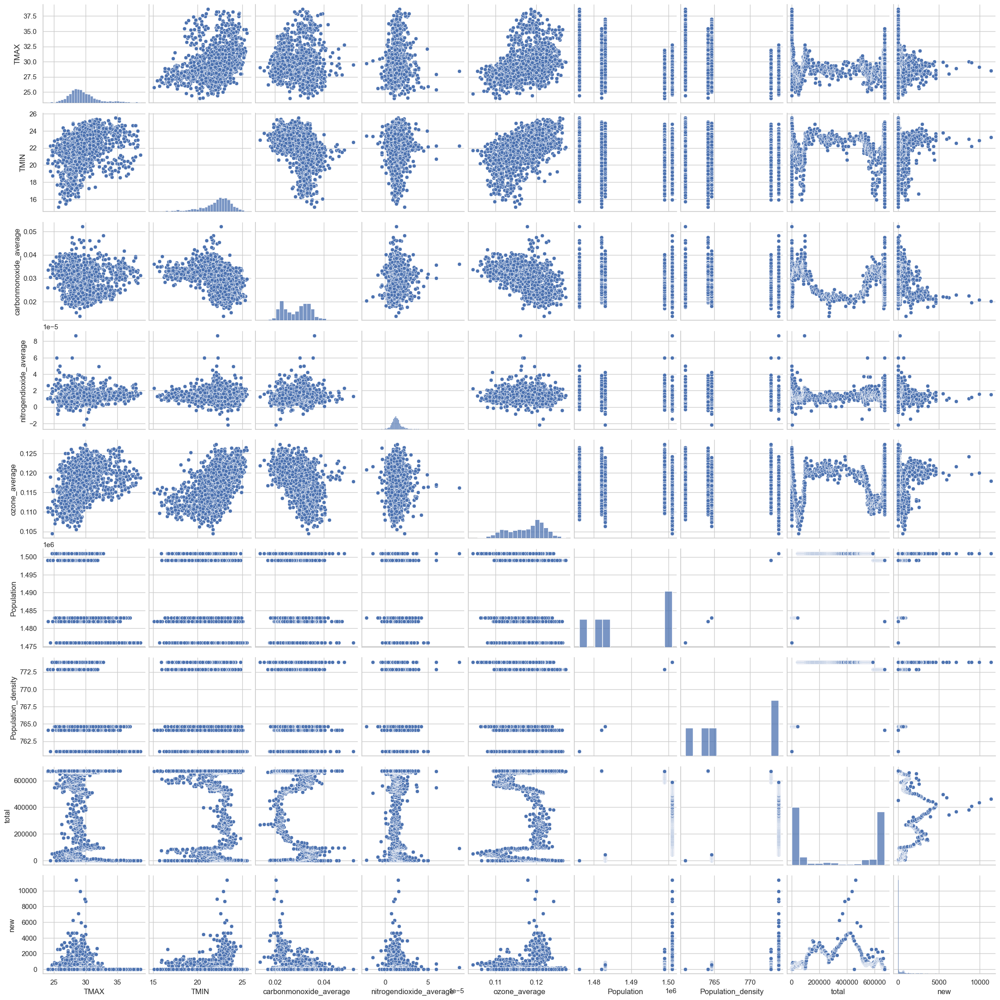

In [83]:
# Create pairplot
sns.pairplot(df[numerical_columns])
plt.show()

TMAX


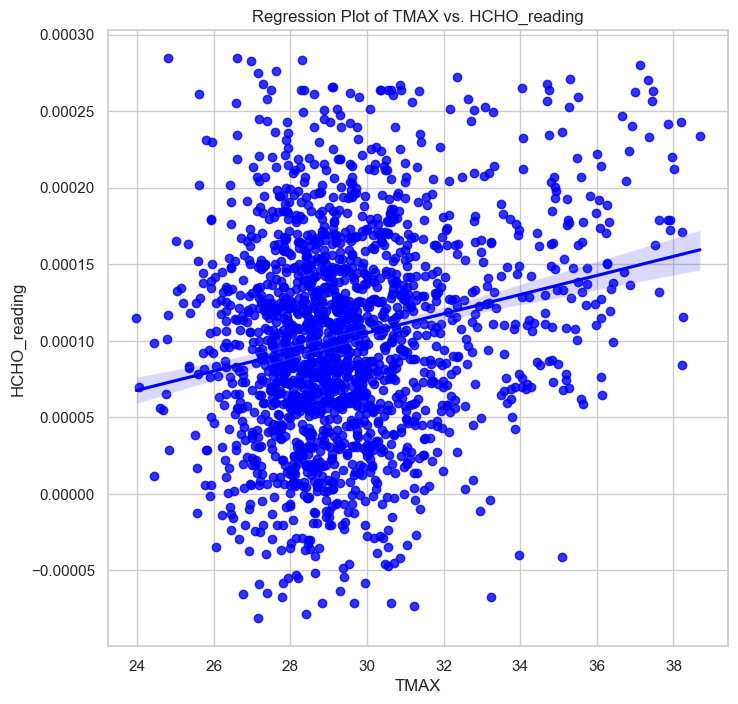

TMIN


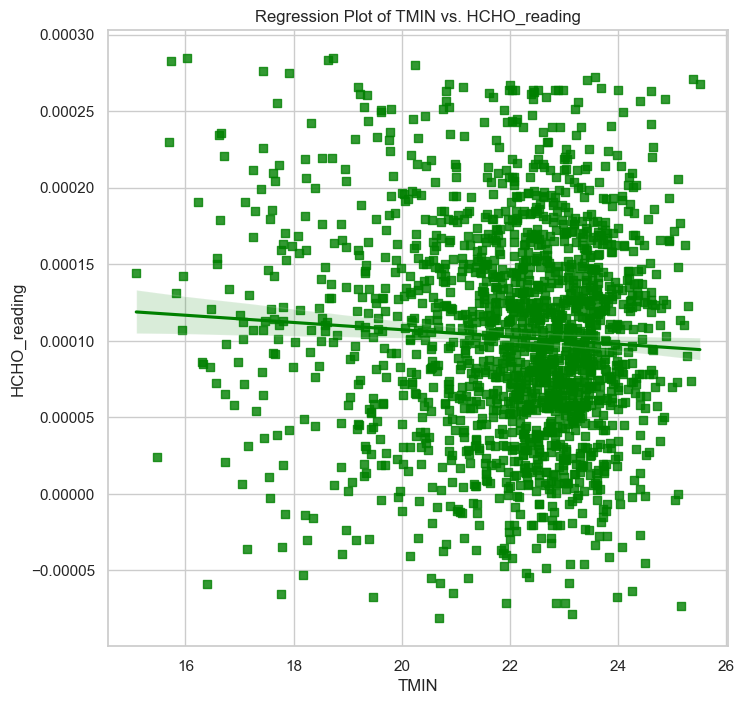

carbonmonoxide_average


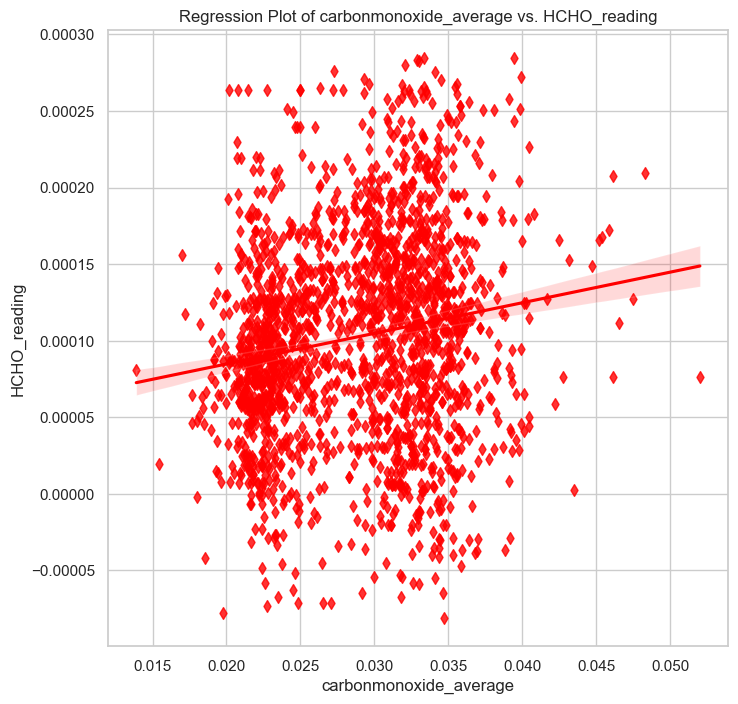

nitrogendioxide_average


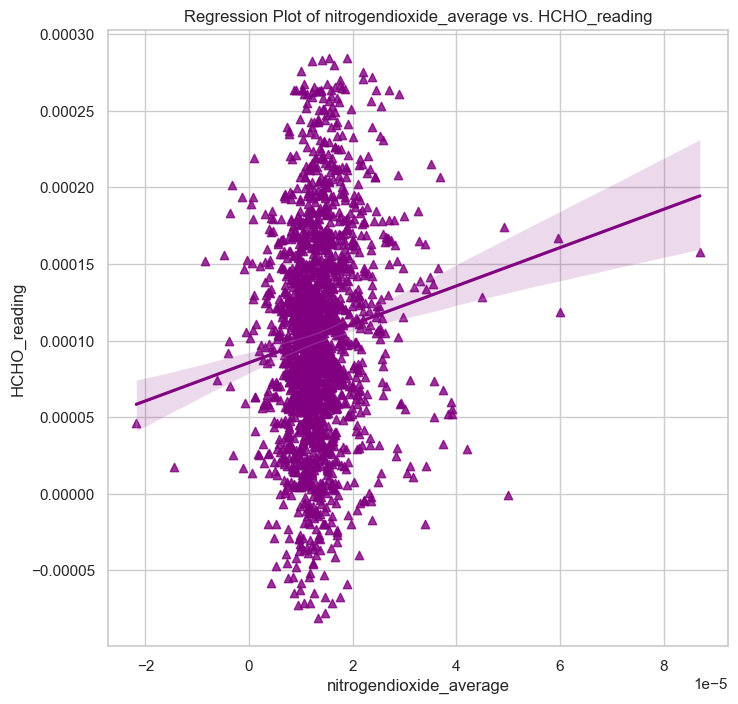

ozone_average


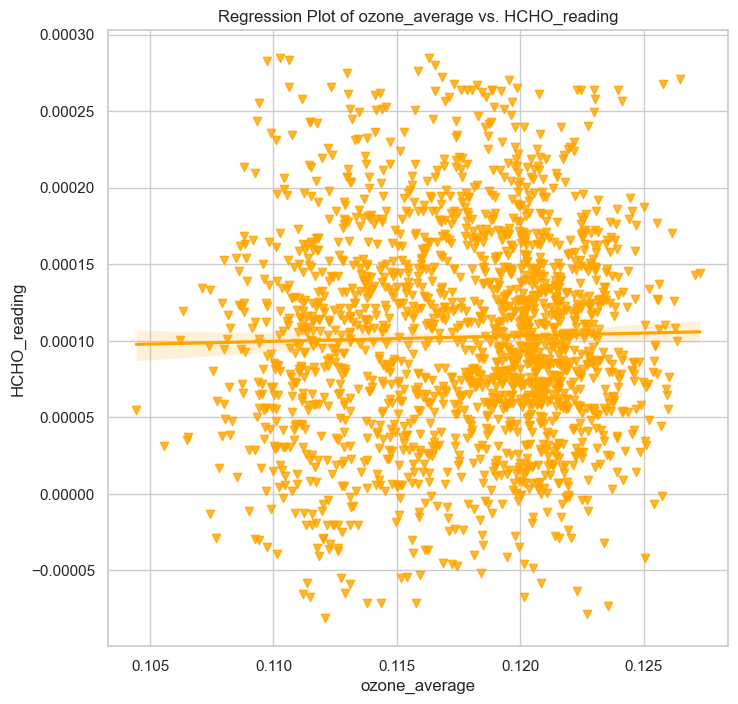

Population


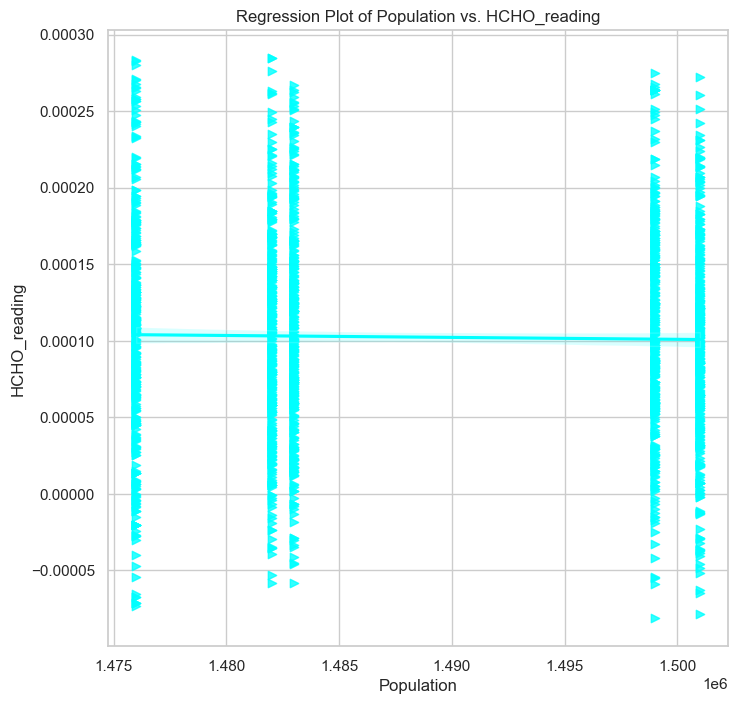

Population_density


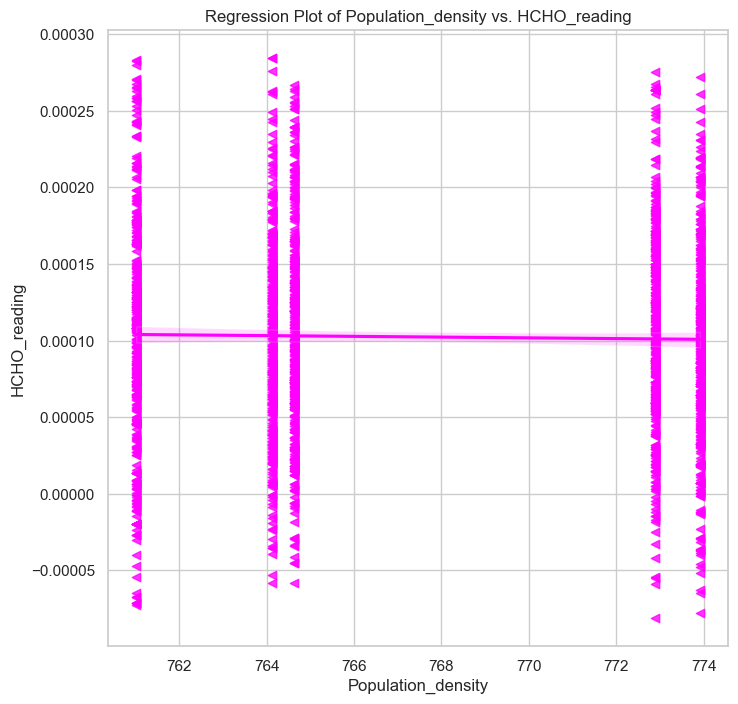

total


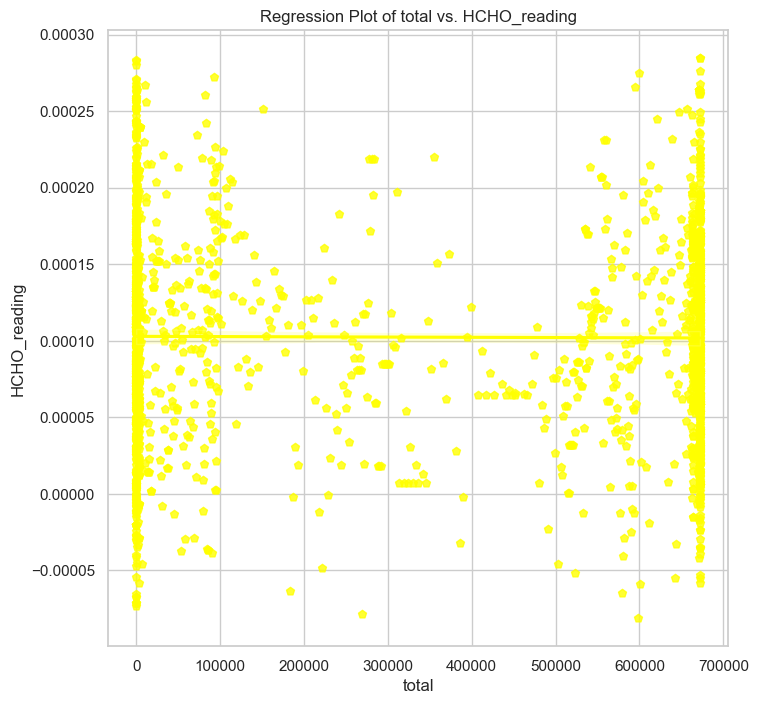

new


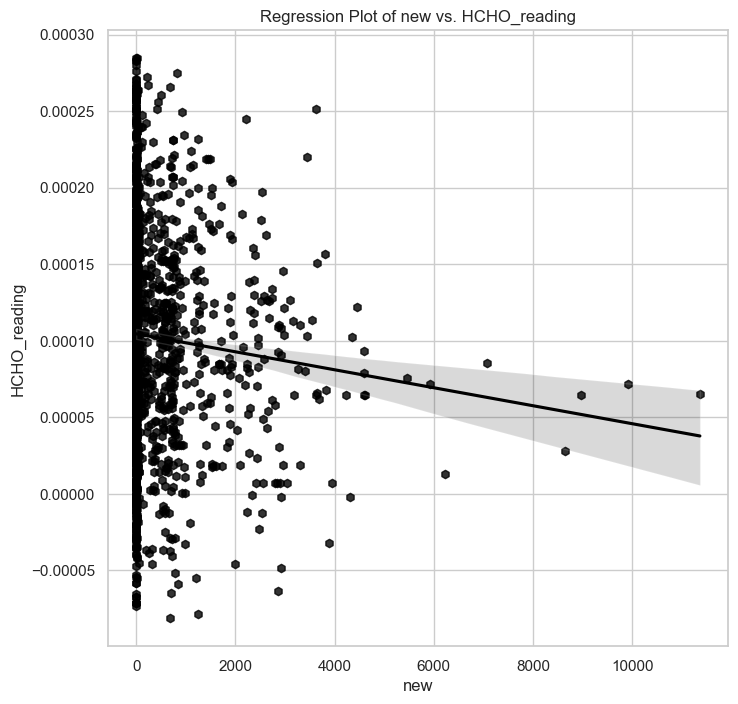

In [84]:
# Create regression plots with custom colors and markers
for i, column in enumerate(numerical_columns):
    print(column)
    plt.figure(figsize=(8, 8))
    sns.regplot(x=column, y='HCHO_reading', data=df, color=colors[i], marker=markers[i])
    plt.title(f'Regression Plot of {column} vs. HCHO_reading')
    plt.xlabel(column)
    plt.ylabel('HCHO_reading')
    plt.grid(True)
    plt.show()

# Kurunegala Proper

In [37]:
df=merged_df[merged_df['Location']=='Kurunegala Proper']
df.drop(columns=['Location','Sea Proximity Categorised', 
                 'Climate Zone','LATITUDE','LONGITUDE','ELEVATION',
                 'Area(km^2)','Sea Proximity (approximate-km)'],inplace=True)

C:\Users\janak\AppData\Local\Temp\ipykernel_6788\1833470842.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['Location','Sea Proximity Categorised',


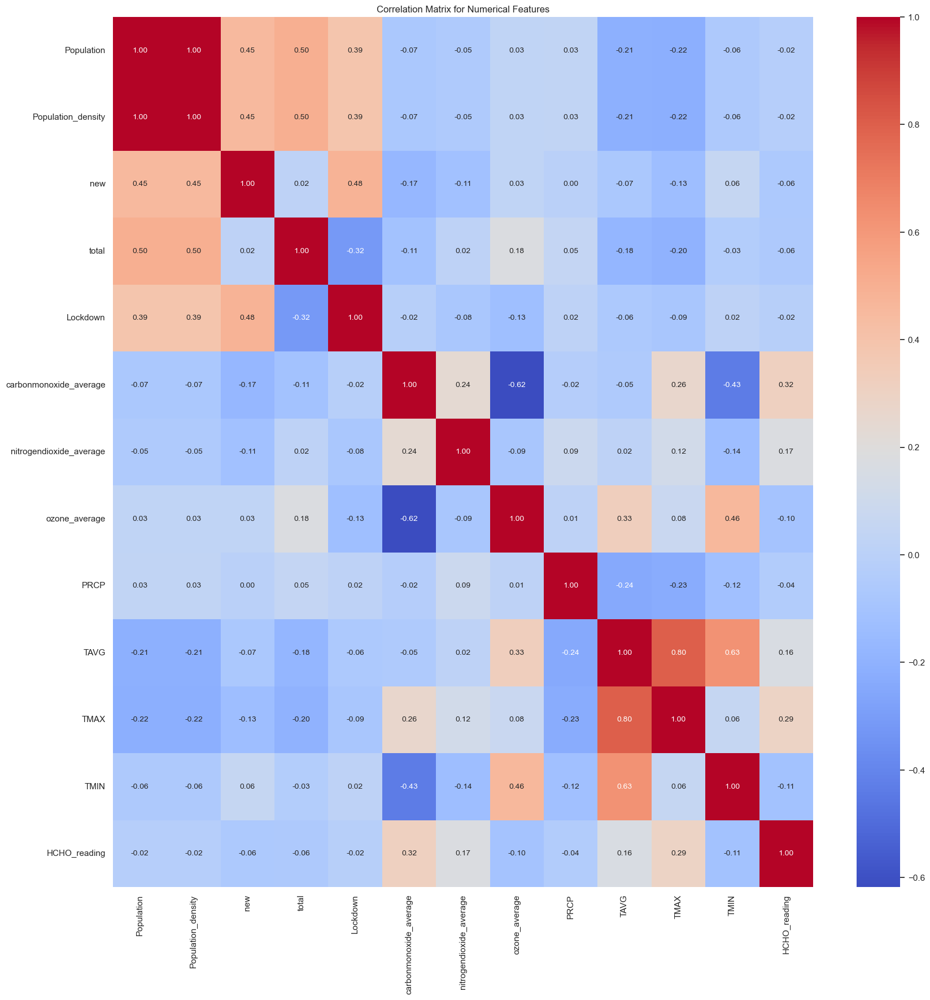

In [38]:
# Calculate the correlation matrix
correlation_matrix = df.corr(numeric_only =True)

# Plot the correlation matrix as a heatmap
plt.figure(figsize=(20, 20))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", annot_kws={"size": 10})
plt.title('Correlation Matrix for Numerical Features')
plt.show()

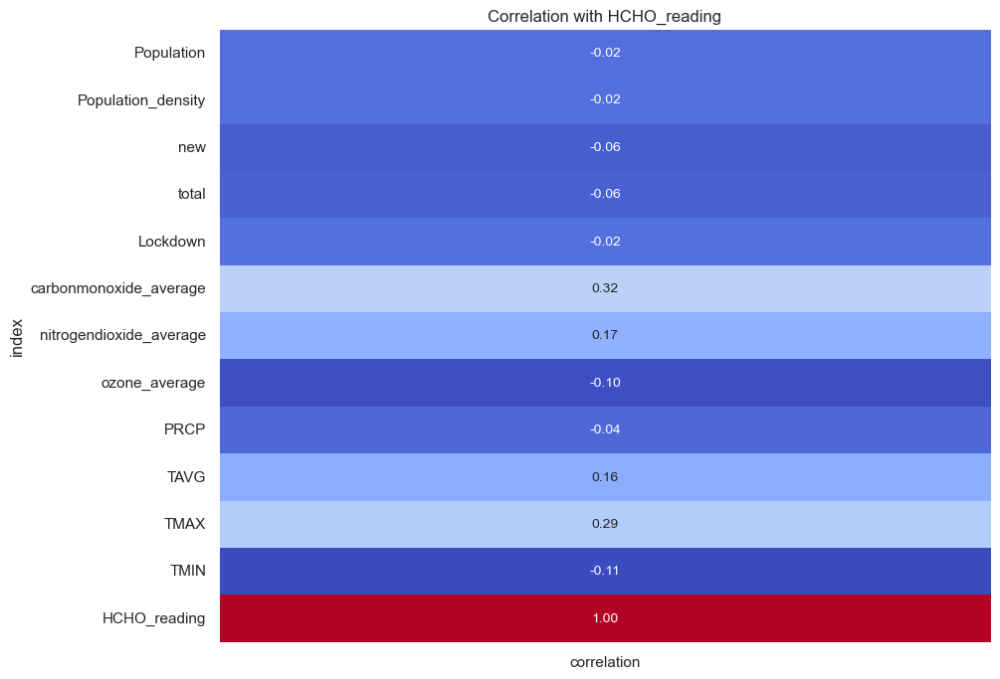

In [39]:
# Select only the correlation of numerical features with 'HCHO_reading'
correlation_with_target = correlation_matrix[['HCHO_reading']].reset_index().rename(columns={'HCHO_reading': 'correlation'})

# Plot the correlation with target as a heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_with_target.set_index('index'), cmap='coolwarm', annot=True, fmt=".2f", annot_kws={"size": 10}, cbar=False)
plt.title('Correlation with HCHO_reading')
plt.show()

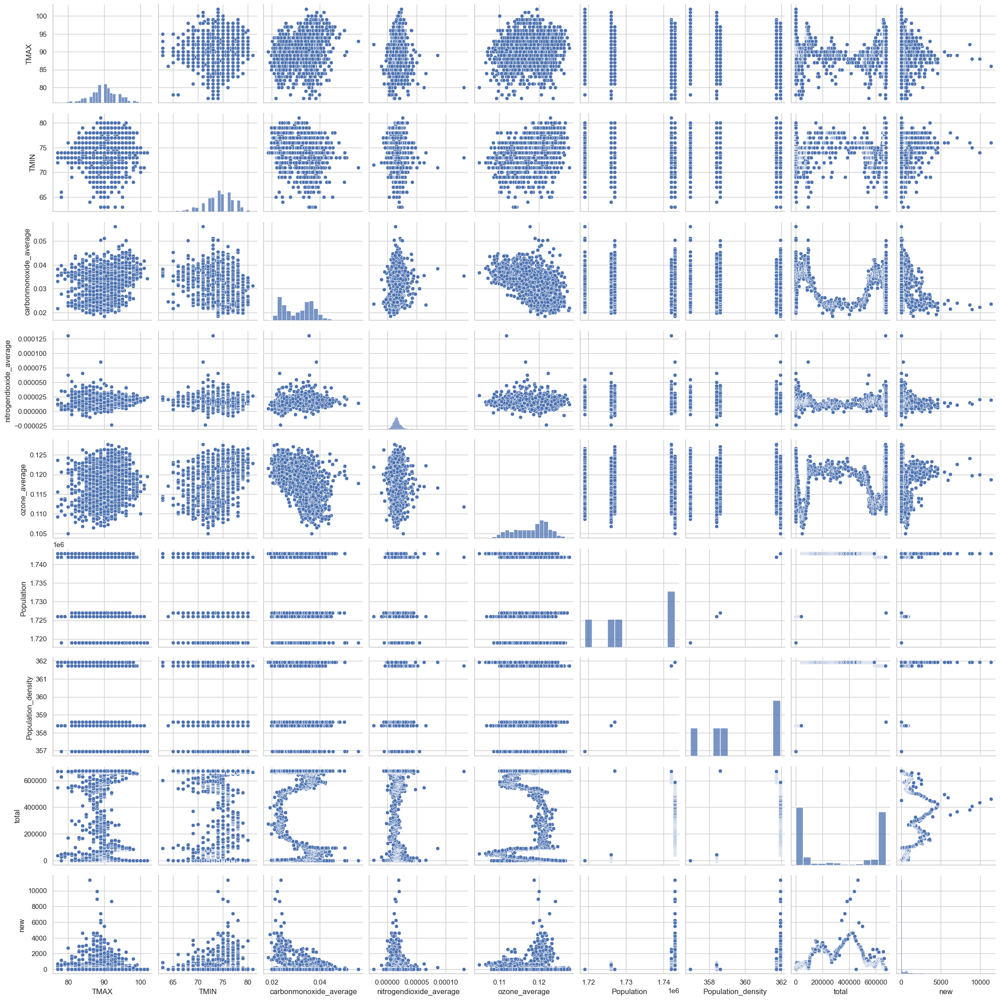

In [88]:
# Create pairplot
sns.pairplot(df[numerical_columns])
plt.show()

TMAX


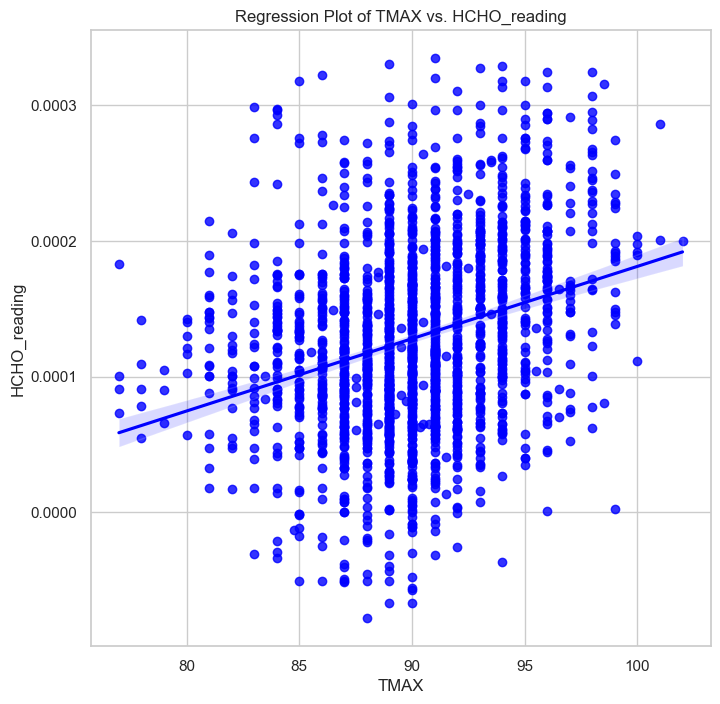

TMIN


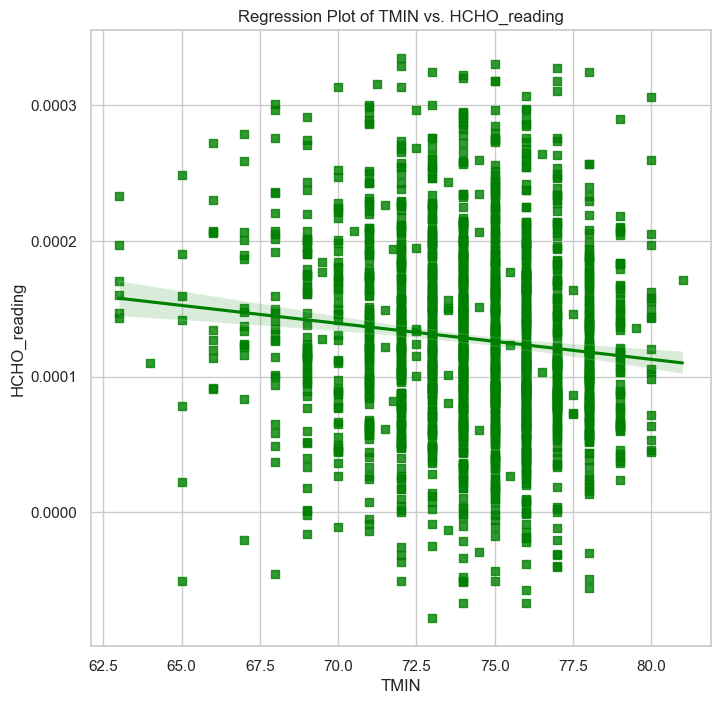

carbonmonoxide_average


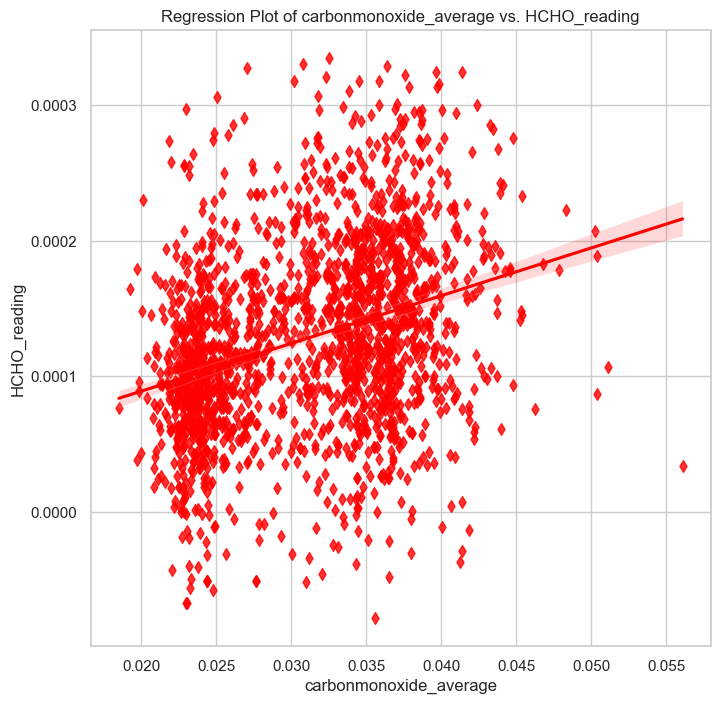

nitrogendioxide_average


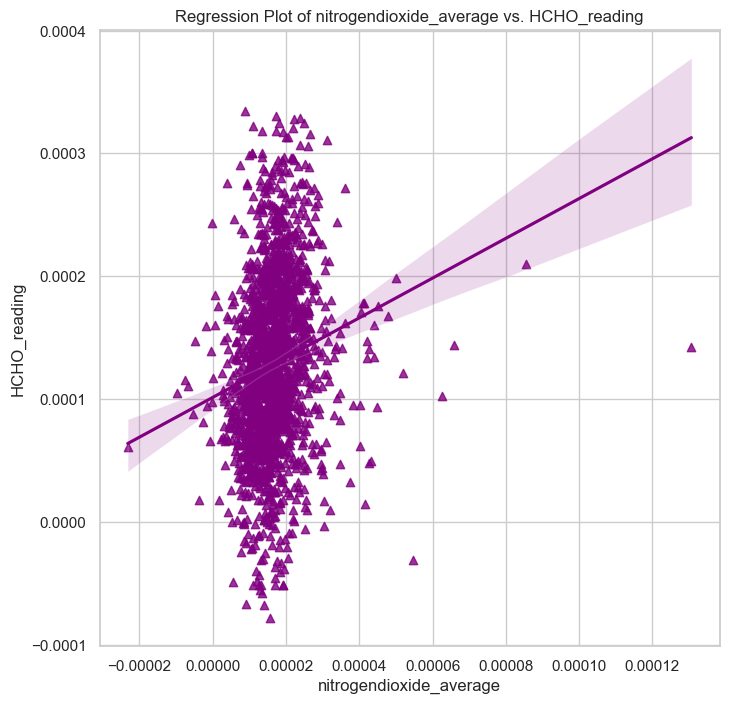

ozone_average


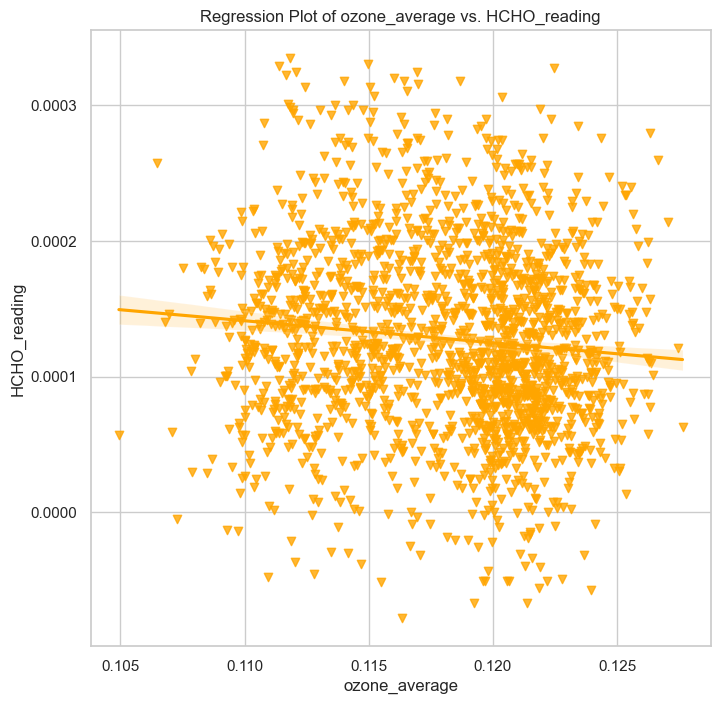

Population


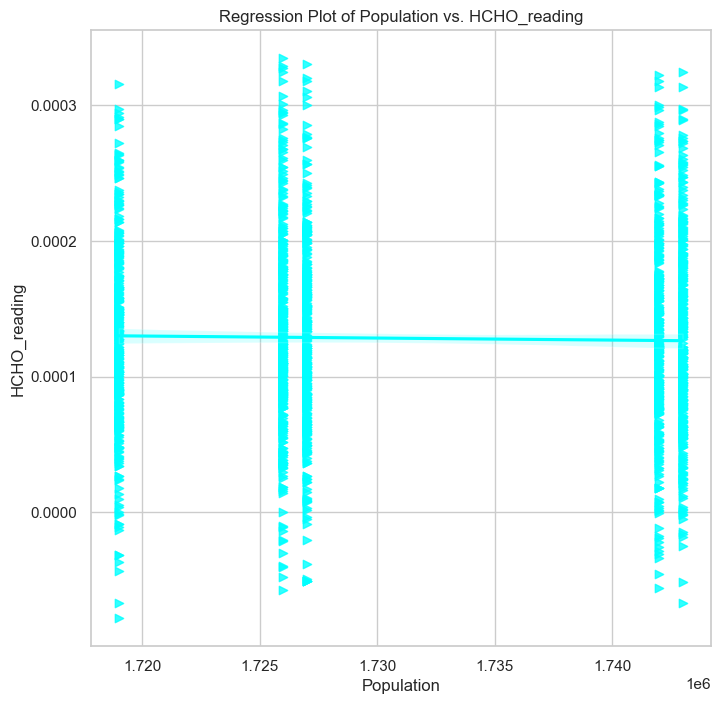

Population_density


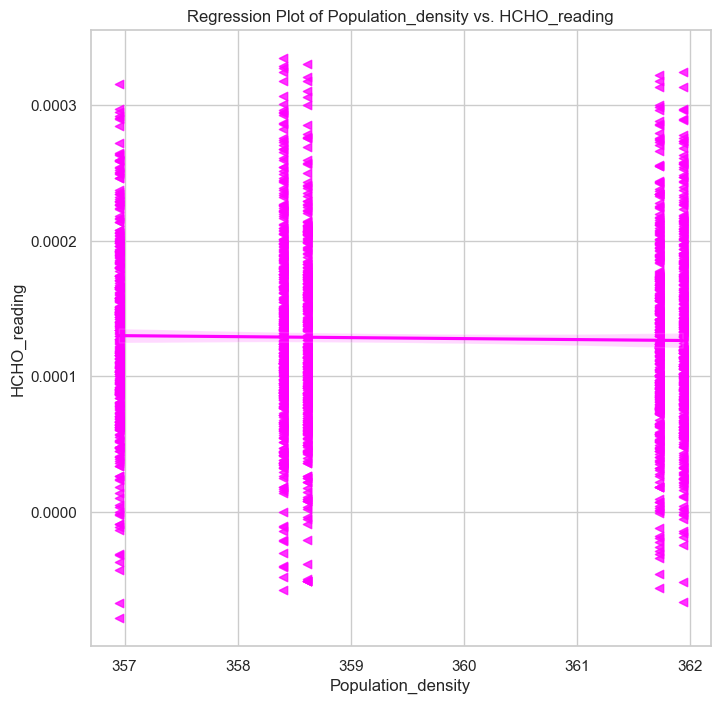

total


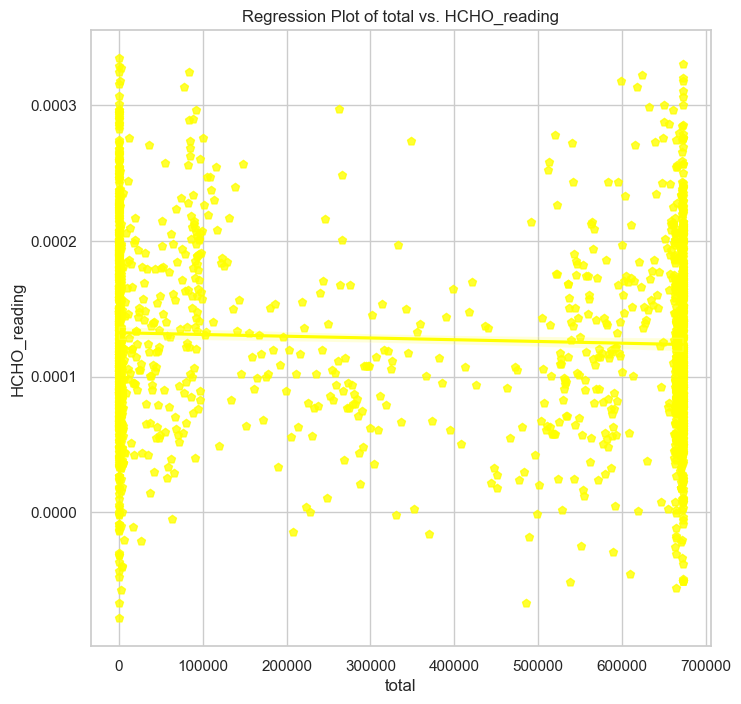

new


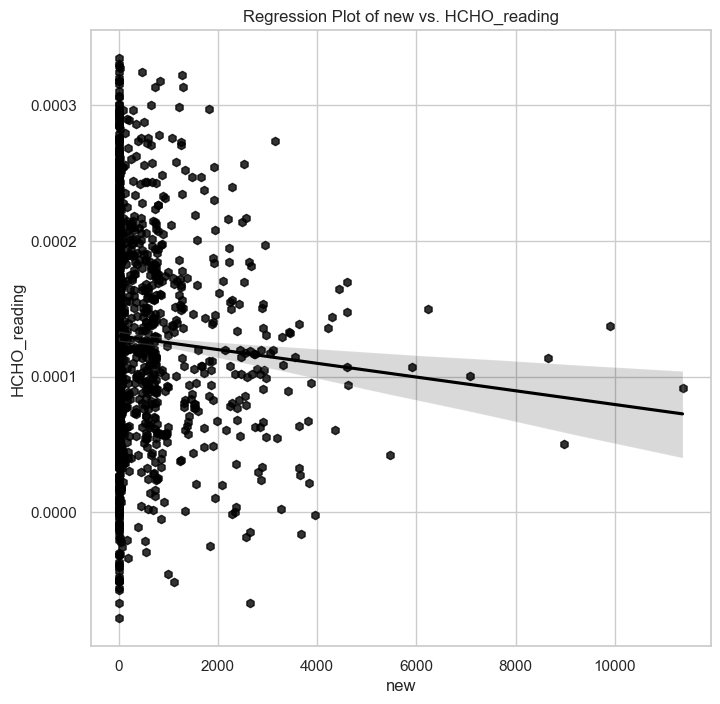

In [89]:
# Create regression plots with custom colors and markers
for i, column in enumerate(numerical_columns):
    print(column)
    plt.figure(figsize=(8, 8))
    sns.regplot(x=column, y='HCHO_reading', data=df, color=colors[i], marker=markers[i])
    plt.title(f'Regression Plot of {column} vs. HCHO_reading')
    plt.xlabel(column)
    plt.ylabel('HCHO_reading')
    plt.grid(True)
    plt.show()

# Nuwara Eliya Proper

In [53]:
df=merged_df[merged_df['Location']=='Nuwara Eliya Proper']
df.drop(columns=['Location','Sea Proximity Categorised', 
                 'Climate Zone','LATITUDE','LONGITUDE','ELEVATION',
                 'Area(km^2)','Sea Proximity (approximate-km)'],inplace=True)

C:\Users\janak\AppData\Local\Temp\ipykernel_6788\2036201062.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['Location','Sea Proximity Categorised',


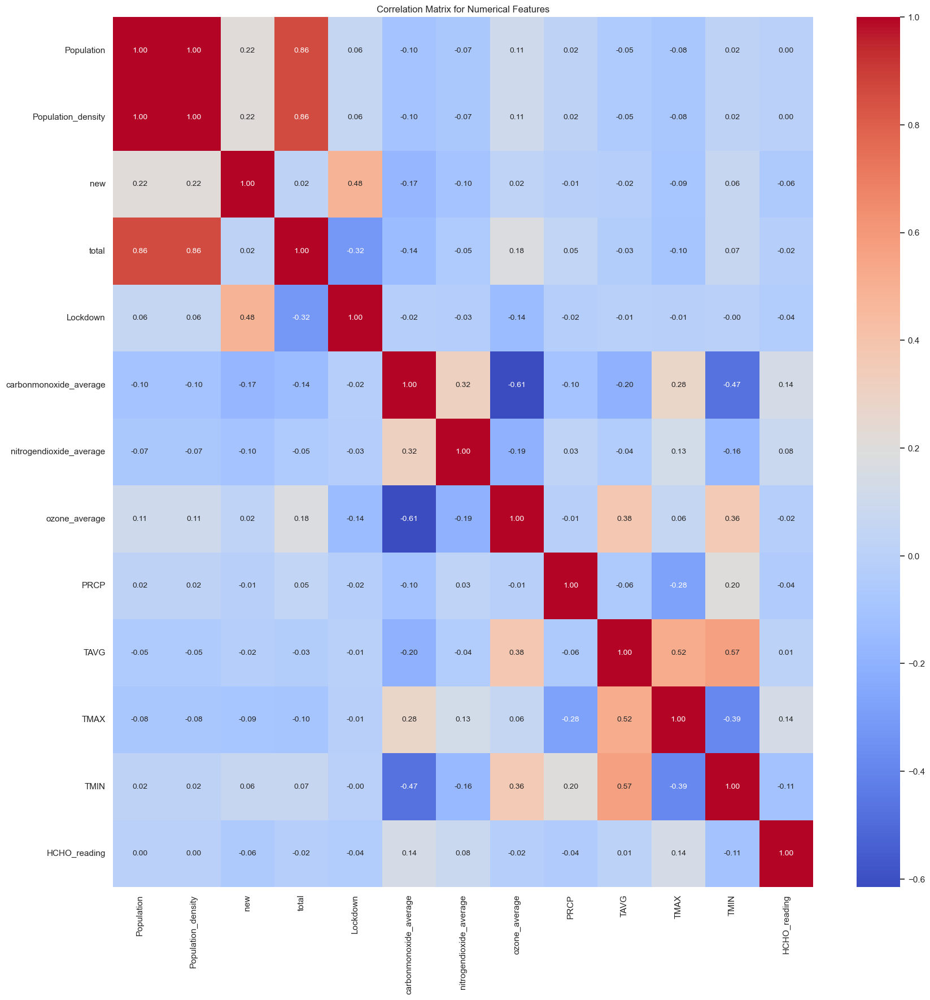

In [54]:
# Calculate the correlation matrix
correlation_matrix = df.corr(numeric_only =True)

# Plot the correlation matrix as a heatmap
plt.figure(figsize=(20, 20))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", annot_kws={"size": 10})
plt.title('Correlation Matrix for Numerical Features')
plt.show()

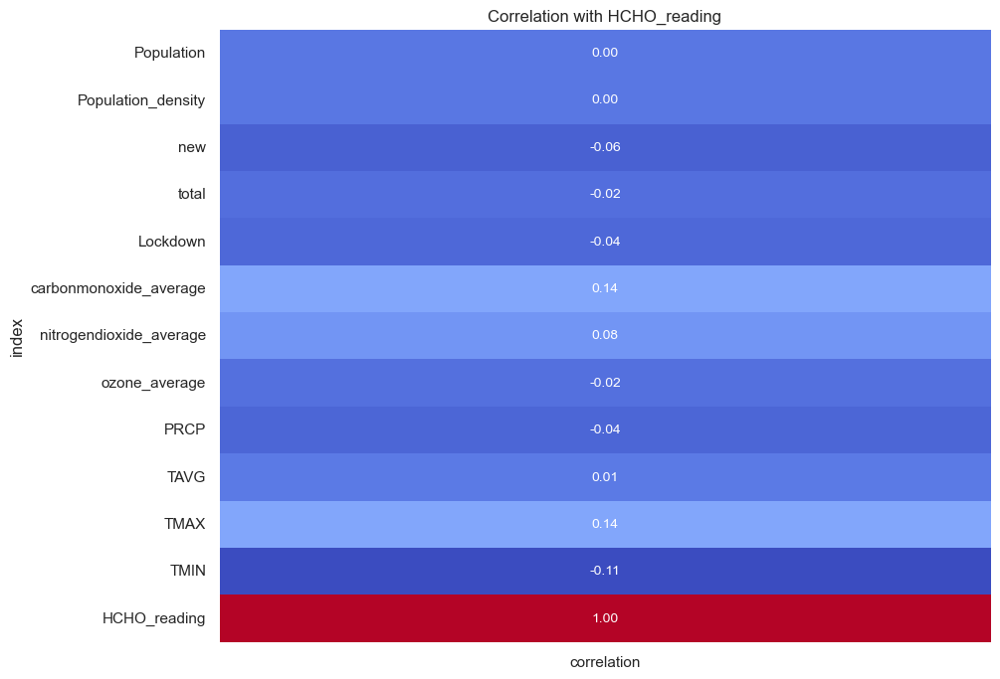

In [55]:
# Select only the correlation of numerical features with 'HCHO_reading'
correlation_with_target = correlation_matrix[['HCHO_reading']].reset_index().rename(columns={'HCHO_reading': 'correlation'})

# Plot the correlation with target as a heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_with_target.set_index('index'), cmap='coolwarm', annot=True, fmt=".2f", annot_kws={"size": 10}, cbar=False)
plt.title('Correlation with HCHO_reading')
plt.show()

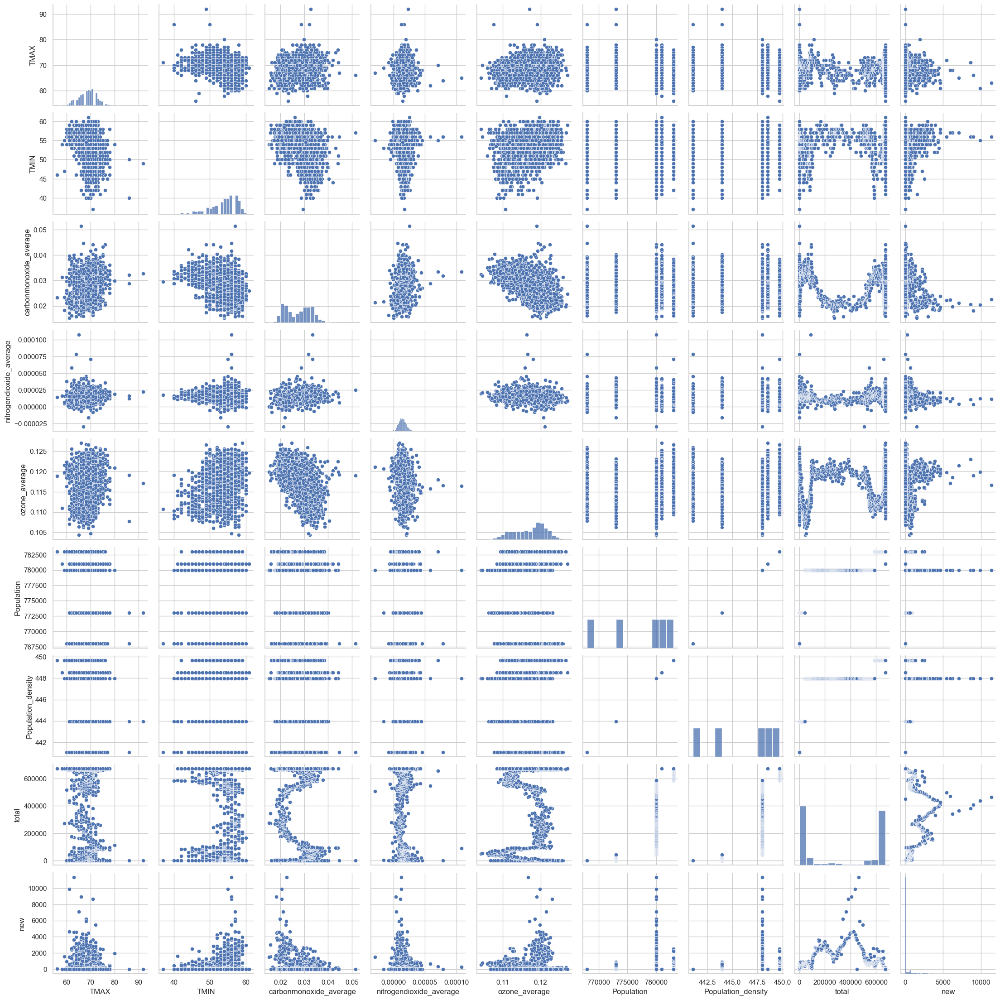

In [93]:
# Create pairplot
sns.pairplot(df[numerical_columns])
plt.show()

TMAX


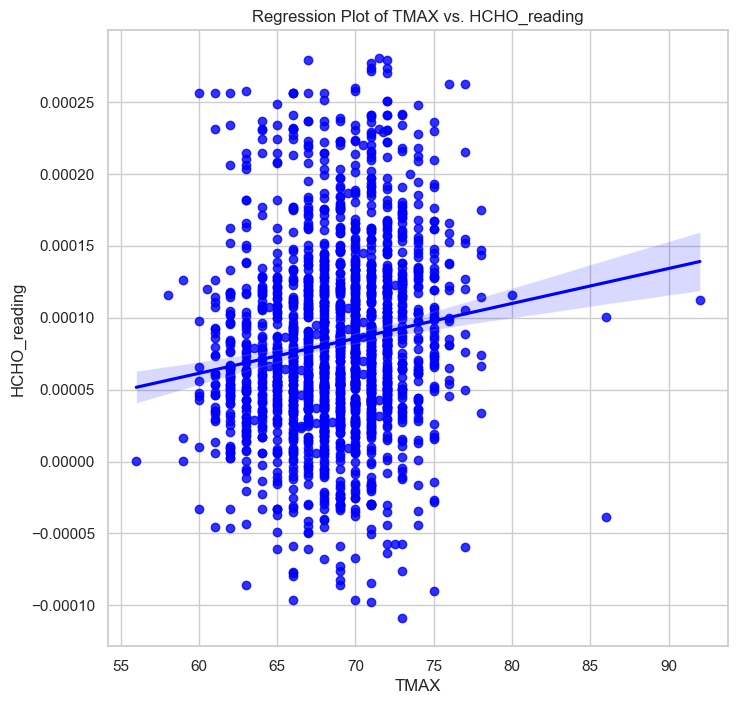

TMIN


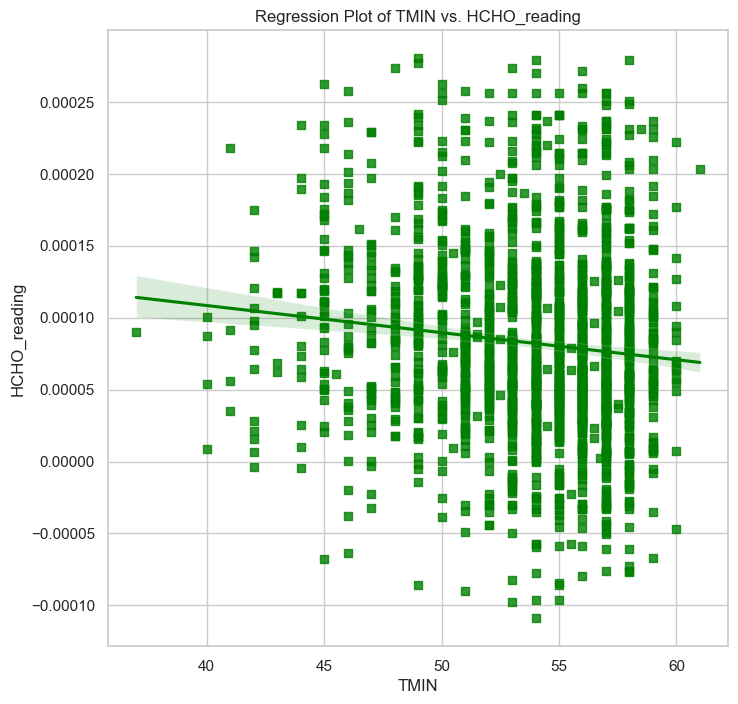

carbonmonoxide_average


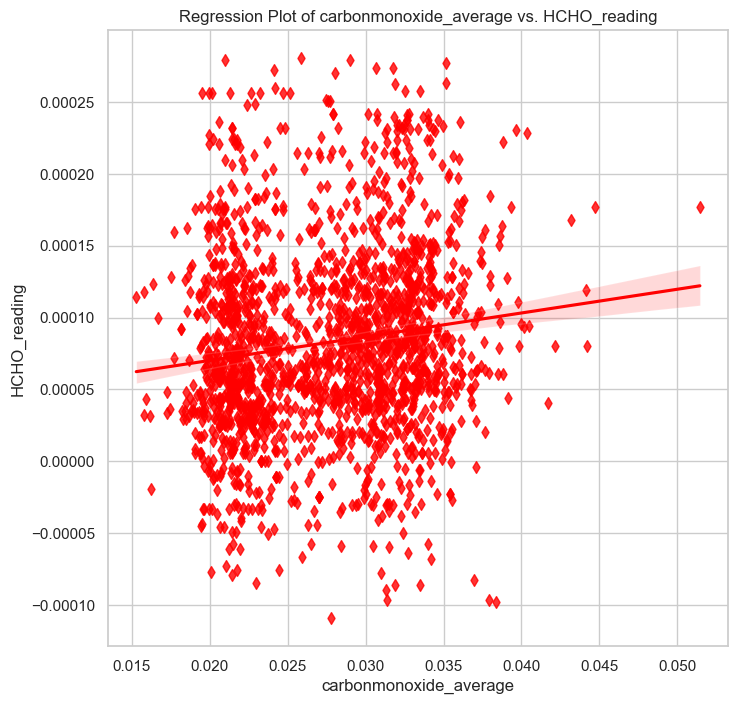

nitrogendioxide_average


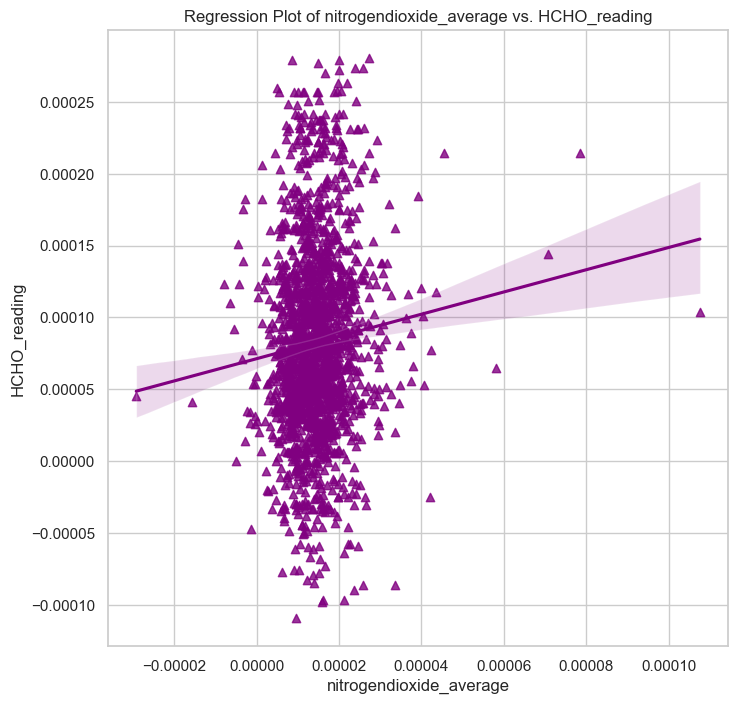

ozone_average


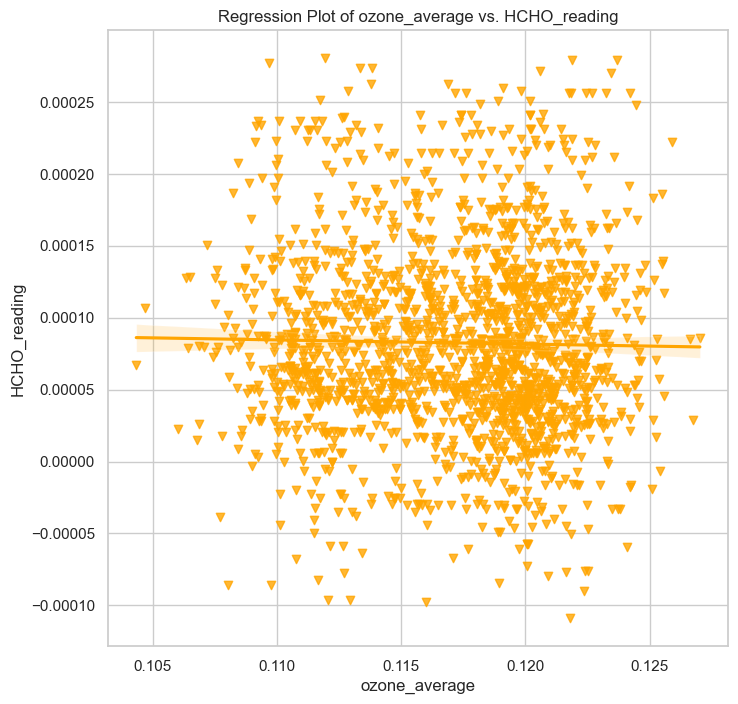

Population


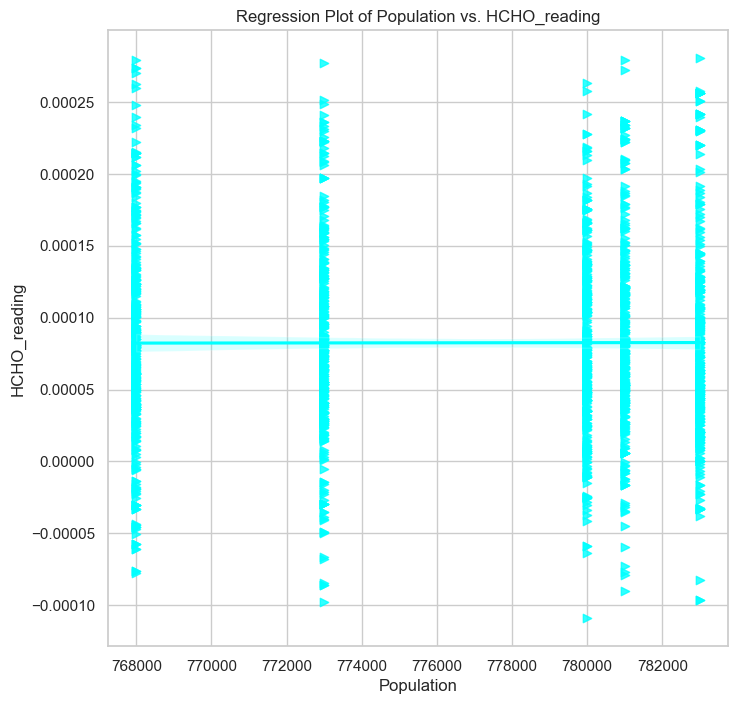

Population_density


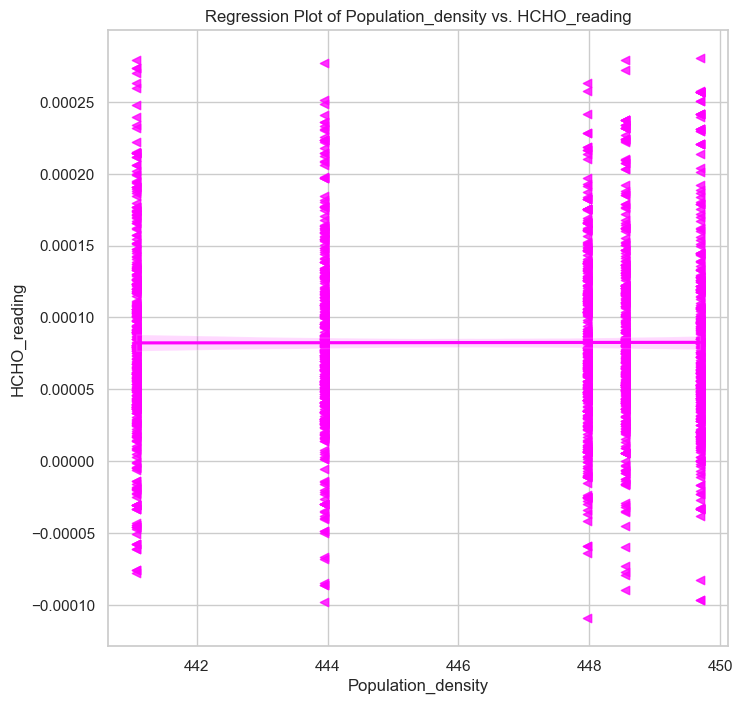

total


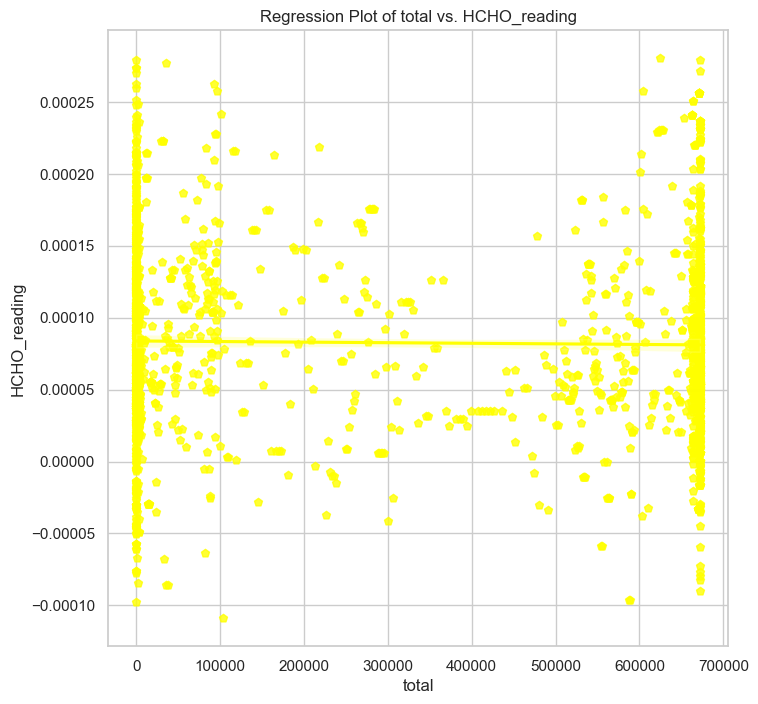

new


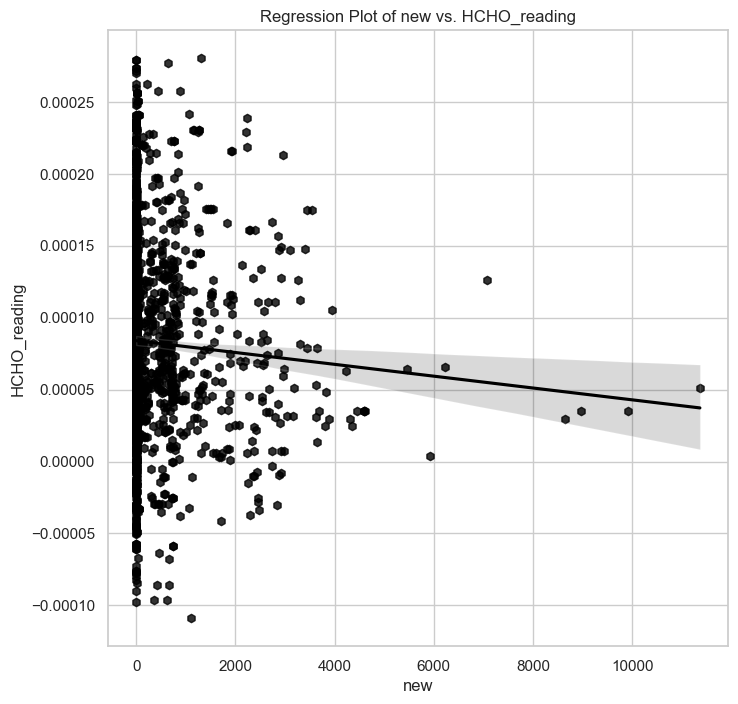

In [94]:
# Create regression plots with custom colors and markers
for i, column in enumerate(numerical_columns):
    print(column)
    plt.figure(figsize=(8, 8))
    sns.regplot(x=column, y='HCHO_reading', data=df, color=colors[i], marker=markers[i])
    plt.title(f'Regression Plot of {column} vs. HCHO_reading')
    plt.xlabel(column)
    plt.ylabel('HCHO_reading')
    plt.grid(True)
    plt.show()

In [ ]:
df.columns

# Rolling Means analysis

Bibile, Monaragala


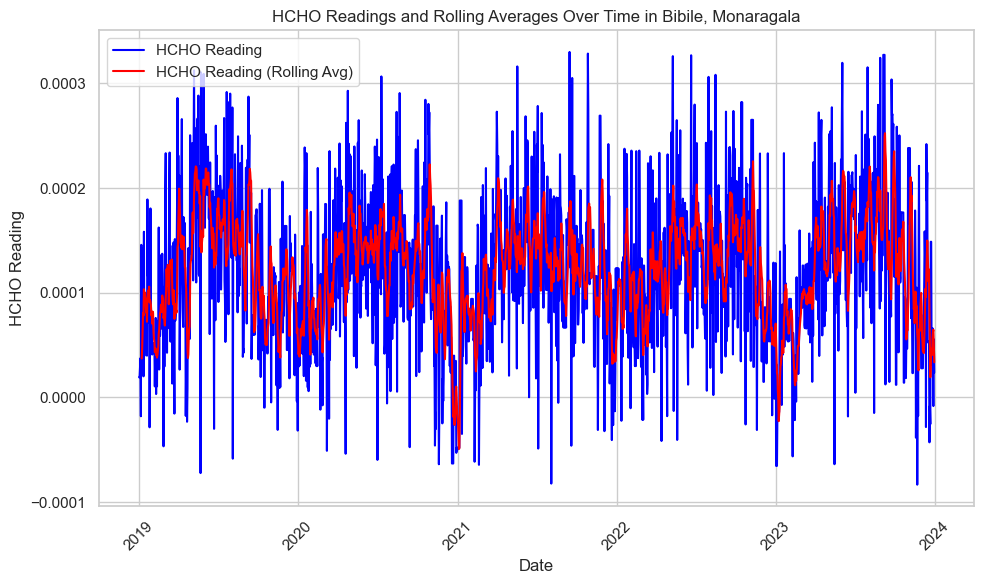

Colombo Proper


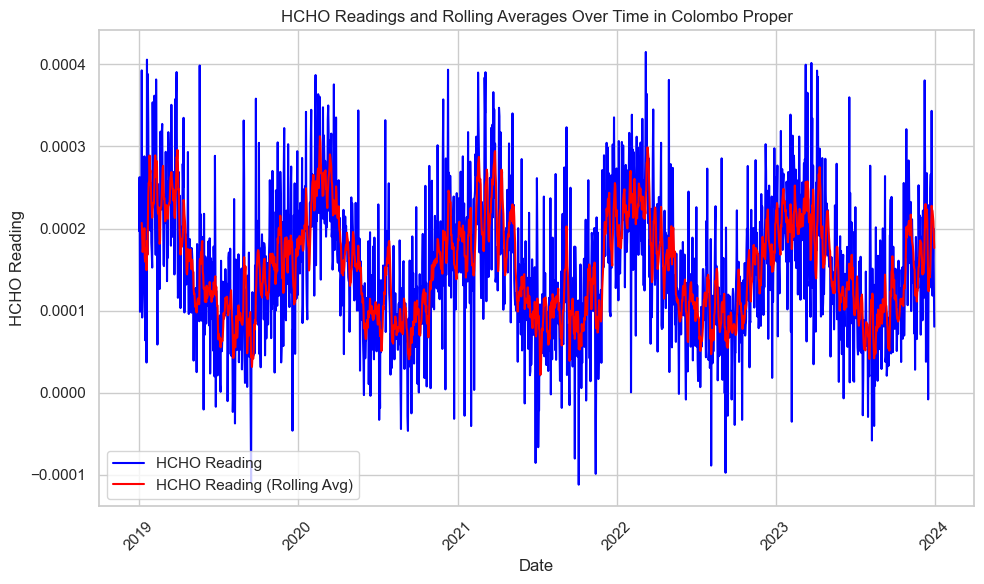

Deniyaya, Matara


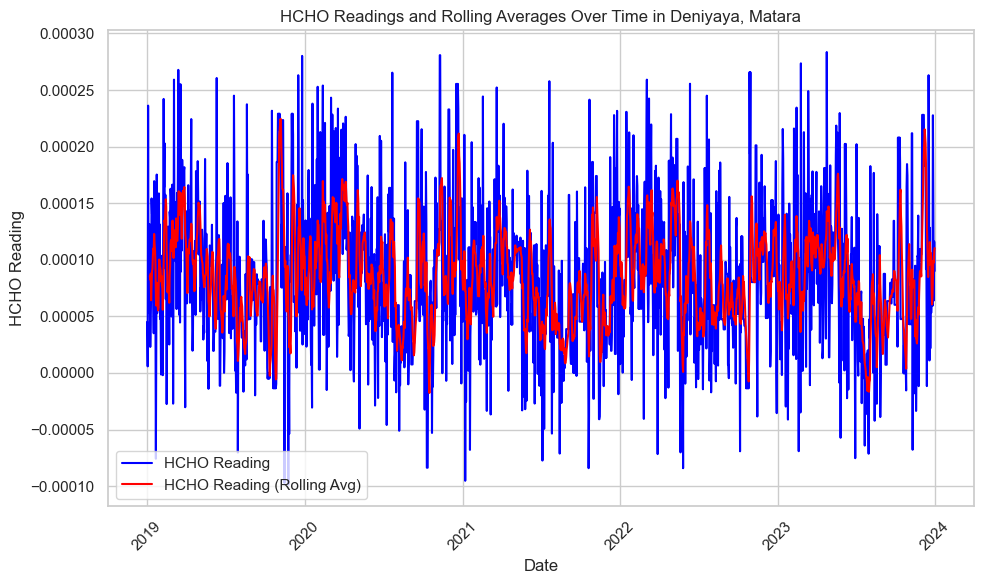

Jaffna Proper


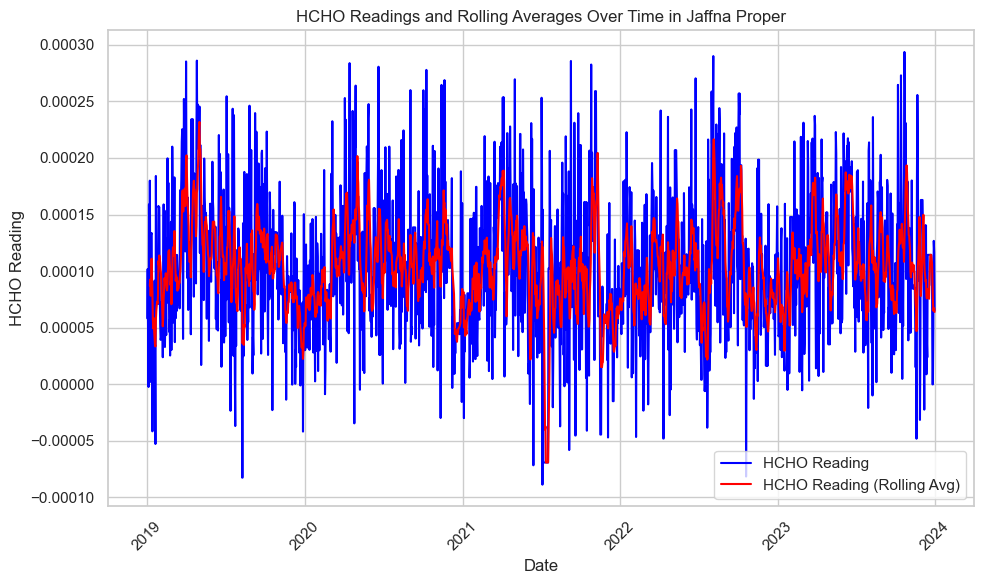

Kandy Proper


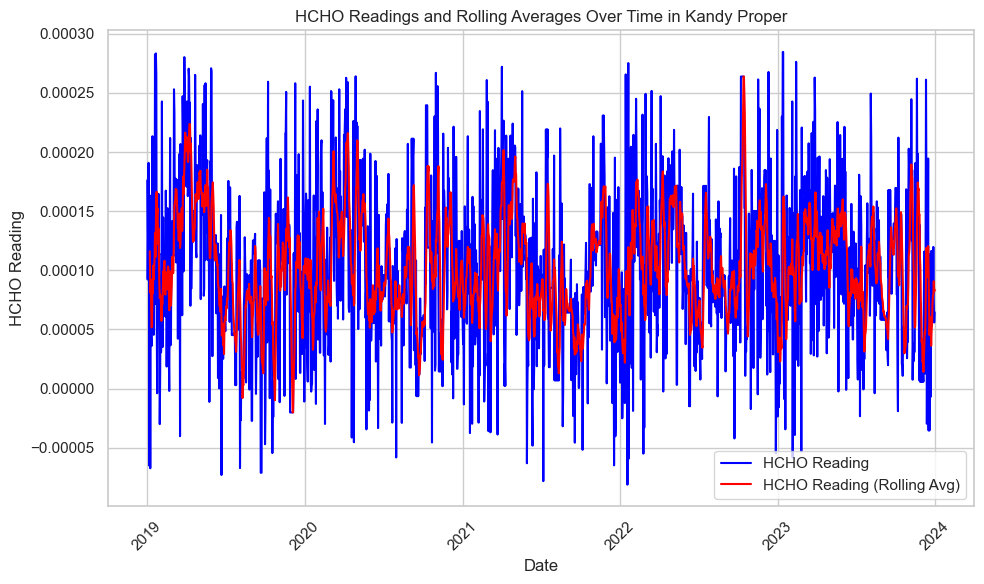

Kurunegala Proper


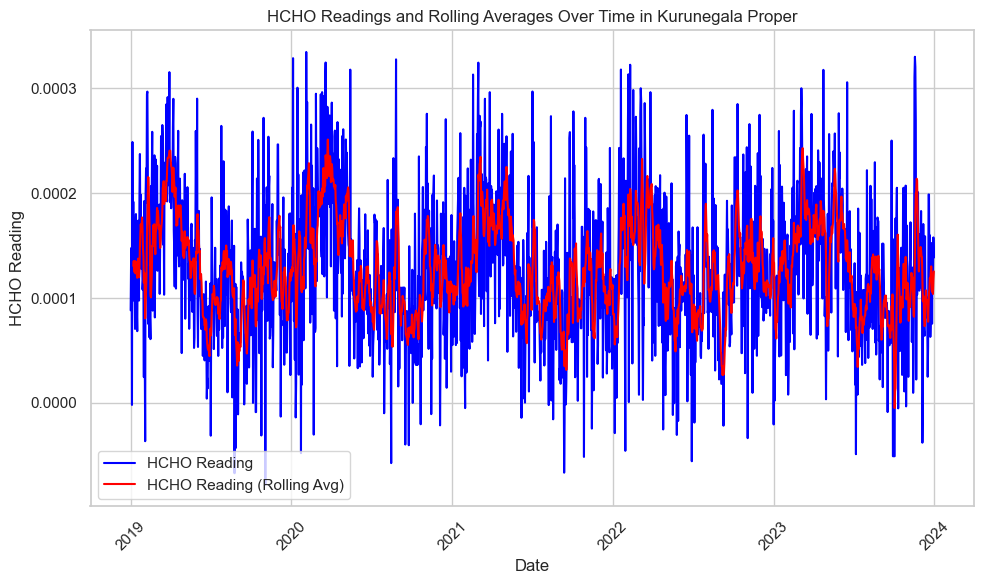

Nuwara Eliya Proper


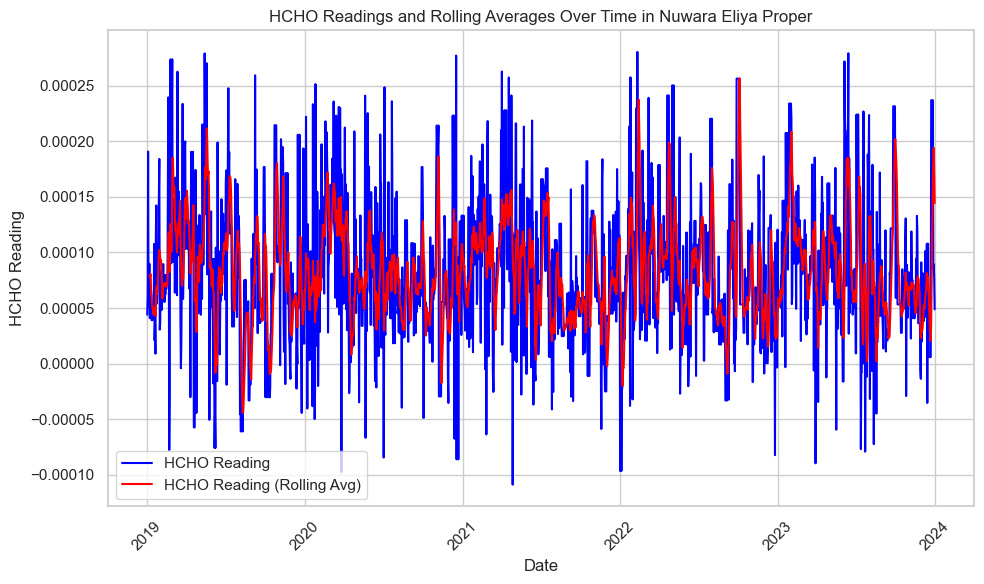

In [52]:
# Function to visualize HCHO readings and daily new COVID-19 cases for each location
def visualize_location(location):
    print(location)
    location_data = merged_df[merged_df['Location'] == location].copy()

    plt.figure(figsize=(10, 6))

    # Time Series Plot with Rolling Averages
    plt.plot(location_data['Current_Date'], location_data['HCHO_reading'], label='HCHO Reading', color='blue')
    rolling_window = 7  # 7-day rolling average
    location_data['HCHO_reading_rolling'] = location_data['HCHO_reading'].rolling(window=rolling_window).mean()
    plt.plot(location_data['Current_Date'], location_data['HCHO_reading_rolling'], label='HCHO Reading (Rolling Avg)', color='red')
    
    plt.title(f'HCHO Readings and Rolling Averages Over Time in {location}')
    plt.xlabel('Date')
    plt.ylabel('HCHO Reading')
    plt.legend()
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

# Visualize each location separately
locations = merged_df['Location'].unique()
for location in locations:
    visualize_location(location)

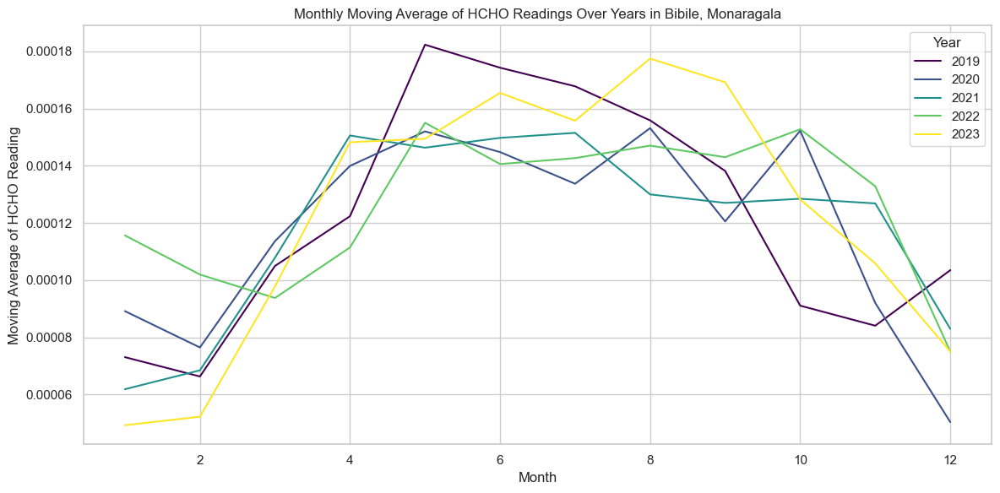

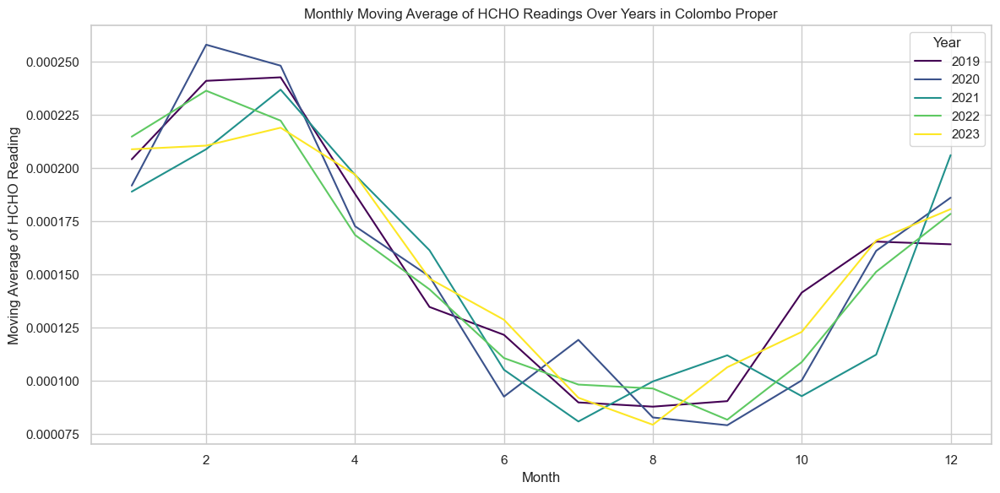

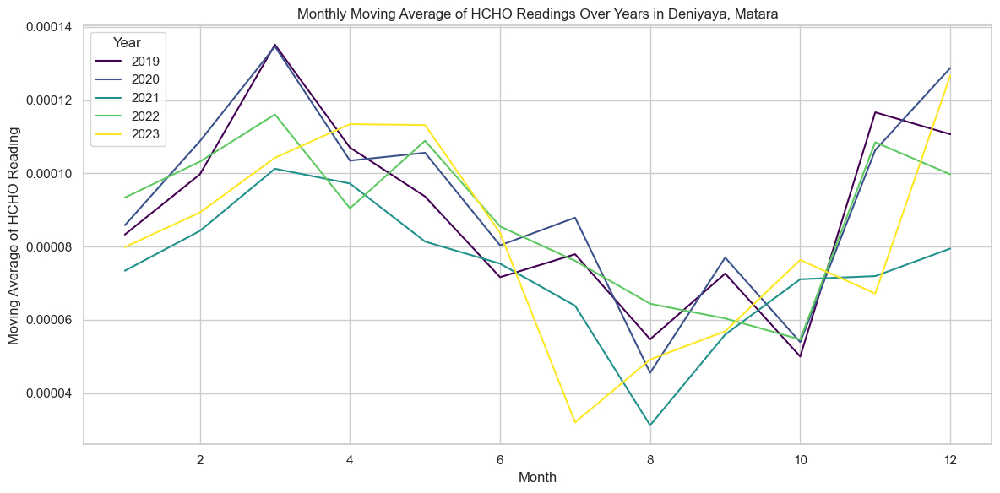

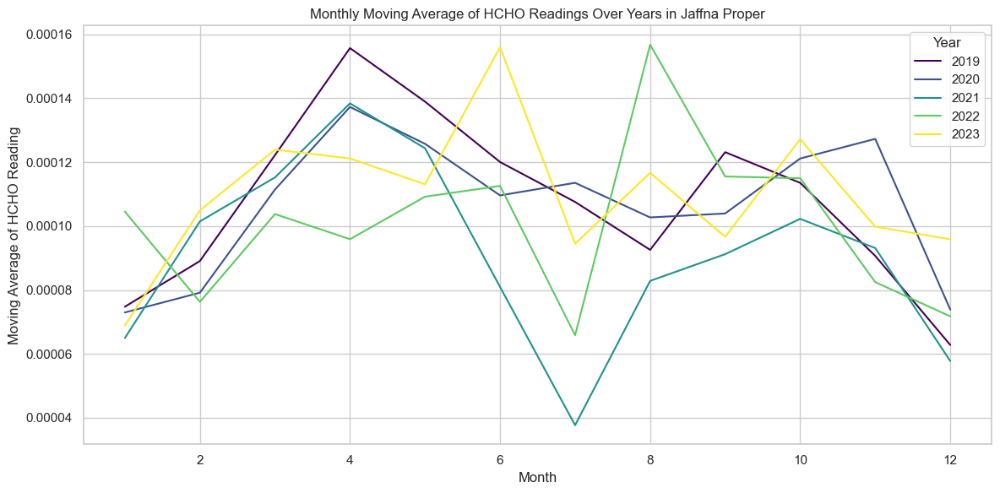

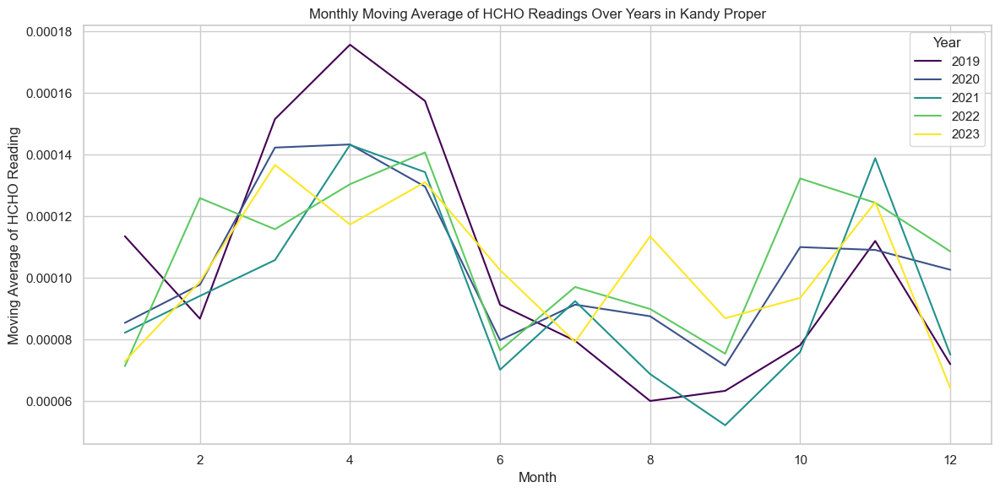

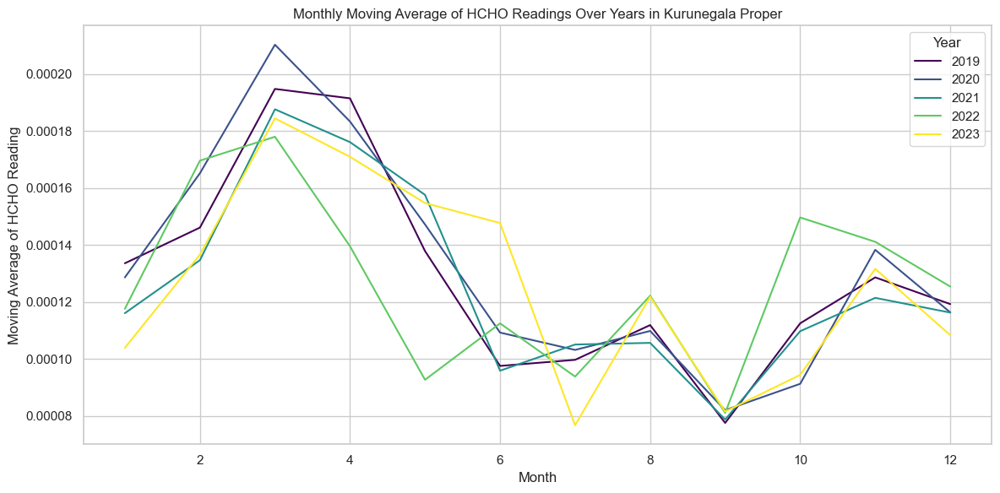

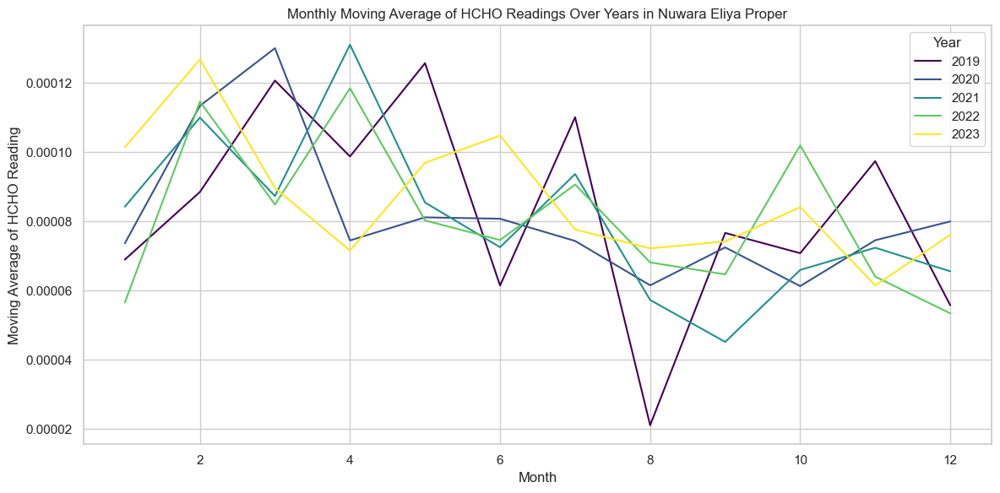

In [18]:
def visualize_location(location):
    location_data = merged_df[merged_df['Location'] == location].copy()

    # Convert 'Current_Date' to datetime format if not already done
    location_data['Current_Date'] = pd.to_datetime(location_data['Current_Date'])

    # Extract year from 'Current_Date'
    location_data['Year'] = location_data['Current_Date'].dt.year

    # Calculate moving average of HCHO_reading for each year
    location_data['HCHO_reading_ma'] = location_data.groupby('Year')['HCHO_reading'].transform(lambda x: x.rolling(window=7, min_periods=1).mean())

    # Plotting
    plt.figure(figsize=(12, 6))
    sns.lineplot(data=location_data, x=location_data['Current_Date'].dt.month, y='HCHO_reading_ma', hue='Year', palette='viridis', ci=None)
    plt.title(f'Monthly Moving Average of HCHO Readings Over Years in {location}')
    plt.xlabel('Month')
    plt.ylabel('Moving Average of HCHO Reading')
    plt.legend(title='Year')
    plt.tight_layout()
    plt.show()

# Visualize each location separately
locations = merged_df['Location'].unique()
for location in locations:
    visualize_location(location)
